## Introduction

To understand Nerf, consider the following question: Can a neural network take a pixel's position in an image and predict its color?

| ![2d-train](https://i.imgur.com/DQM92vN.png) |
| :---: |

But how can we extend this to learn a 3D scene? Using the same approach would require knowing every voxel (3D pixel), which is difficult.

The authors present a simple and efficient way to learn a 3D scene using only a few images. They avoid using voxels for training, allowing the network to model the 3D scene and create new views (images) not shown during training.

Some background knowledge is needed to fully grasp this process. This example is structured to provide the necessary information before beginning the implementation.

In [1]:
# Set up the environment for Keras to use TensorFlow as the backend.
import os
os.environ["KERAS_BACKEND"] = "tensorflow"

# Import necessary libraries.
import tensorflow as tf
from keras import layers
import keras
import glob
import imageio.v2 as imageio
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

# Ensure reproducible results by setting a random seed.
tf.random.set_seed(37)

# Initialize global constants for the dataset and training configuration.
AUTO = tf.data.AUTOTUNE  # Enable automatic data optimization for better performance.
BATCH_SIZE = 5           # Set the batch size for training.
NUM_SAMPLES = 32         # Specify the number of samples for processing.
POS_ENCODE_DIMS = 16     # Set dimensions for positional encoding (if applicable).
EPOCHS = 200              # Define the number of training epochs.

## Download and Load the Data

The `.npz` data file contains images, camera poses, and focal length information. These images are captured from different camera angles

| ![camera-angles](https://i.imgur.com/FLsi2is.png) |
| :---: |
[Source: NeRF](https://arxiv.org/abs/2003.08934) |


To understand camera poses, think of a camera as a mapping between the 3D world and a 2D image.


Consider the following equation:

<img src="https://i.imgur.com/TQHKx5v.pngg" width="100" height="50"/>

The following equation illustrates this concept:

Here, x is a 2D image point, X is a 3D world point, and P is the camera matrix. P is a 3 x 4 matrix that maps 3D objects to the image plane.

The camera matrix is an affine transformation matrix, combined with a 3 x 1 column [image height, image width, focal length] to form the pose matrix (3 x 5). The first 3 x 3 block represents the camera's view, with axes [down, right, backwards] or [-y, x, z], where the camera faces forward (-z).

<img src="https://i.imgur.com/chvJct5.png" width="300" height="100"/>


| ![camera-mapping](https://i.imgur.com/kvjqbiO.png) |
| :---: |

The COLMAP frame is defined as [right, down, forwards] or [x, -y, -z]. Learn more about COLMAP here.



12727482/12727482 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Number of images: 106
Image dimensions: 100x100


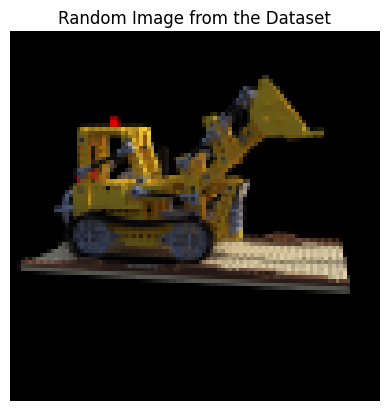

In [2]:
# Download the dataset if it does not already exist in the local directory.
url = "http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz"
data = keras.utils.get_file(origin=url)

# data = '/content/camera_params.npz'

# Load the data from the downloaded file.
data = np.load(data)
images = data["images"]
poses = data["poses"]
focal = data["focal"]

# Extract image shape details for further use.
im_shape = images.shape
num_images, H, W, _ = im_shape

# Print basic information about the dataset (optional, for debugging).
print(f"Number of images: {num_images}")
print(f"Image dimensions: {H}x{W}")

# Plot a random image from the dataset for visualization.
plt.imshow(images[np.random.randint(low=0, high=num_images)])
plt.title("Random Image from the Dataset")
plt.axis("off")  # Hide axes for better visualization.
plt.show()


In [3]:
# Function to encode positions with Fourier features.
def encode_position(x):
    """Encodes the position into its corresponding Fourier feature.

    Args:
        x: The input coordinate.

    Returns:
        Fourier features tensors of the position.
    """
    positions = [x]
    for i in range(POS_ENCODE_DIMS):
        for fn in [tf.sin, tf.cos]:
            positions.append(fn(2.0**i * x))
    return tf.concat(positions, axis=-1)

In [4]:
# Function to compute the origin and direction of rays.
def get_rays(height, width, focal, pose):
    """Computes origin point and direction vector of rays.

    Args:
        height: Height of the image.
        width: Width of the image.
        focal: The focal length between the images and the camera.
        pose: The pose matrix of the camera.

    Returns:
        Tuple of origin point and direction vector for rays.
    """
    # Build a meshgrid for the rays.
    i, j = tf.meshgrid(
        tf.range(width, dtype=tf.float32),
        tf.range(height, dtype=tf.float32),
        indexing="xy",
    )

    # Normalize the x axis coordinates.
    transformed_i = (i - width * 0.5) / focal

    # Normalize the y axis coordinates.
    transformed_j = (j - height * 0.5) / focal

    # Create the direction unit vectors.
    directions = tf.stack([transformed_i, -transformed_j, -tf.ones_like(i)], axis=-1)

    # Get the camera matrix.
    camera_matrix = pose[:3, :3]
    height_width_focal = pose[:3, -1]

    # Get origins and directions for the rays.
    transformed_dirs = directions[..., None, :]
    camera_dirs = transformed_dirs * camera_matrix
    ray_directions = tf.reduce_sum(camera_dirs, axis=-1)
    ray_origins = tf.broadcast_to(height_width_focal, tf.shape(ray_directions))

    # Return the origins and directions.
    return (ray_origins, ray_directions)


In [5]:
# Function to render and flatten rays.
def render_flat_rays(ray_origins, ray_directions, near, far, num_samples, rand=False):
    """Renders the rays and flattens it.

    Args:
        ray_origins: The origin points for rays.
        ray_directions: The direction unit vectors for the rays.
        near: The near bound of the volumetric scene.
        far: The far bound of the volumetric scene.
        num_samples: Number of sample points in a ray.
        rand: Choice for randomising the sampling strategy.

    Returns:
       Tuple of flattened rays and sample points on each rays.
    """
    # Compute 3D query points.
    # Equation: r(t) = o+td -> Building the "t" here.
    t_vals = tf.linspace(near, far, num_samples)
    if rand:
        # Inject uniform noise into sample space to make the sampling
        # continuous.
        shape = list(ray_origins.shape[:-1]) + [num_samples]
        noise = tf.random.uniform(shape=shape) * (far - near) / num_samples
        t_vals = t_vals + noise

    # Equation: r(t) = o + td -> Building the "r" here.
    rays = ray_origins[..., None, :] + (
        ray_directions[..., None, :] * t_vals[..., None]
    )
    rays_flat = tf.reshape(rays, [-1, 3])
    rays_flat = encode_position(rays_flat)
    return (rays_flat, t_vals)



In [6]:
# Function to map pose to rays and sample points.
def map_fn(pose):
    """Maps individual pose to flattened rays and sample points.

    Args:
        pose: The pose matrix of the camera.

    Returns:
        Tuple of flattened rays and sample points corresponding to the
        camera pose.
    """
    (ray_origins, ray_directions) = get_rays(height=H, width=W, focal=focal, pose=pose)
    (rays_flat, t_vals) = render_flat_rays(
        ray_origins=ray_origins,
        ray_directions=ray_directions,
        near=2.0,
        far=6.0,
        num_samples=NUM_SAMPLES,
        rand=True,
    )
    return (rays_flat, t_vals)


In [7]:
# Create the training split.
split_index = int(num_images * 0.8)

In [8]:
# Split the images into training and validation.
train_images = images[:split_index]
val_images = images[split_index:]

# Split the poses into training and validation.
train_poses = poses[:split_index]
val_poses = poses[split_index:]

In [9]:
# Make the training pipeline.
train_img_ds = tf.data.Dataset.from_tensor_slices(train_images)
train_pose_ds = tf.data.Dataset.from_tensor_slices(train_poses)
train_ray_ds = train_pose_ds.map(map_fn, num_parallel_calls=AUTO)
training_ds = tf.data.Dataset.zip((train_img_ds, train_ray_ds))
train_ds = (
    training_ds.shuffle(BATCH_SIZE)
    .batch(BATCH_SIZE, drop_remainder=True, num_parallel_calls=AUTO)
    .prefetch(AUTO)
)

In [10]:
# Make the validation pipeline.
val_img_ds = tf.data.Dataset.from_tensor_slices(val_images)
val_pose_ds = tf.data.Dataset.from_tensor_slices(val_poses)
val_ray_ds = val_pose_ds.map(map_fn, num_parallel_calls=AUTO)
validation_ds = tf.data.Dataset.zip((val_img_ds, val_ray_ds))
val_ds = (
    validation_ds.shuffle(BATCH_SIZE)
    .batch(BATCH_SIZE, drop_remainder=True, num_parallel_calls=AUTO)
    .prefetch(AUTO)
)

##NeRF Model
The NeRF model is a type of multi-layer perceptron (MLP) that uses ReLU as its activation function.

Key Highlights from the Paper:


*   The model enforces multiview consistency by predicting the volume density (σ)
as a function of the 3D location x. The RGB color c is predicted based on both the 3D location and the viewing direction.
*  The MLP processes the input 3D coordinate x through 8 fully connected layers, each with ReLU activations and 256 channels per layer. It outputs both the volume density (σ) and a 256-dimensional feature vector.


* This feature vector is then combined with the viewing direction and passed through an additional fully connected layer with ReLU activation and 128 channels to produce the view-dependent RGB color.

Simplified Implementation:

In this minimal implementation, we use 64 Dense units per layer instead of the 256 units specified in the original paper.

In [11]:

def get_nerf_model(num_layers, num_pos):
    """Generates the NeRF neural network.

    Args:
        num_layers: The number of MLP layers.
        num_pos: The number of dimensions of positional encoding.

    Returns:
        The `keras` model.
    """
    inputs = keras.Input(shape=(num_pos, 2 * 3 * POS_ENCODE_DIMS + 3))
    x = inputs
    for i in range(num_layers):
        x = layers.Dense(units=64, activation="relu")(x)
        if i % 4 == 0 and i > 0:
            # Inject residual connection.
            x = layers.concatenate([x, inputs], axis=-1)
    outputs = layers.Dense(units=4)(x)
    return keras.Model(inputs=inputs, outputs=outputs)

In [12]:
def render_rgb_depth(model, rays_flat, t_vals, rand=True, train=True):
    """Generates the RGB image and depth map from model prediction.

    Args:
        model: The MLP model that is trained to predict the rgb and
            volume density of the volumetric scene.
        rays_flat: The flattened rays that serve as the input to
            the NeRF model.
        t_vals: The sample points for the rays.
        rand: Choice to randomise the sampling strategy.
        train: Whether the model is in the training or testing phase.

    Returns:
        Tuple of rgb image and depth map.
    """
    # Get the predictions from the nerf model and reshape it.
    if train:
        predictions = model(rays_flat)
    else:
        predictions = model.predict(rays_flat)
    predictions = tf.reshape(predictions, shape=(BATCH_SIZE, H, W, NUM_SAMPLES, 4))

    # Slice the predictions into rgb and sigma.
    rgb = tf.sigmoid(predictions[..., :-1])
    sigma_a = tf.nn.relu(predictions[..., -1])

    # Get the distance of adjacent intervals.
    delta = t_vals[..., 1:] - t_vals[..., :-1]
    # delta shape = (num_samples)
    if rand:
        delta = tf.concat(
            [delta, tf.broadcast_to([1e10], shape=(BATCH_SIZE, H, W, 1))], axis=-1
        )
        alpha = 1.0 - tf.exp(-sigma_a * delta)
    else:
        delta = tf.concat(
            [delta, tf.broadcast_to([1e10], shape=(BATCH_SIZE, 1))], axis=-1
        )
        alpha = 1.0 - tf.exp(-sigma_a * delta[:, None, None, :])

    # Get transmittance.
    exp_term = 1.0 - alpha
    epsilon = 1e-10
    transmittance = tf.math.cumprod(exp_term + epsilon, axis=-1, exclusive=True)
    weights = alpha * transmittance
    rgb = tf.reduce_sum(weights[..., None] * rgb, axis=-2)

    if rand:
        depth_map = tf.reduce_sum(weights * t_vals, axis=-1)
    else:
        depth_map = tf.reduce_sum(weights * t_vals[:, None, None], axis=-1)
    return (rgb, depth_map)


## Training

The training step is implemented as part of a custom `keras.Model` subclass
so that we can make use of the `model.fit` functionality.

Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


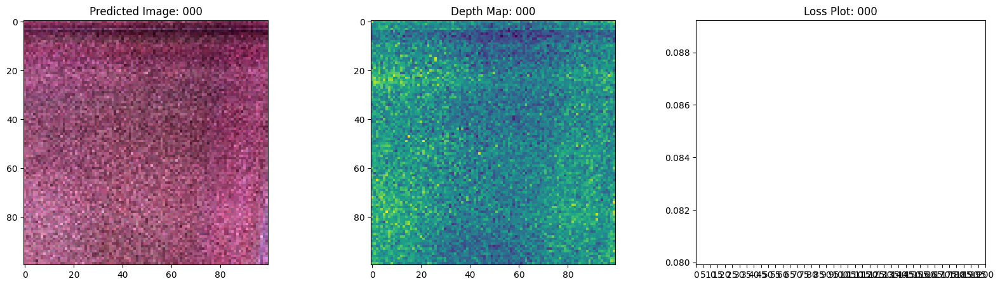

16/16 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - loss: 0.1066 - psnr: 10.0214 - val_loss: 0.0732 - val_psnr: 11.8701
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step


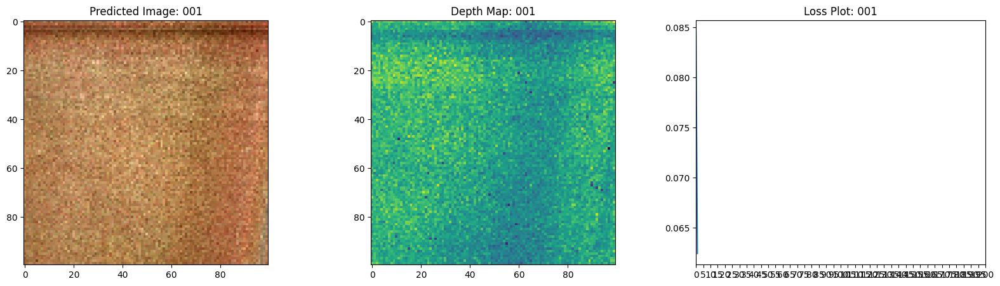

16/16 ━━━━━━━━━━━━━━━━━━━━ 74s 2s/step - loss: 0.0643 - psnr: 12.3824 - val_loss: 0.0643 - val_psnr: 12.2412
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 680ms/step


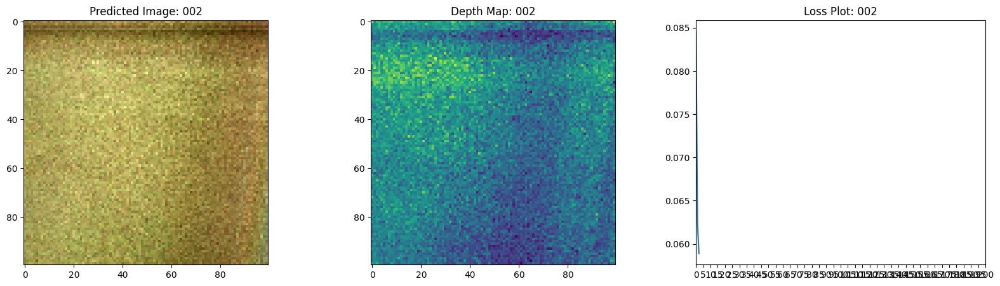

16/16 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - loss: 0.0590 - psnr: 12.6111 - val_loss: 0.0625 - val_psnr: 12.4196
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


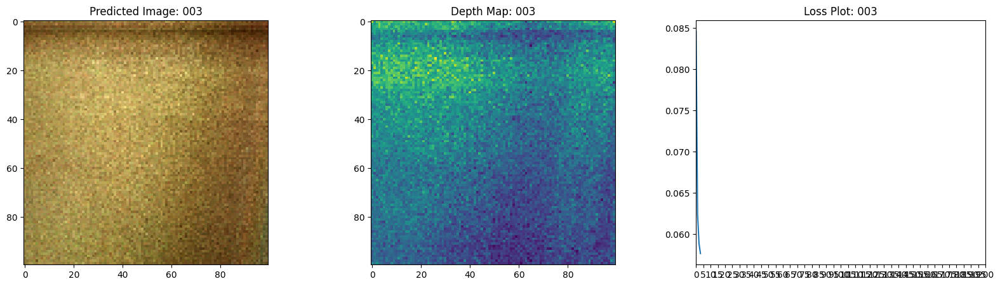

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0570 - psnr: 12.8231 - val_loss: 0.0622 - val_psnr: 12.4272
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step


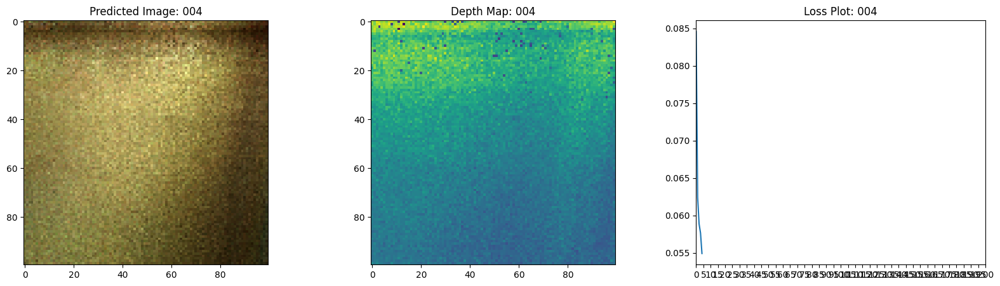

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0547 - psnr: 12.9985 - val_loss: 0.0567 - val_psnr: 12.8501
Epoch 6/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 754ms/step


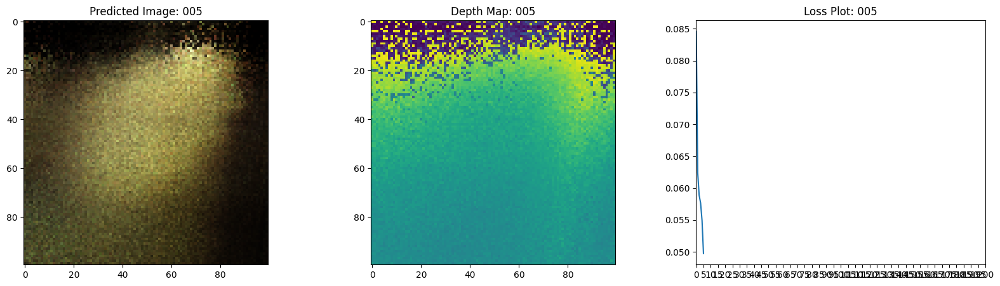

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0503 - psnr: 13.3553 - val_loss: 0.0454 - val_psnr: 13.7956
Epoch 7/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


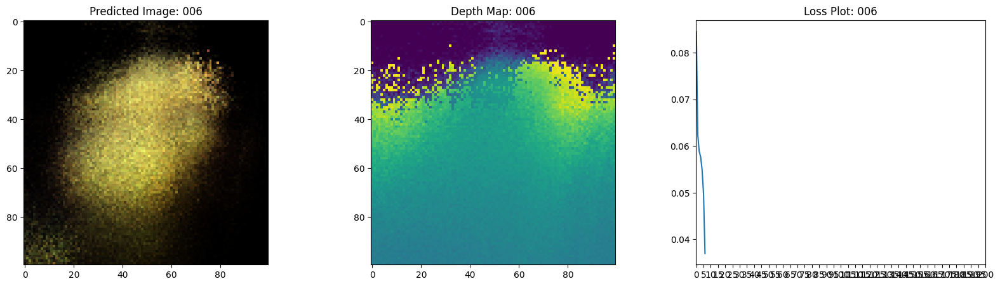

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0389 - psnr: 14.4621 - val_loss: 0.0334 - val_psnr: 14.9365
Epoch 8/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 718ms/step


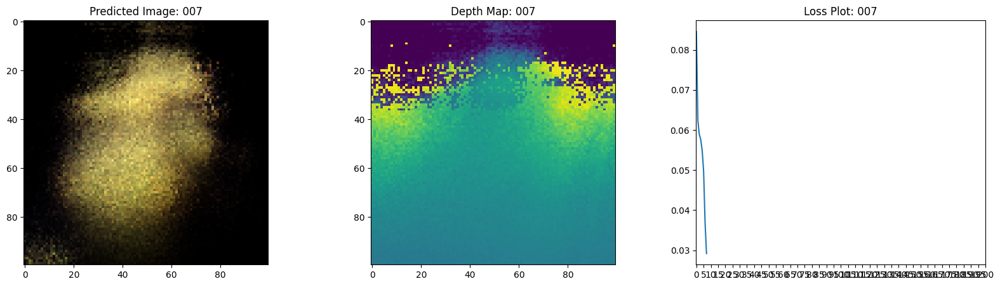

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0301 - psnr: 15.4678 - val_loss: 0.0280 - val_psnr: 15.6232
Epoch 9/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 701ms/step


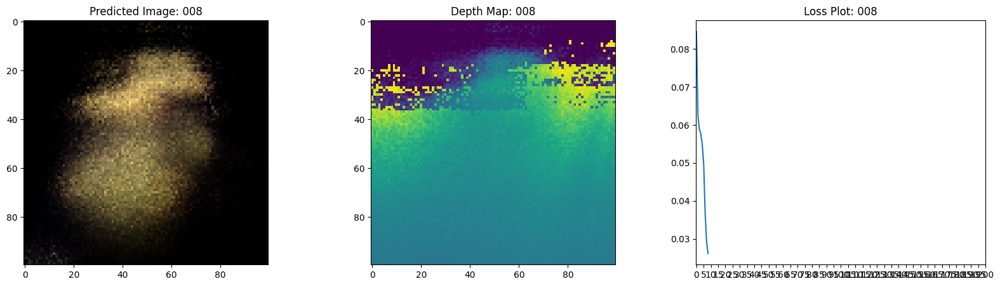

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0270 - psnr: 15.8835 - val_loss: 0.0243 - val_psnr: 16.3182
Epoch 10/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


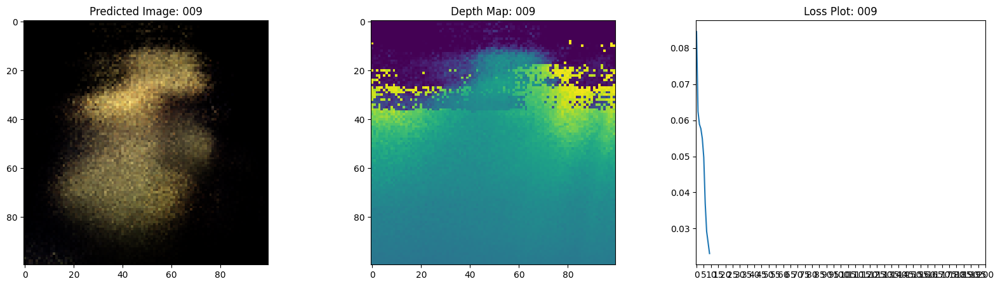

16/16 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - loss: 0.0239 - psnr: 16.4121 - val_loss: 0.0224 - val_psnr: 16.6294
Epoch 11/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


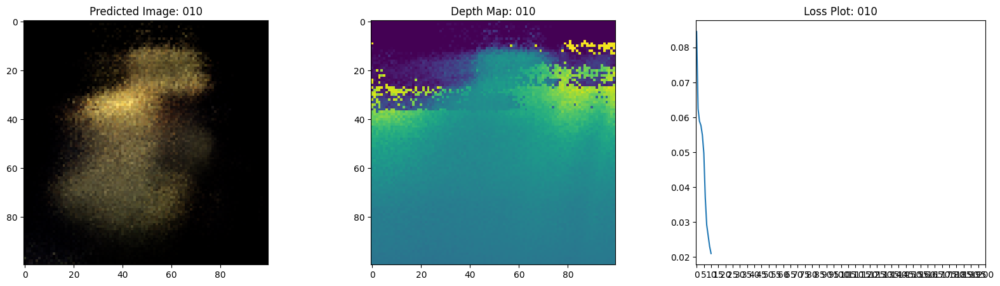

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0218 - psnr: 16.7910 - val_loss: 0.0206 - val_psnr: 16.9679
Epoch 12/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


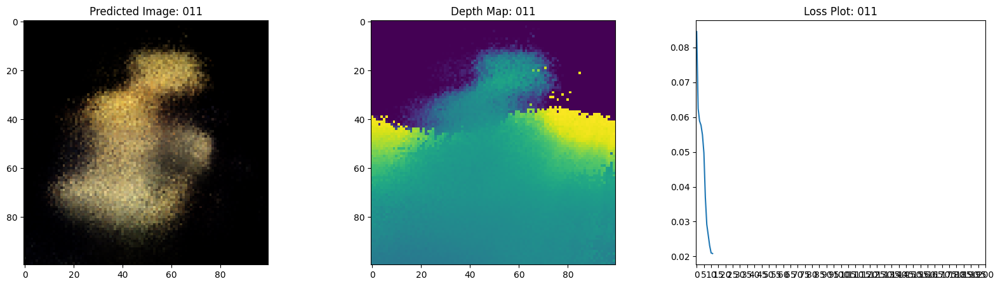

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0206 - psnr: 17.0203 - val_loss: 0.0202 - val_psnr: 17.0257
Epoch 13/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


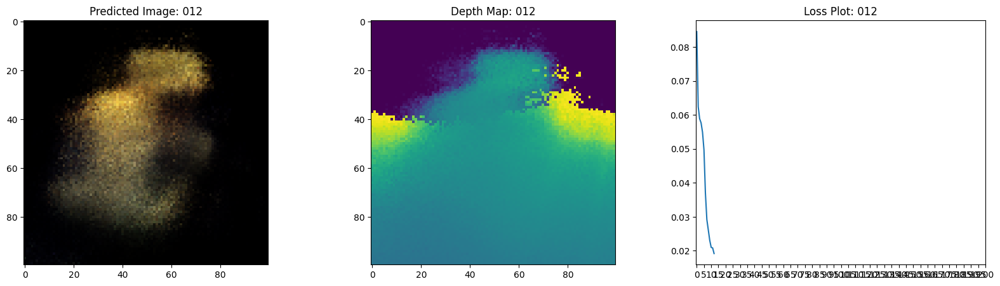

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0200 - psnr: 17.1150 - val_loss: 0.0181 - val_psnr: 17.5024
Epoch 14/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 810ms/step


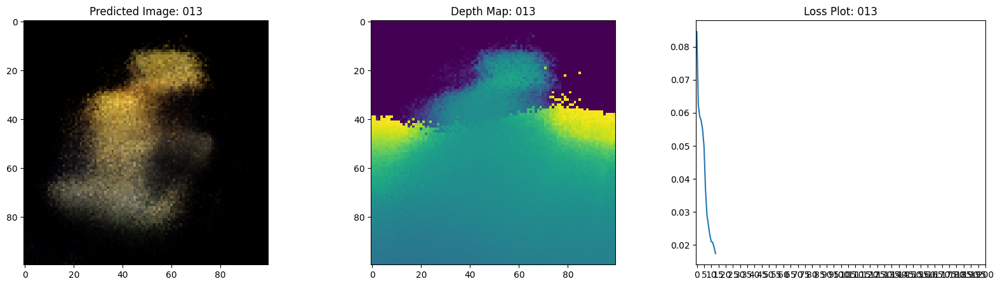

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0177 - psnr: 17.6437 - val_loss: 0.0166 - val_psnr: 17.8960
Epoch 15/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


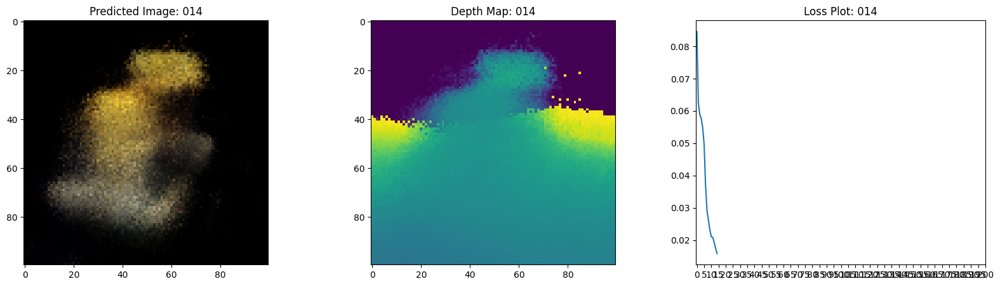

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0159 - psnr: 18.1248 - val_loss: 0.0151 - val_psnr: 18.2854
Epoch 16/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step


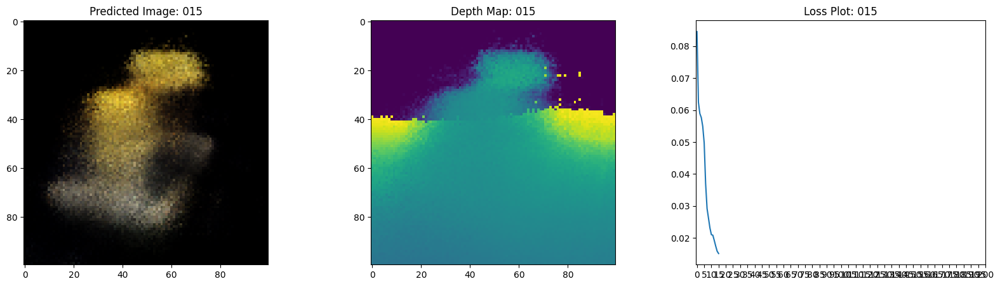

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0151 - psnr: 18.3093 - val_loss: 0.0145 - val_psnr: 18.4718
Epoch 17/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 802ms/step


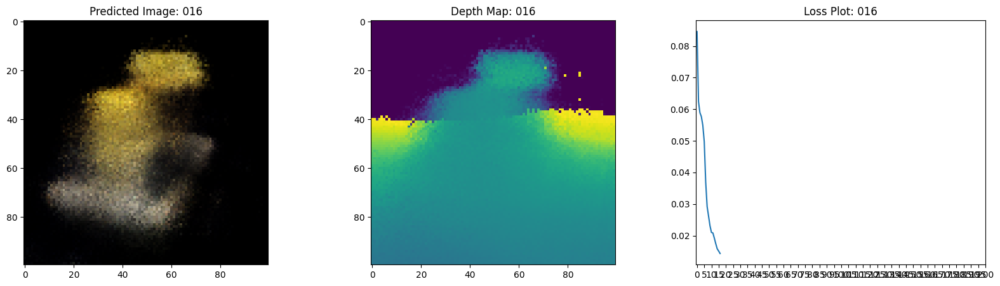

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0142 - psnr: 18.5896 - val_loss: 0.0138 - val_psnr: 18.6703
Epoch 18/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step


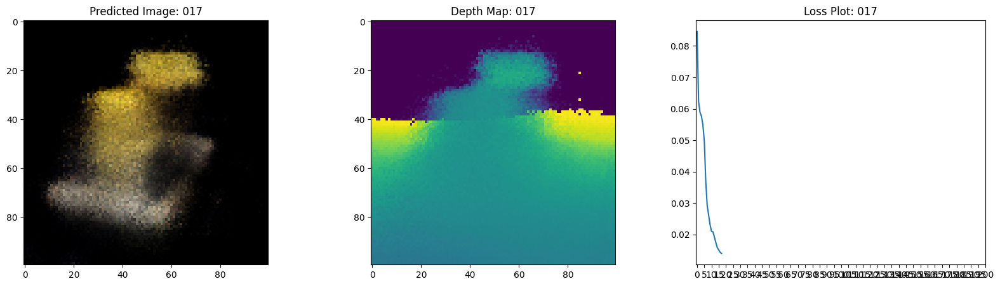

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0139 - psnr: 18.6825 - val_loss: 0.0135 - val_psnr: 18.7935
Epoch 19/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


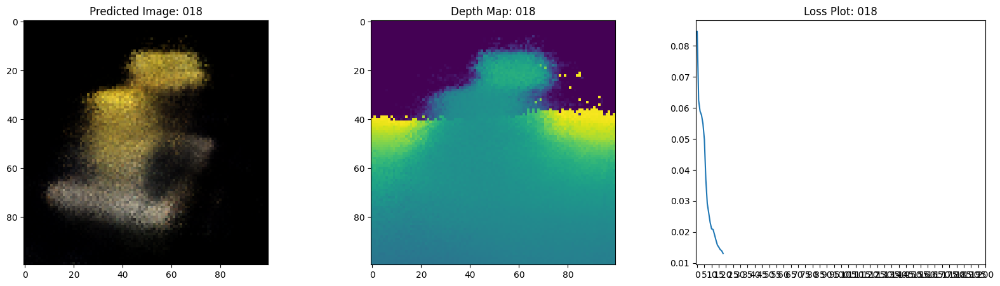

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0128 - psnr: 19.0383 - val_loss: 0.0132 - val_psnr: 18.8933
Epoch 20/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 684ms/step


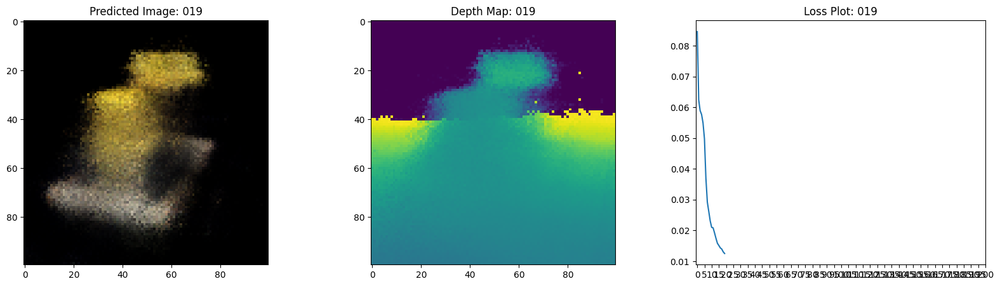

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0125 - psnr: 19.1369 - val_loss: 0.0125 - val_psnr: 19.1387
Epoch 21/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


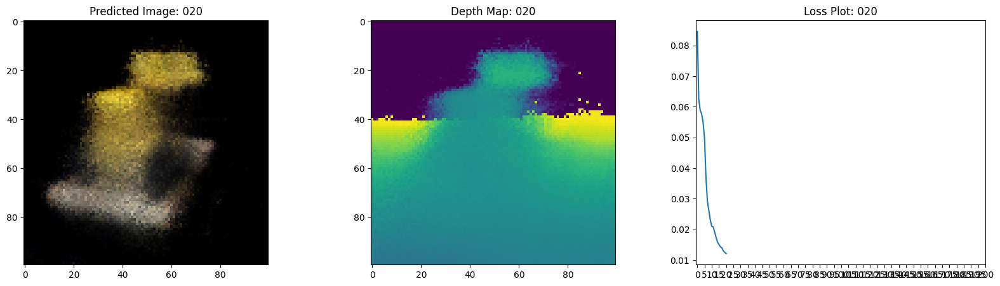

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0118 - psnr: 19.3912 - val_loss: 0.0122 - val_psnr: 19.2340
Epoch 22/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


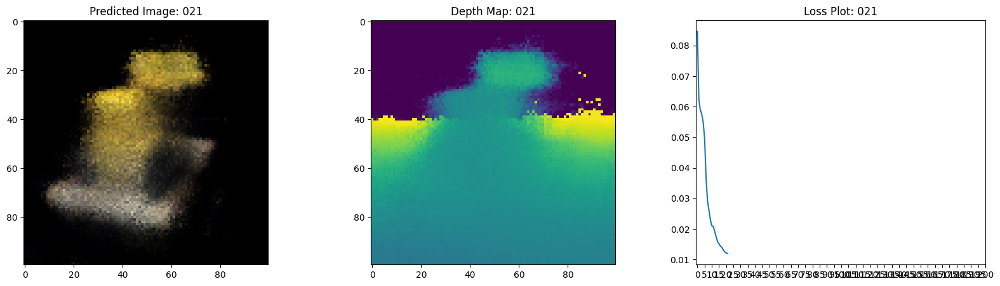

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0119 - psnr: 19.3623 - val_loss: 0.0119 - val_psnr: 19.3386
Epoch 23/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 692ms/step


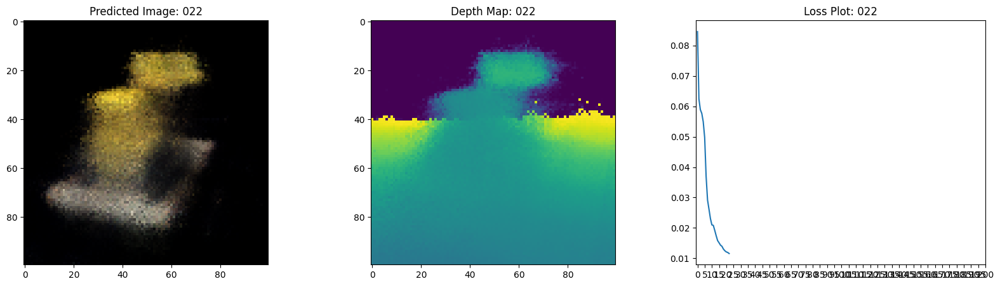

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0118 - psnr: 19.3780 - val_loss: 0.0115 - val_psnr: 19.5204
Epoch 24/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step


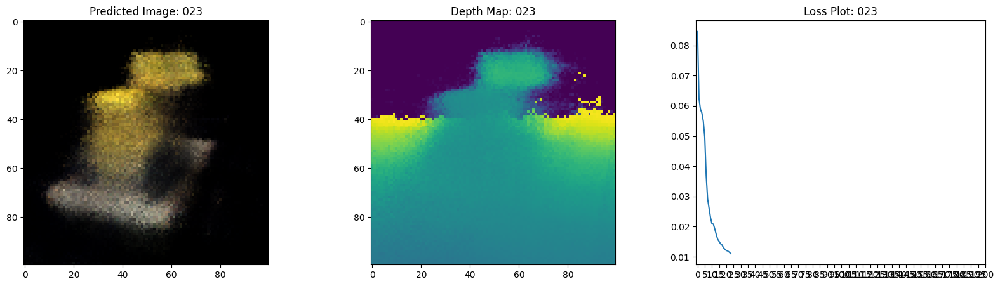

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0110 - psnr: 19.7212 - val_loss: 0.0116 - val_psnr: 19.4393
Epoch 25/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


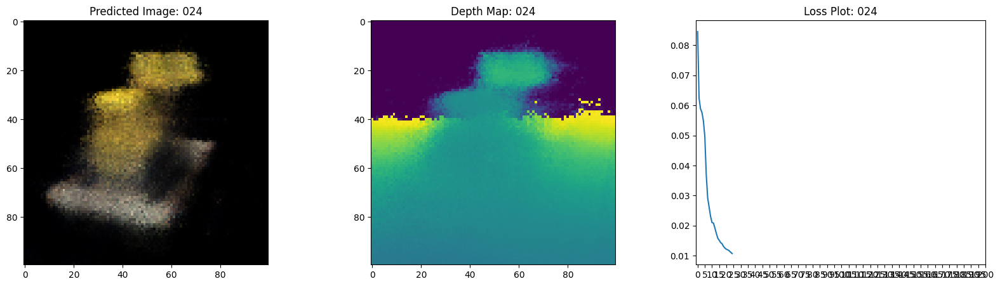

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0108 - psnr: 19.8064 - val_loss: 0.0110 - val_psnr: 19.7171
Epoch 26/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step


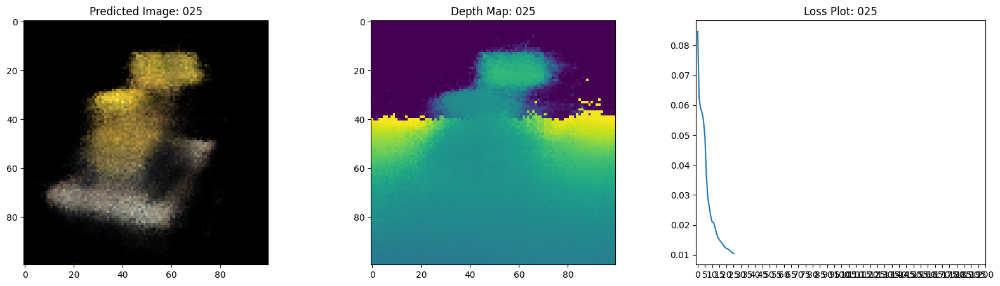

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0104 - psnr: 19.9505 - val_loss: 0.0112 - val_psnr: 19.5946
Epoch 27/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step


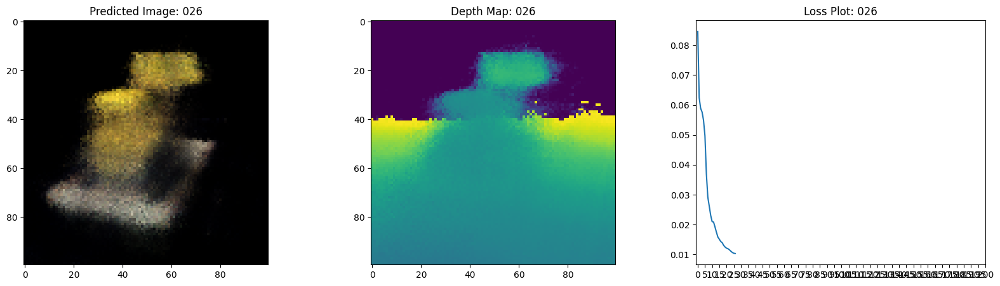

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0103 - psnr: 19.9871 - val_loss: 0.0106 - val_psnr: 19.8929
Epoch 28/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


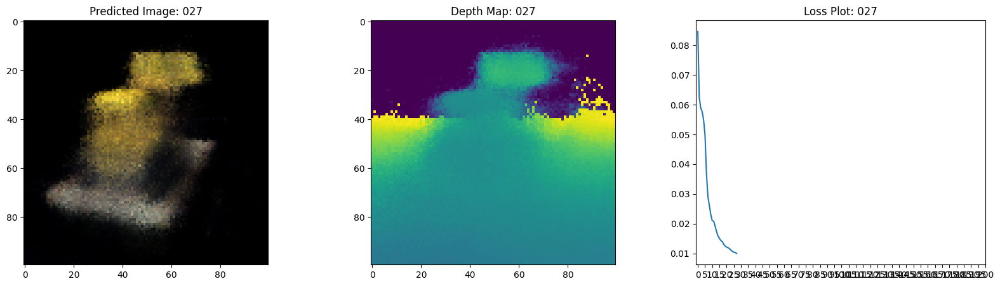

16/16 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - loss: 0.0099 - psnr: 20.1632 - val_loss: 0.0101 - val_psnr: 20.0724
Epoch 29/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step


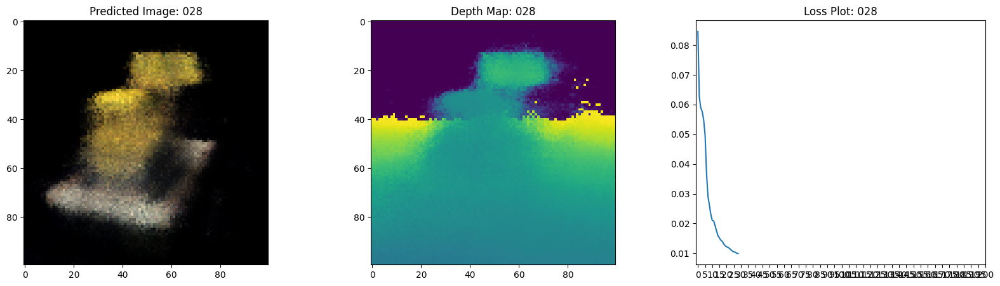

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0098 - psnr: 20.2367 - val_loss: 0.0102 - val_psnr: 19.9769
Epoch 30/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


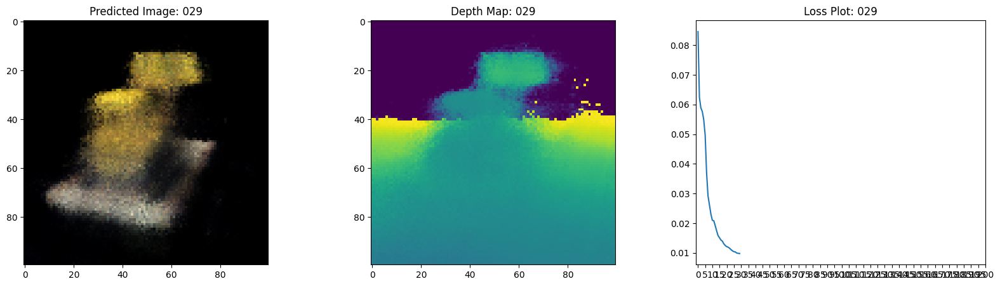

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0099 - psnr: 20.1625 - val_loss: 0.0102 - val_psnr: 20.0088
Epoch 31/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 722ms/step


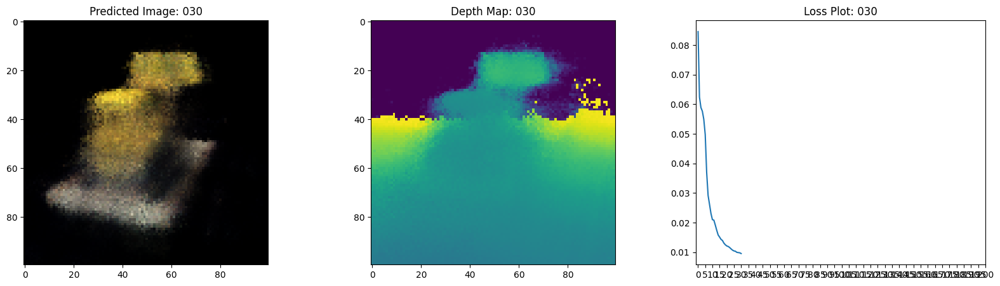

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0096 - psnr: 20.3015 - val_loss: 0.0097 - val_psnr: 20.2531
Epoch 32/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 684ms/step


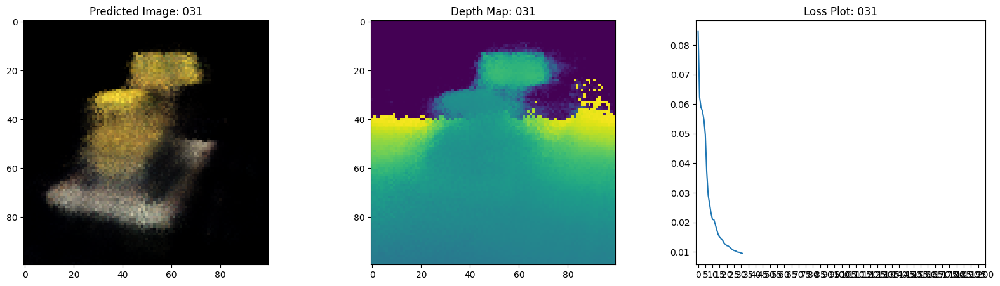

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0095 - psnr: 20.3297 - val_loss: 0.0100 - val_psnr: 20.0534
Epoch 33/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 829ms/step


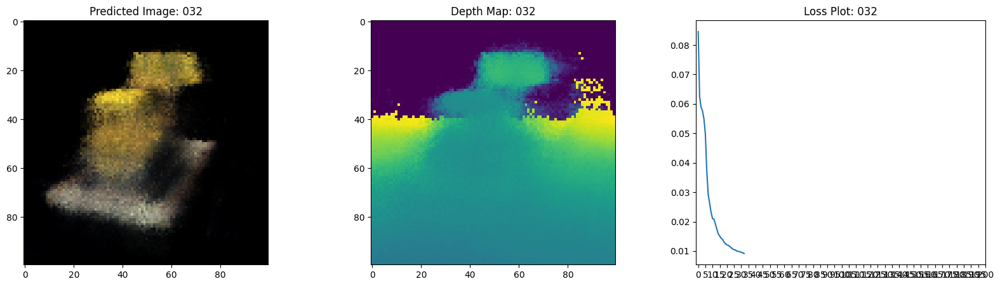

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0093 - psnr: 20.4319 - val_loss: 0.0095 - val_psnr: 20.2900
Epoch 34/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


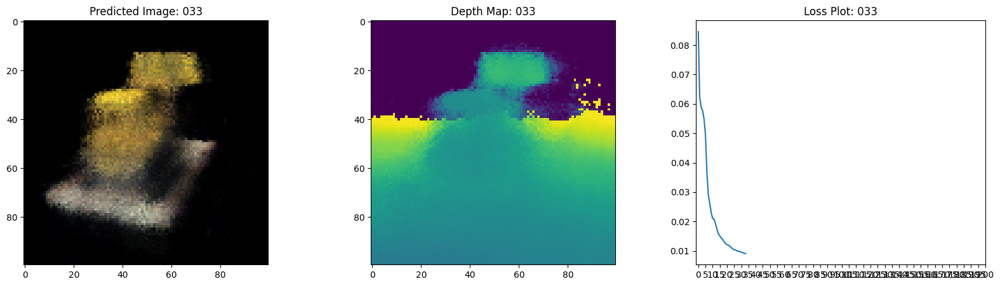

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0092 - psnr: 20.5172 - val_loss: 0.0096 - val_psnr: 20.2406
Epoch 35/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 751ms/step


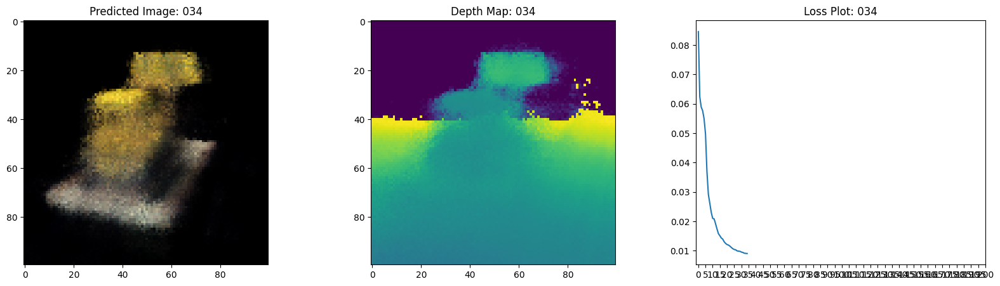

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0092 - psnr: 20.4749 - val_loss: 0.0094 - val_psnr: 20.3561
Epoch 36/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 809ms/step


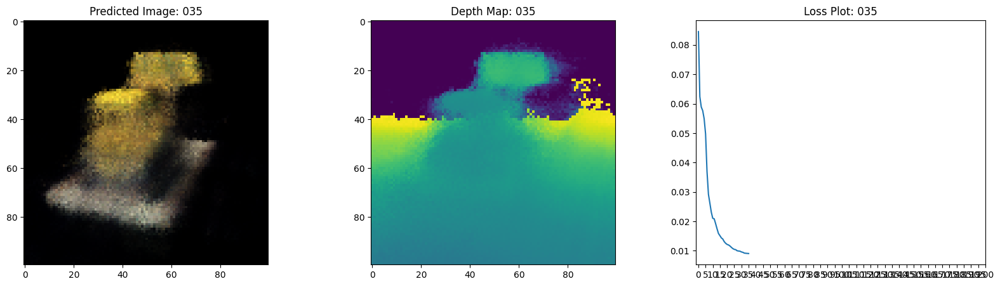

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0090 - psnr: 20.5944 - val_loss: 0.0093 - val_psnr: 20.4136
Epoch 37/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


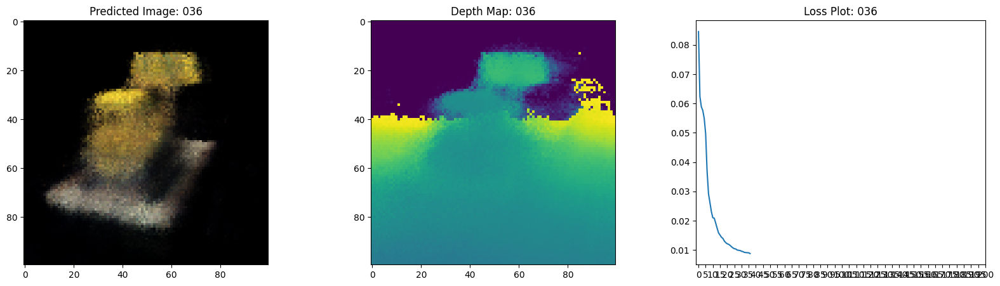

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0089 - psnr: 20.6598 - val_loss: 0.0091 - val_psnr: 20.5361
Epoch 38/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


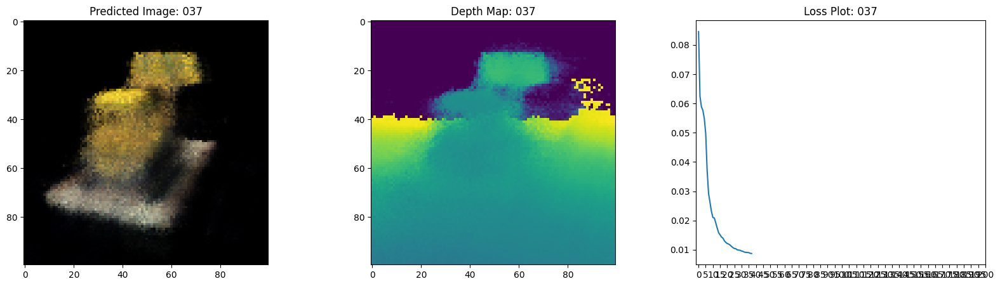

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0086 - psnr: 20.7834 - val_loss: 0.0094 - val_psnr: 20.3214
Epoch 39/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


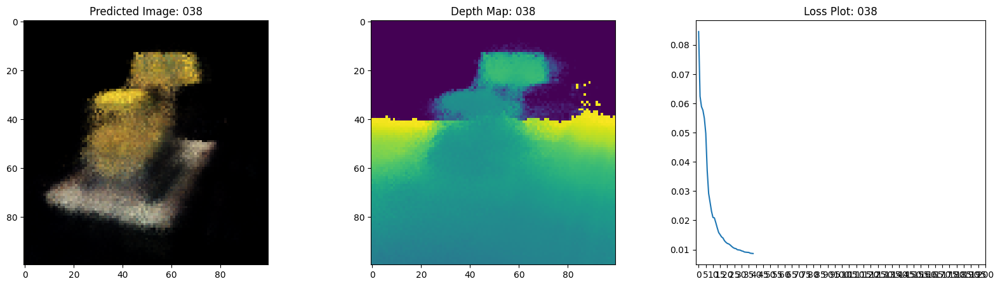

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0087 - psnr: 20.7049 - val_loss: 0.0092 - val_psnr: 20.4547
Epoch 40/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step


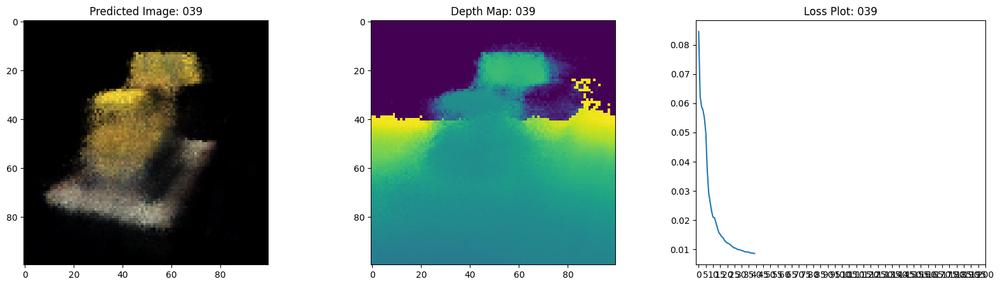

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0085 - psnr: 20.8301 - val_loss: 0.0091 - val_psnr: 20.4685
Epoch 41/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 817ms/step


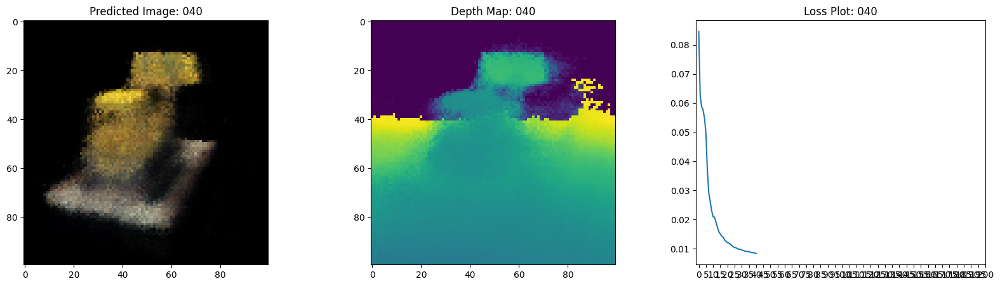

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0084 - psnr: 20.8686 - val_loss: 0.0091 - val_psnr: 20.5167
Epoch 42/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step


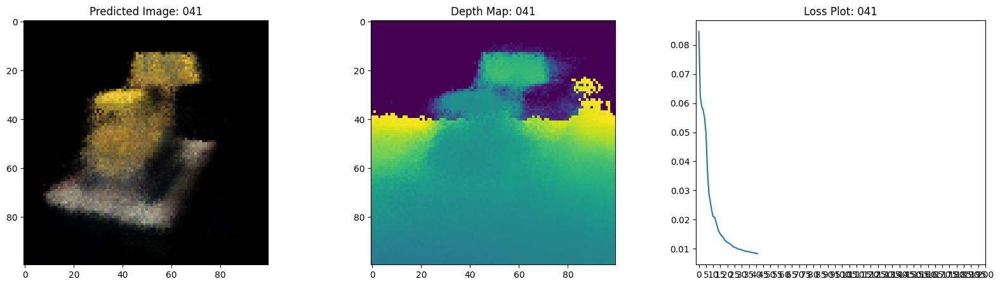

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0084 - psnr: 20.8971 - val_loss: 0.0089 - val_psnr: 20.6486
Epoch 43/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step


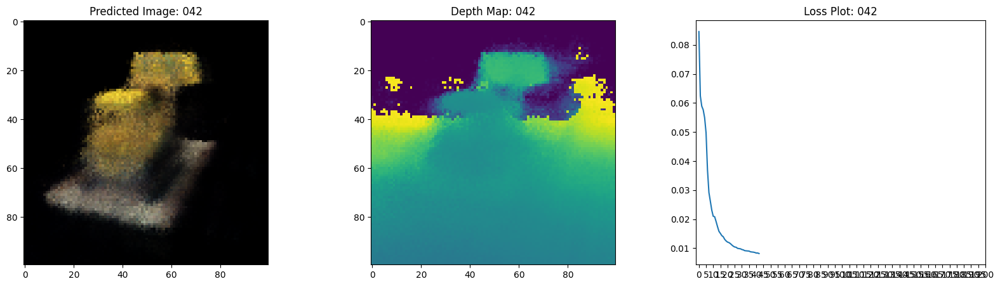

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0080 - psnr: 21.0853 - val_loss: 0.0089 - val_psnr: 20.6079
Epoch 44/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step


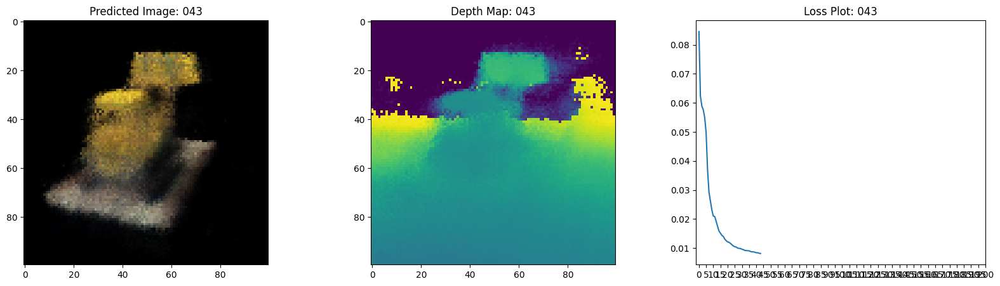

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0081 - psnr: 21.0680 - val_loss: 0.0085 - val_psnr: 20.8600
Epoch 45/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 688ms/step


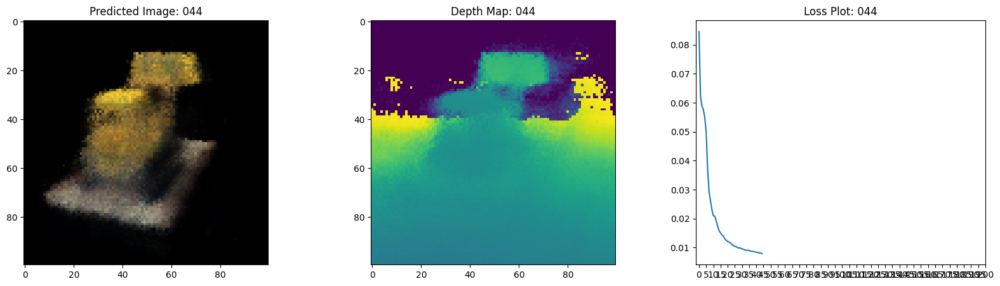

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0080 - psnr: 21.1296 - val_loss: 0.0087 - val_psnr: 20.6965
Epoch 46/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step


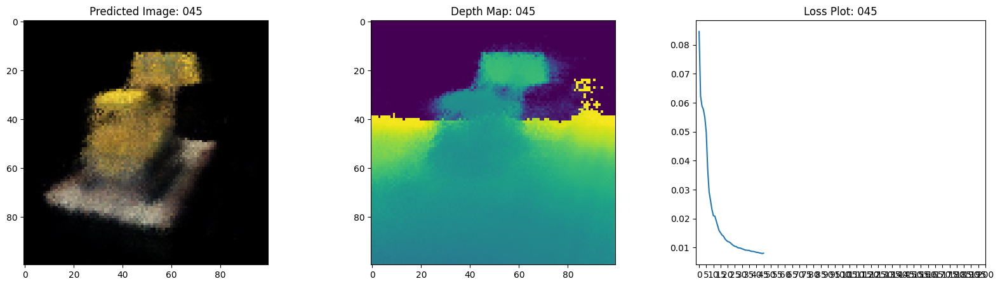

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0080 - psnr: 21.1180 - val_loss: 0.0085 - val_psnr: 20.8030
Epoch 47/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


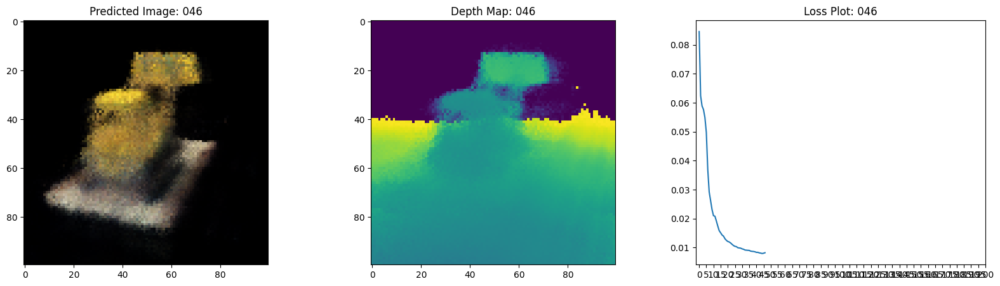

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0082 - psnr: 20.9763 - val_loss: 0.0088 - val_psnr: 20.6105
Epoch 48/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step


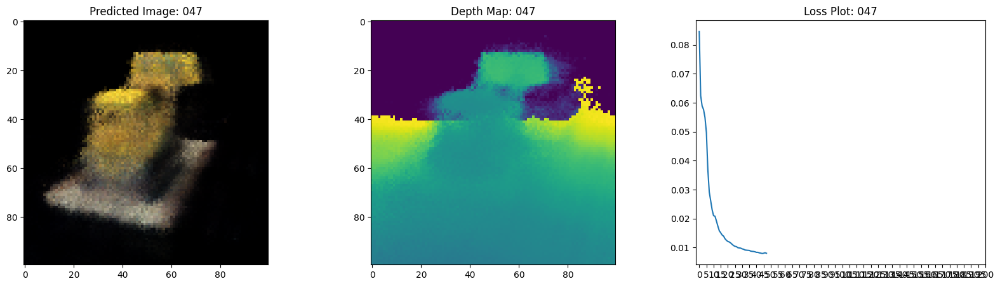

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0081 - psnr: 21.0502 - val_loss: 0.0084 - val_psnr: 20.8347
Epoch 49/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


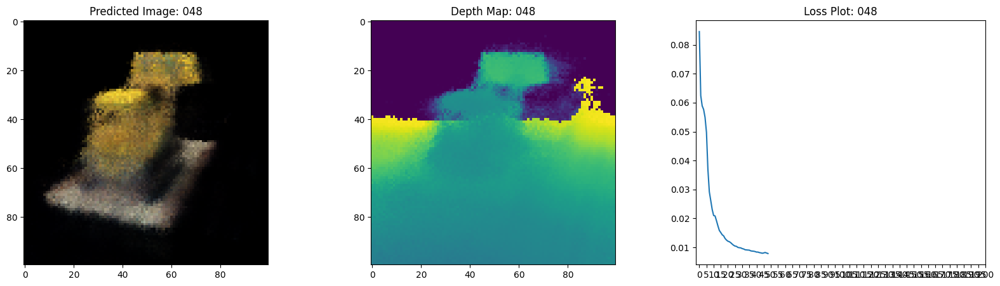

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0080 - psnr: 21.0598 - val_loss: 0.0083 - val_psnr: 20.8645
Epoch 50/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 814ms/step


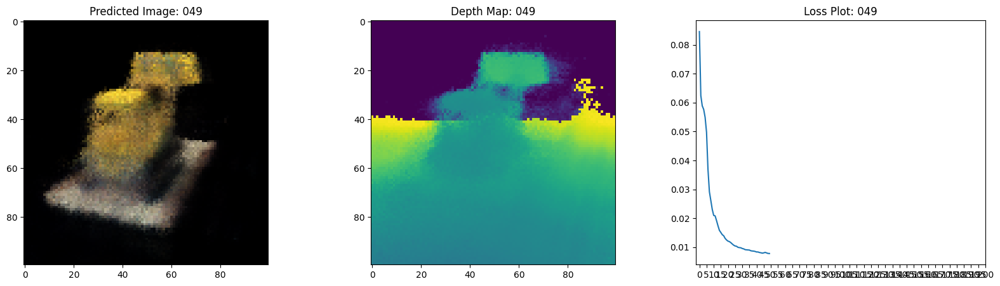

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0078 - psnr: 21.2023 - val_loss: 0.0086 - val_psnr: 20.7391
Epoch 51/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step


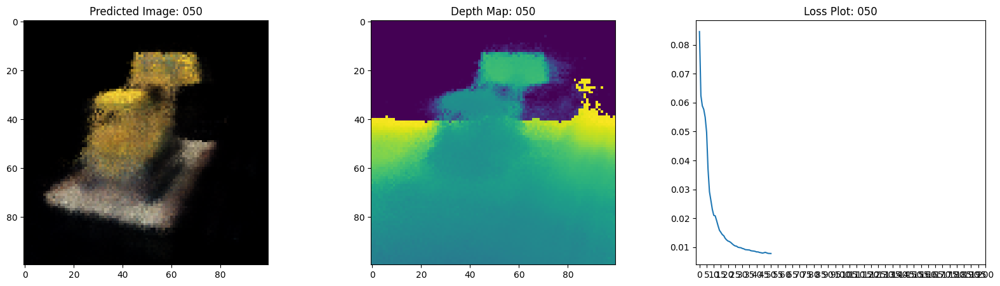

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0078 - psnr: 21.1866 - val_loss: 0.0084 - val_psnr: 20.8794
Epoch 52/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


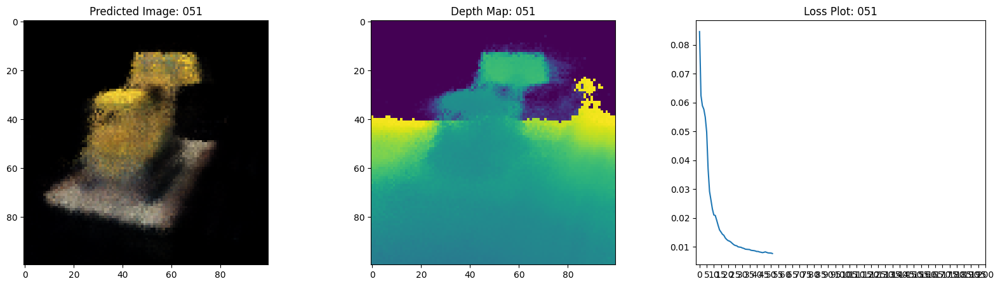

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0078 - psnr: 21.2059 - val_loss: 0.0084 - val_psnr: 20.8219
Epoch 53/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


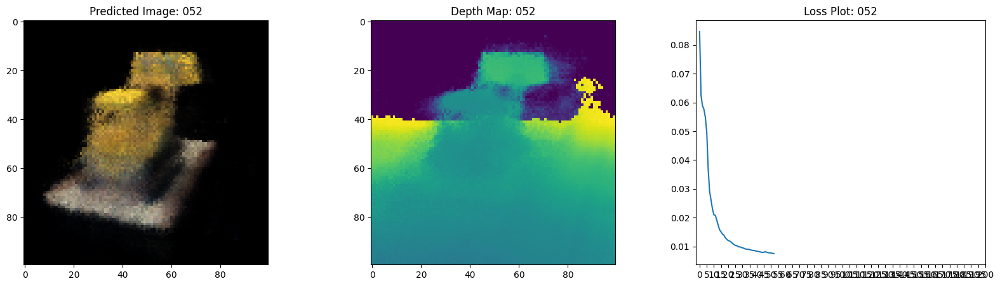

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0076 - psnr: 21.3108 - val_loss: 0.0082 - val_psnr: 20.9929
Epoch 54/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


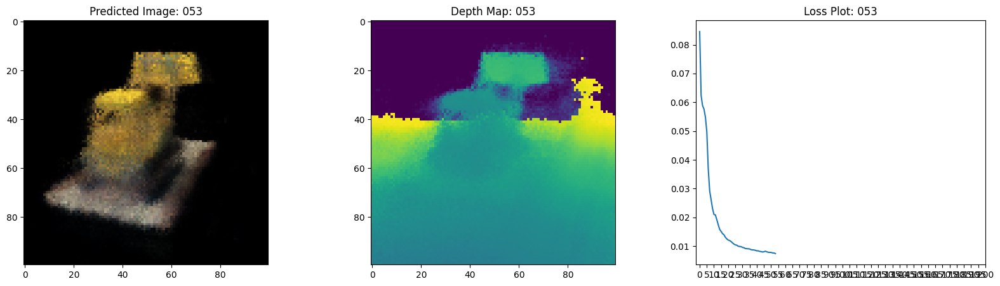

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0075 - psnr: 21.3862 - val_loss: 0.0081 - val_psnr: 21.0665
Epoch 55/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 706ms/step


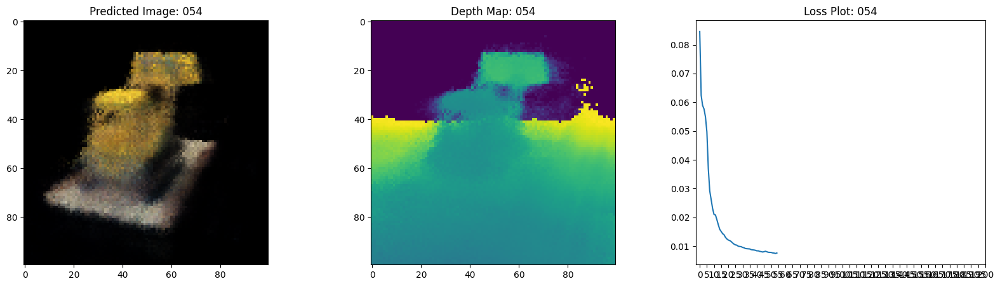

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0076 - psnr: 21.3430 - val_loss: 0.0081 - val_psnr: 21.0197
Epoch 56/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


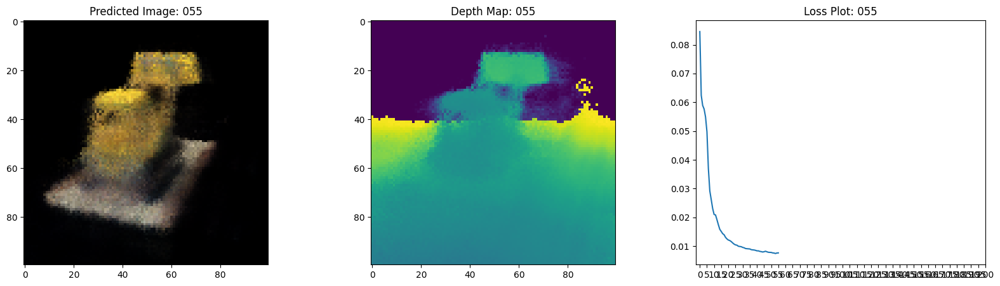

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0077 - psnr: 21.2820 - val_loss: 0.0083 - val_psnr: 20.8564
Epoch 57/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 731ms/step


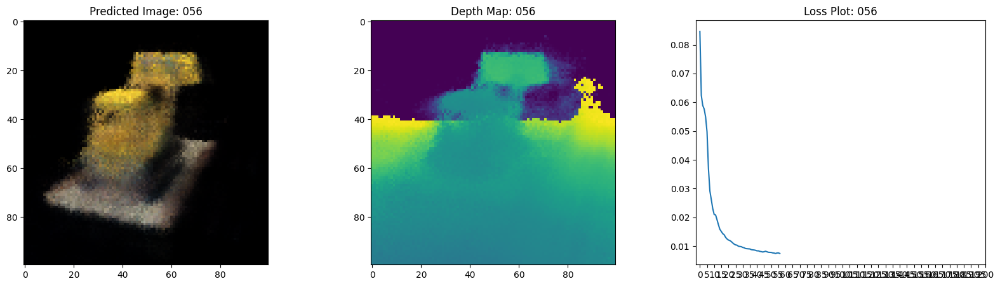

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0075 - psnr: 21.3692 - val_loss: 0.0080 - val_psnr: 21.0580
Epoch 58/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


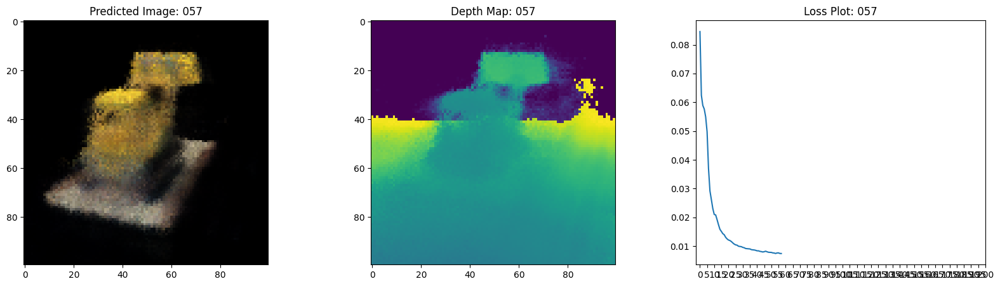

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0074 - psnr: 21.4403 - val_loss: 0.0082 - val_psnr: 20.9319
Epoch 59/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


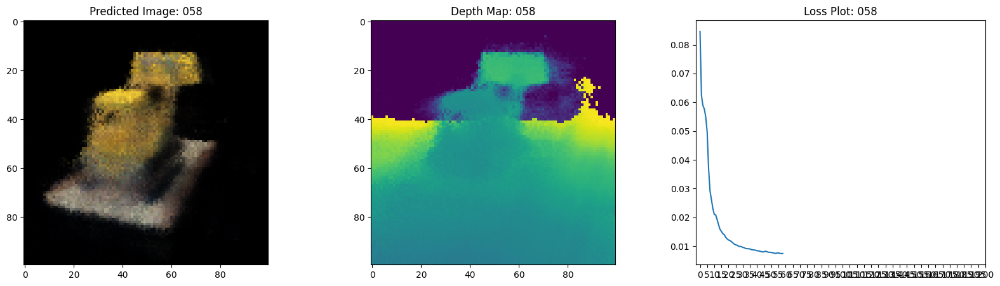

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0075 - psnr: 21.3835 - val_loss: 0.0080 - val_psnr: 21.0884
Epoch 60/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 793ms/step


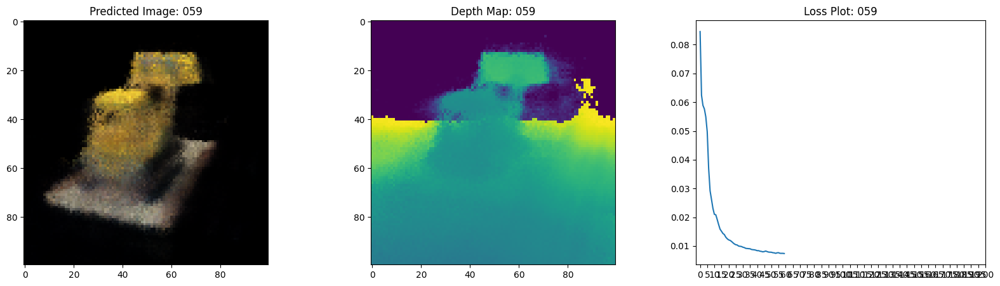

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0074 - psnr: 21.4590 - val_loss: 0.0081 - val_psnr: 21.0310
Epoch 61/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


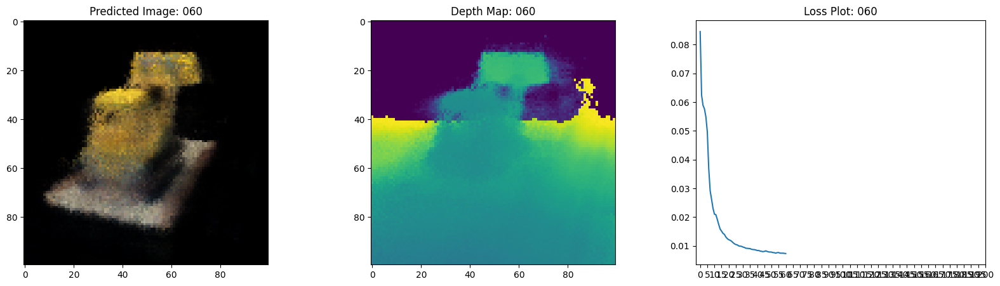

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0074 - psnr: 21.4453 - val_loss: 0.0079 - val_psnr: 21.1036
Epoch 62/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


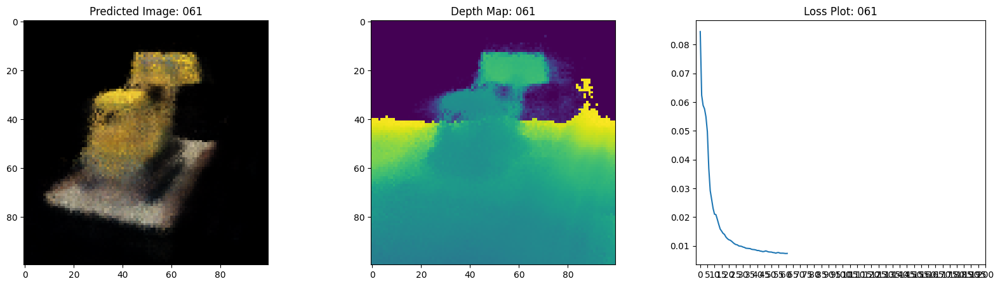

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0074 - psnr: 21.4151 - val_loss: 0.0083 - val_psnr: 20.8380
Epoch 63/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


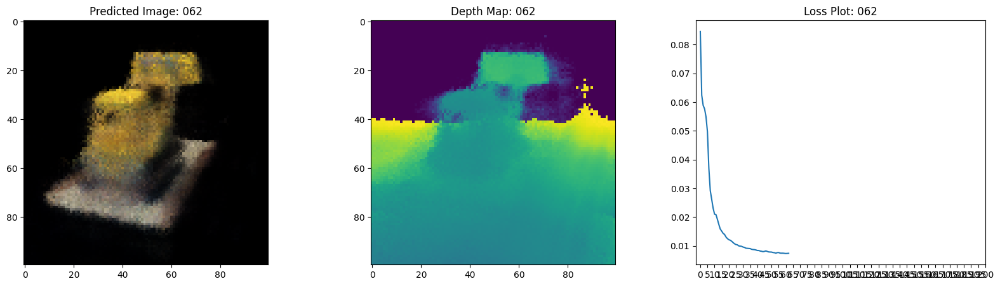

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0075 - psnr: 21.3651 - val_loss: 0.0079 - val_psnr: 21.1124
Epoch 64/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


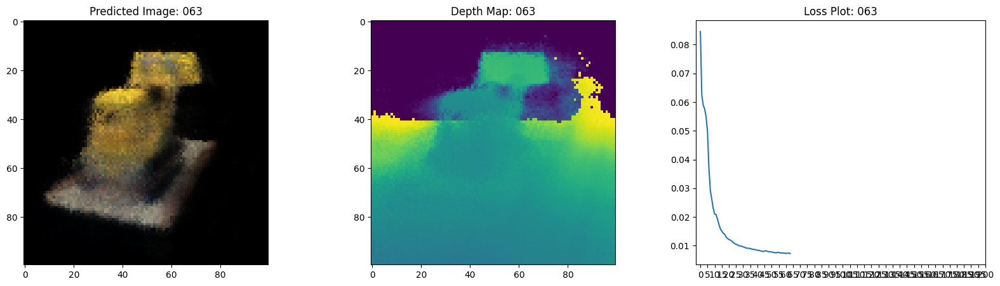

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0073 - psnr: 21.4961 - val_loss: 0.0077 - val_psnr: 21.2643
Epoch 65/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


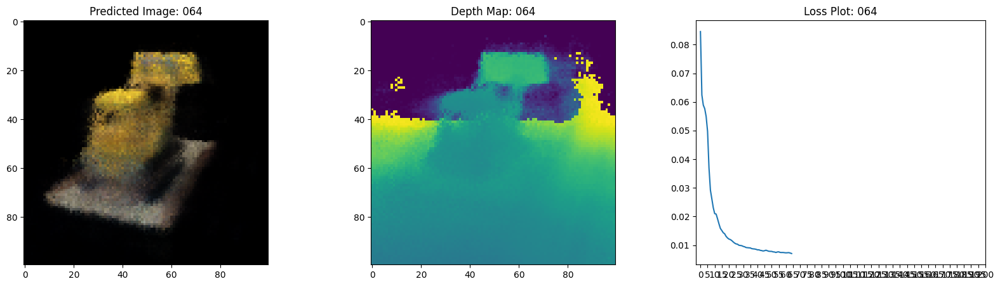

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0071 - psnr: 21.6215 - val_loss: 0.0076 - val_psnr: 21.3354
Epoch 66/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 718ms/step


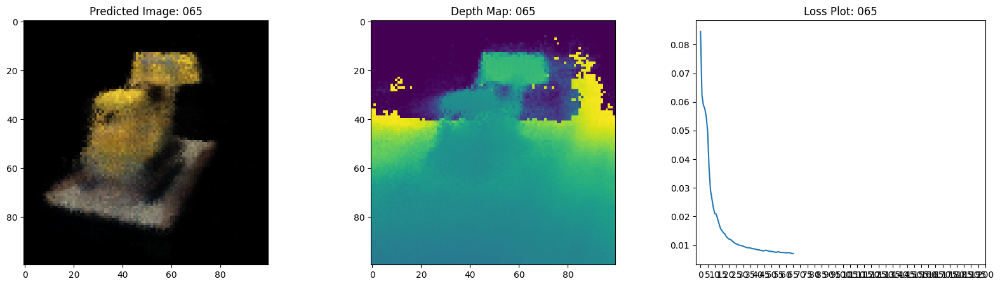

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0071 - psnr: 21.6299 - val_loss: 0.0076 - val_psnr: 21.3276
Epoch 67/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


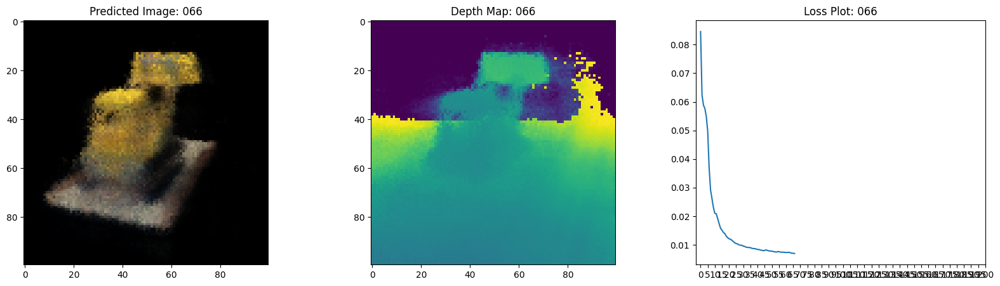

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0070 - psnr: 21.6851 - val_loss: 0.0077 - val_psnr: 21.2296
Epoch 68/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 706ms/step


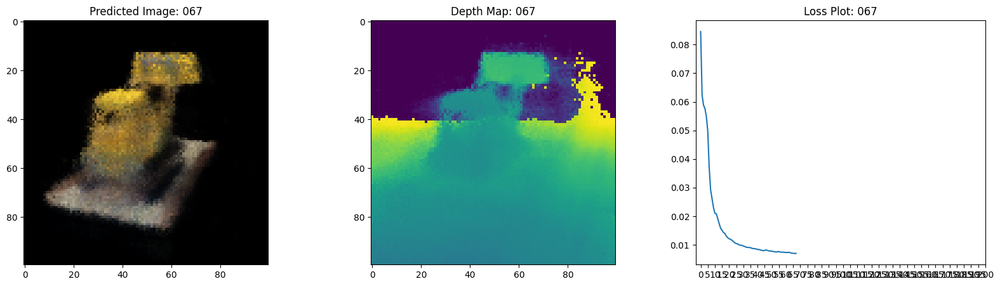

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0071 - psnr: 21.6375 - val_loss: 0.0074 - val_psnr: 21.4438
Epoch 69/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


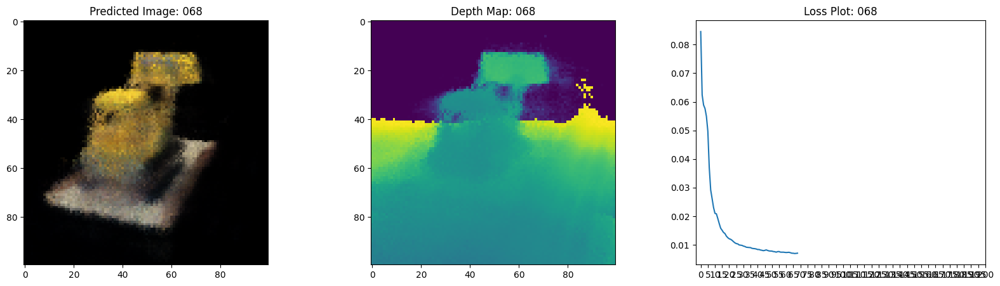

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0070 - psnr: 21.7064 - val_loss: 0.0079 - val_psnr: 21.1103
Epoch 70/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


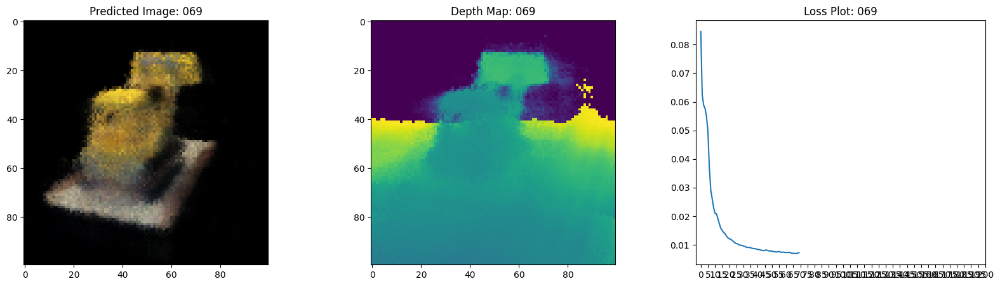

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0073 - psnr: 21.5037 - val_loss: 0.0079 - val_psnr: 21.0629
Epoch 71/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step


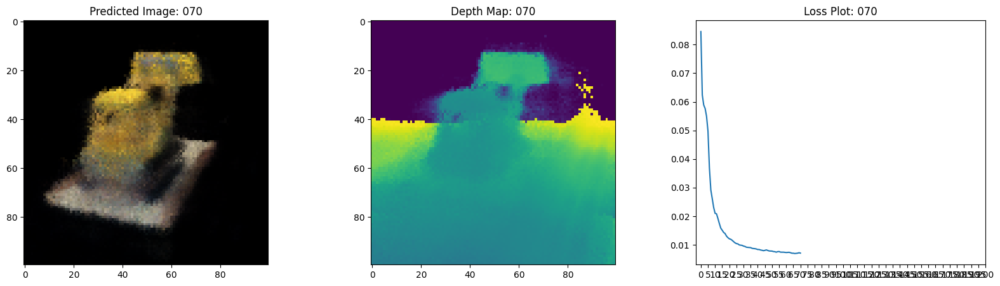

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0071 - psnr: 21.6157 - val_loss: 0.0079 - val_psnr: 21.1030
Epoch 72/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 793ms/step


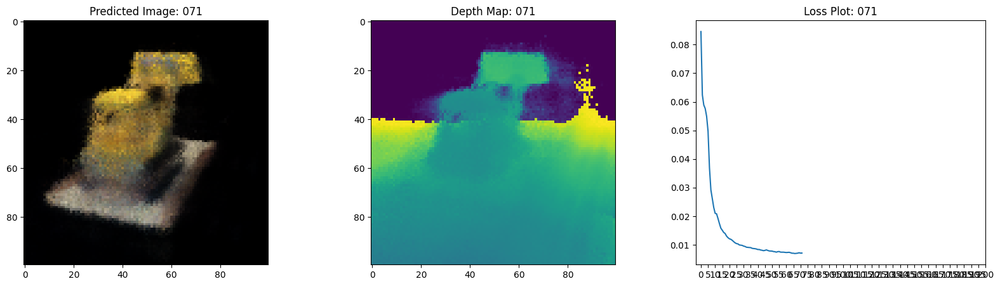

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0072 - psnr: 21.5336 - val_loss: 0.0077 - val_psnr: 21.2021
Epoch 73/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 742ms/step


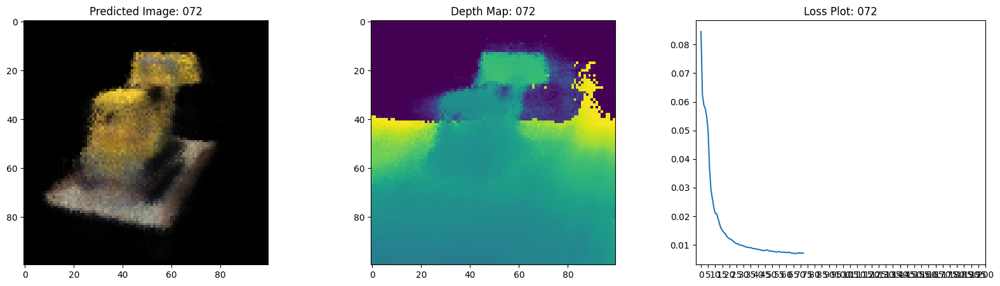

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0071 - psnr: 21.6019 - val_loss: 0.0075 - val_psnr: 21.3604
Epoch 74/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 719ms/step


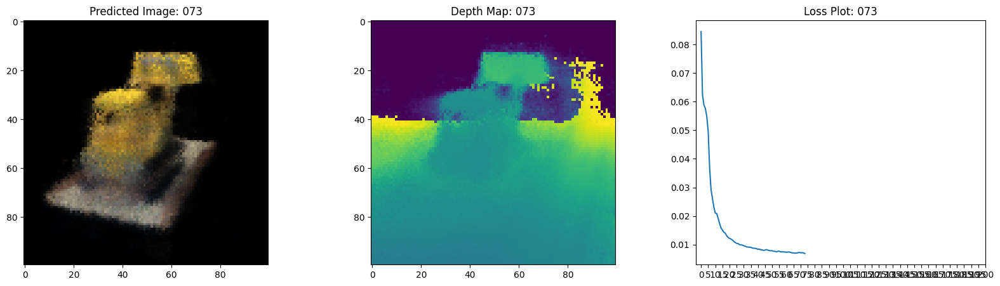

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0069 - psnr: 21.7729 - val_loss: 0.0075 - val_psnr: 21.3932
Epoch 75/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


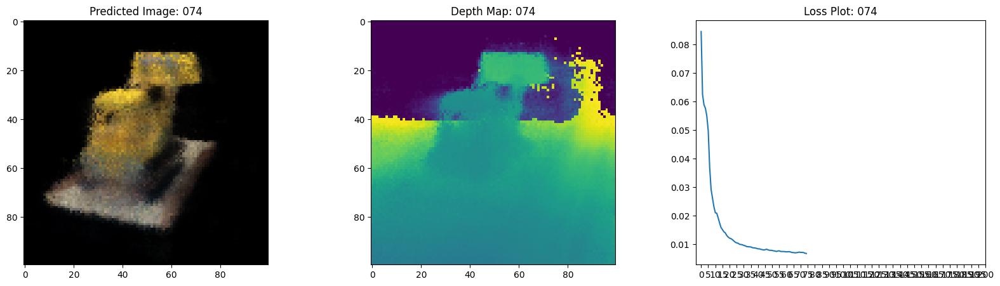

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0067 - psnr: 21.8427 - val_loss: 0.0074 - val_psnr: 21.4643
Epoch 76/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step


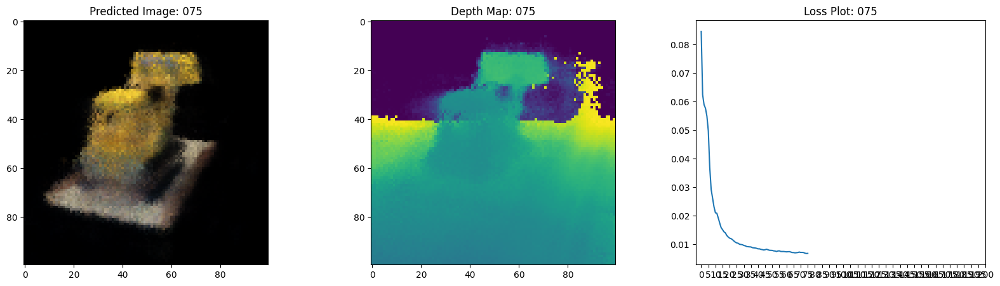

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0068 - psnr: 21.8142 - val_loss: 0.0077 - val_psnr: 21.1894
Epoch 77/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 798ms/step


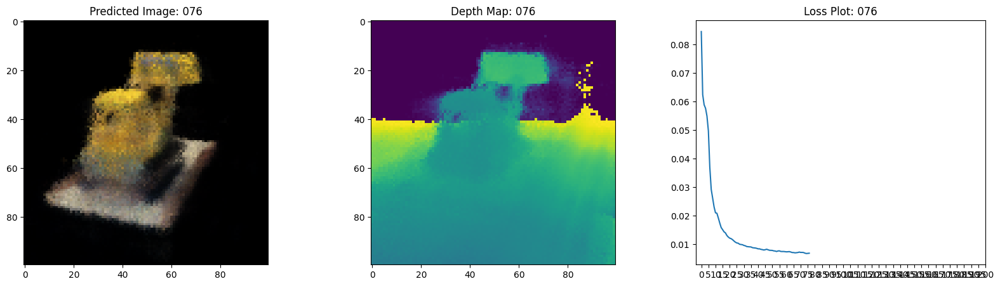

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0069 - psnr: 21.7620 - val_loss: 0.0077 - val_psnr: 21.2039
Epoch 78/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step


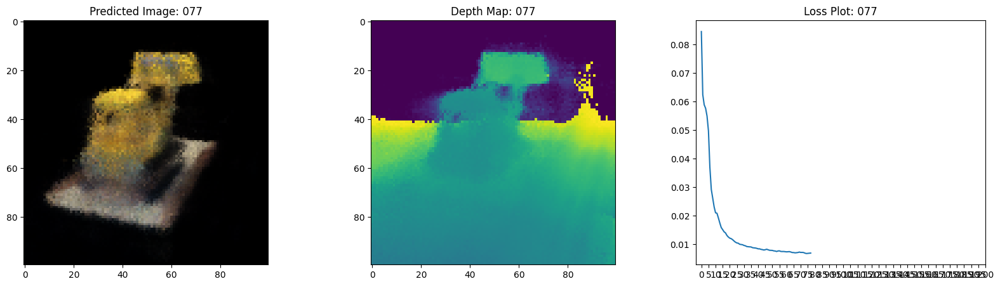

16/16 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - loss: 0.0070 - psnr: 21.6787 - val_loss: 0.0075 - val_psnr: 21.3330
Epoch 79/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


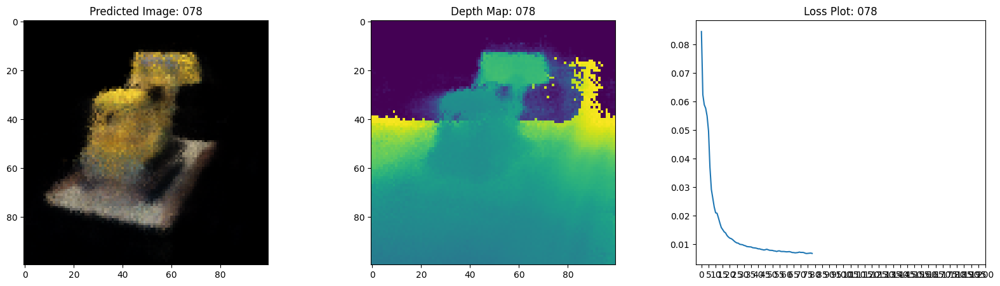

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0069 - psnr: 21.7619 - val_loss: 0.0072 - val_psnr: 21.5230
Epoch 80/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 817ms/step


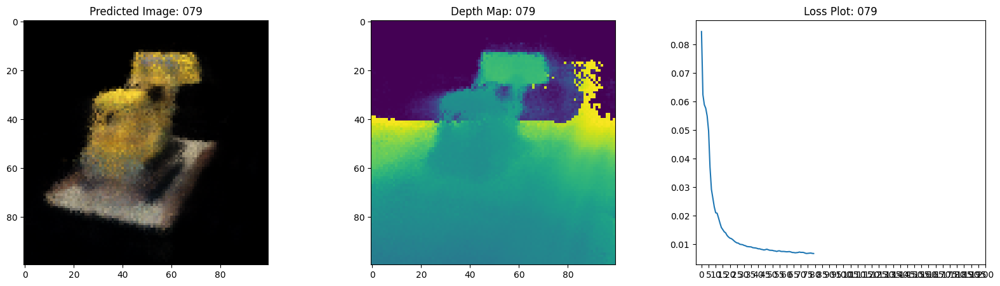

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0067 - psnr: 21.8554 - val_loss: 0.0076 - val_psnr: 21.3090
Epoch 81/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


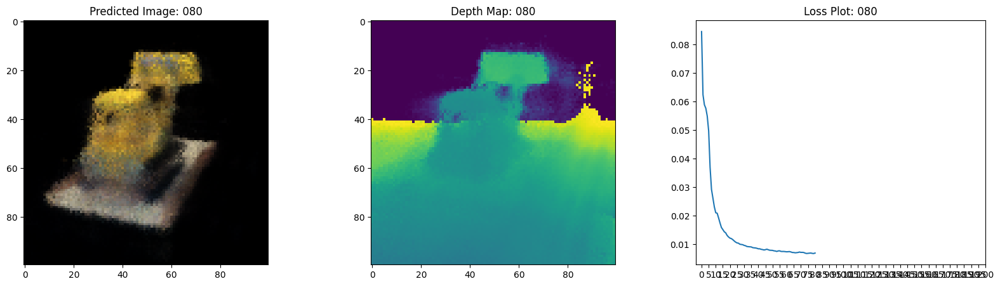

16/16 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - loss: 0.0069 - psnr: 21.7095 - val_loss: 0.0077 - val_psnr: 21.1610
Epoch 82/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


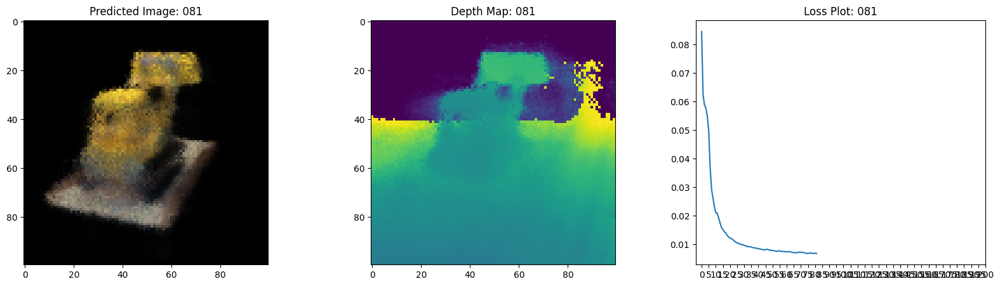

16/16 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - loss: 0.0068 - psnr: 21.7941 - val_loss: 0.0072 - val_psnr: 21.5464
Epoch 83/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


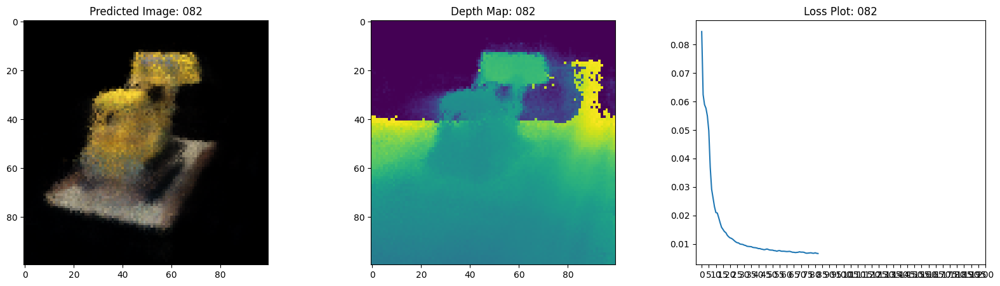

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0066 - psnr: 21.9327 - val_loss: 0.0074 - val_psnr: 21.4343
Epoch 84/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 702ms/step


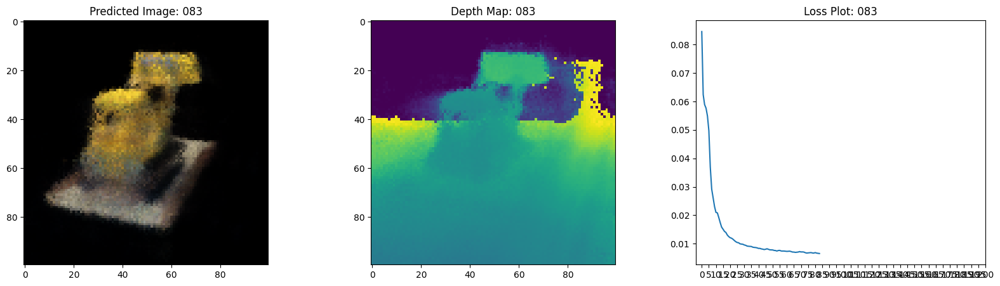

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0065 - psnr: 21.9793 - val_loss: 0.0074 - val_psnr: 21.4196
Epoch 85/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step


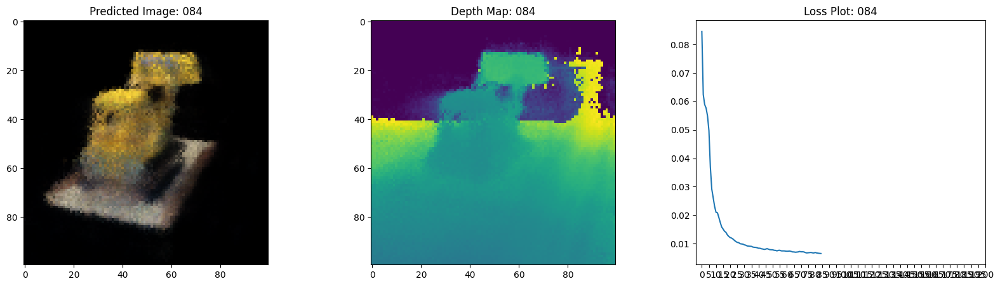

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0066 - psnr: 21.9499 - val_loss: 0.0072 - val_psnr: 21.5583
Epoch 86/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


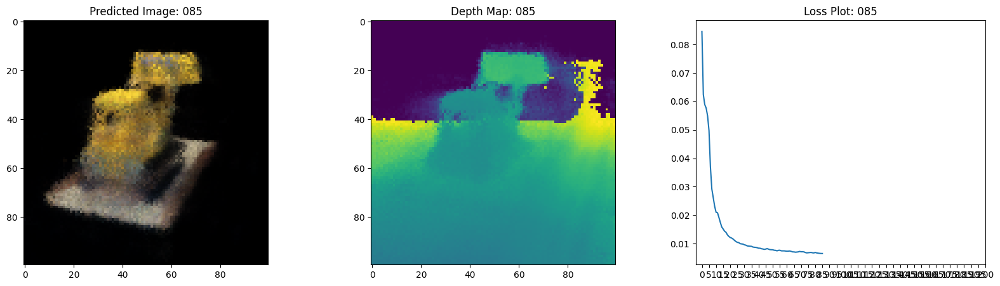

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0065 - psnr: 21.9829 - val_loss: 0.0071 - val_psnr: 21.6114
Epoch 87/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


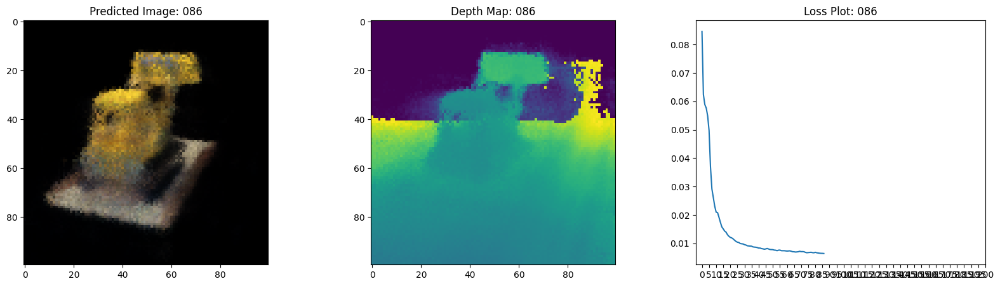

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0065 - psnr: 22.0040 - val_loss: 0.0070 - val_psnr: 21.7023
Epoch 88/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


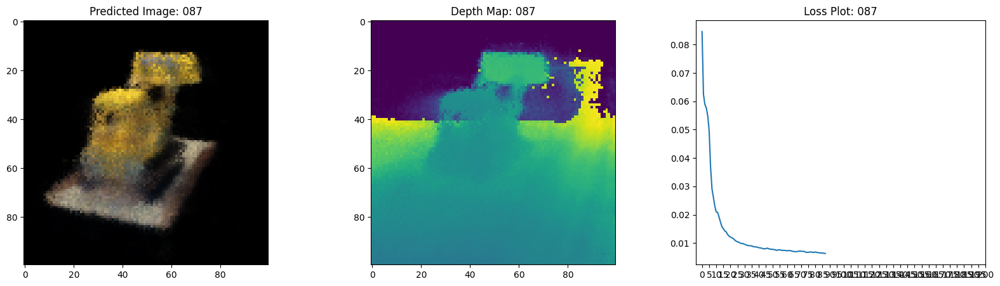

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0064 - psnr: 22.1159 - val_loss: 0.0072 - val_psnr: 21.5204
Epoch 89/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step


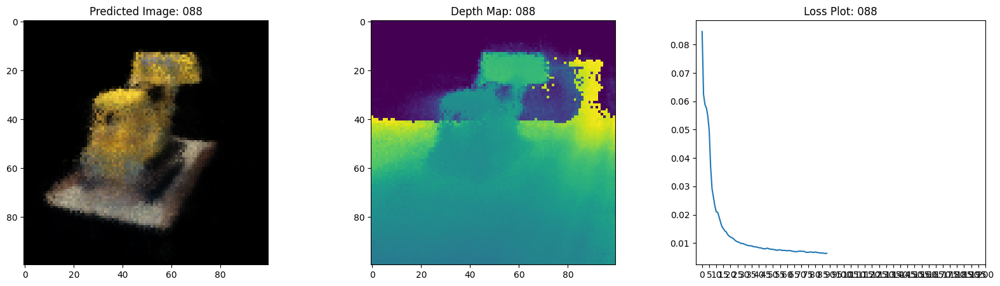

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0064 - psnr: 22.0969 - val_loss: 0.0072 - val_psnr: 21.5555
Epoch 90/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 718ms/step


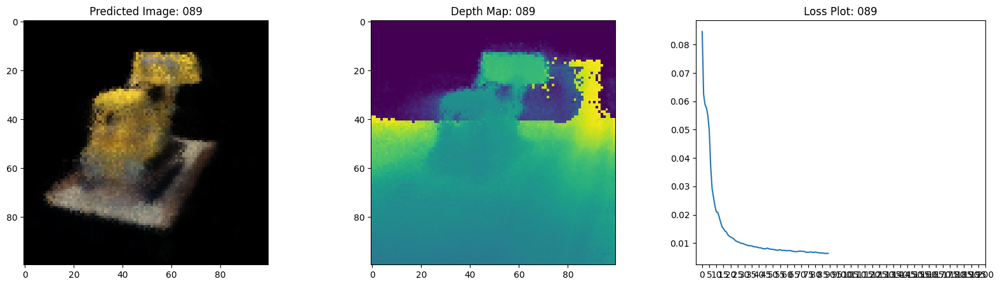

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0064 - psnr: 22.0667 - val_loss: 0.0071 - val_psnr: 21.6282
Epoch 91/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 680ms/step


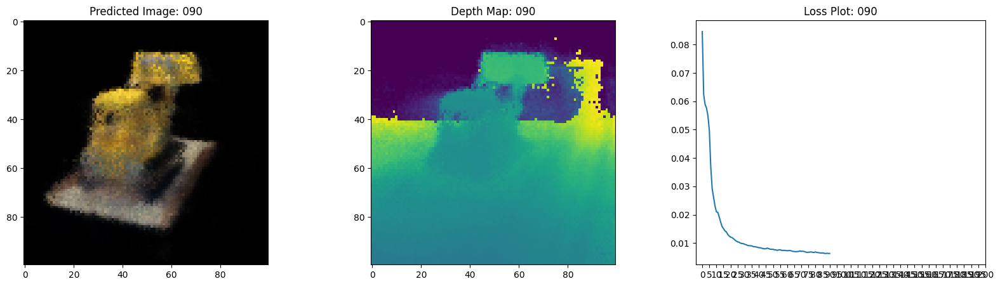

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0063 - psnr: 22.1565 - val_loss: 0.0071 - val_psnr: 21.5583
Epoch 92/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step


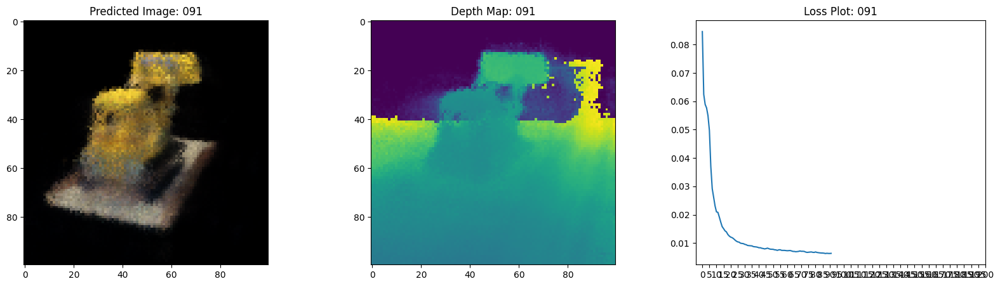

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0063 - psnr: 22.1180 - val_loss: 0.0070 - val_psnr: 21.7043
Epoch 93/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


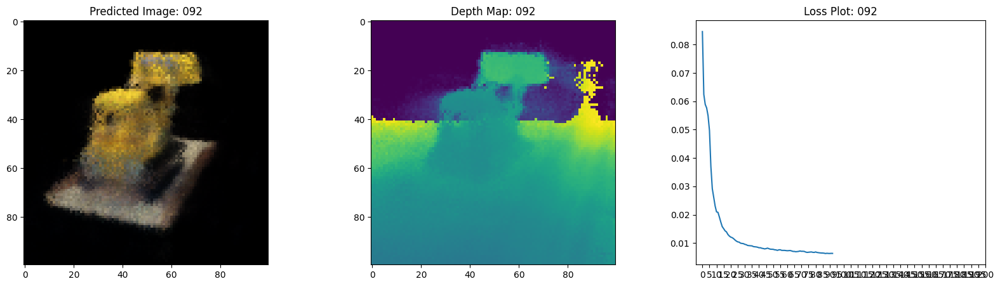

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0063 - psnr: 22.1374 - val_loss: 0.0070 - val_psnr: 21.6854
Epoch 94/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 731ms/step


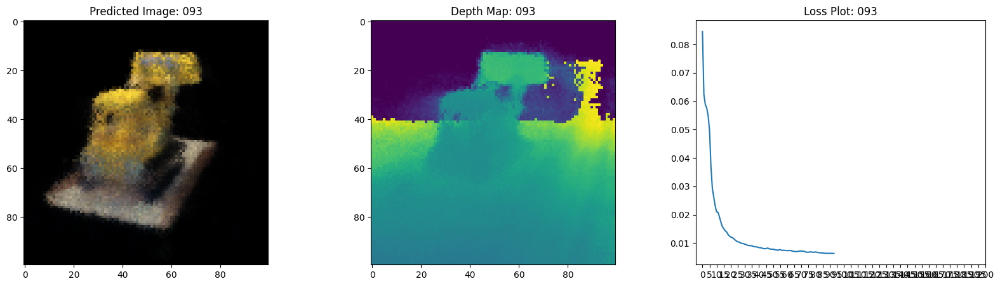

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0063 - psnr: 22.1293 - val_loss: 0.0069 - val_psnr: 21.7353
Epoch 95/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


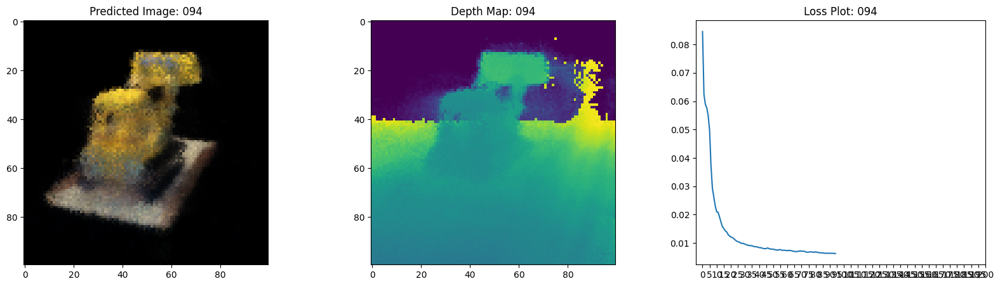

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0062 - psnr: 22.1922 - val_loss: 0.0072 - val_psnr: 21.5744
Epoch 96/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 777ms/step


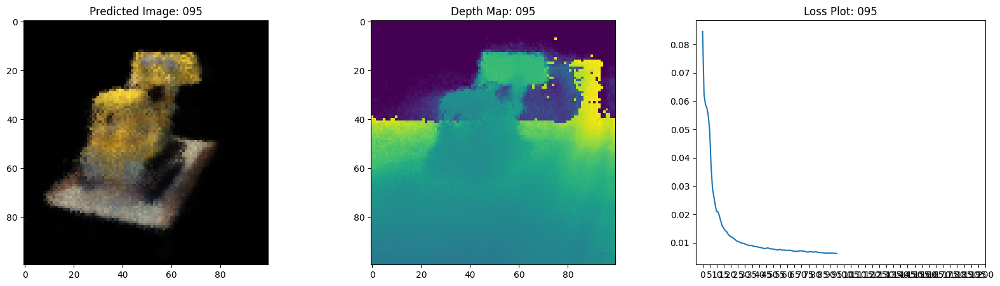

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0063 - psnr: 22.1175 - val_loss: 0.0068 - val_psnr: 21.7962
Epoch 97/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 822ms/step


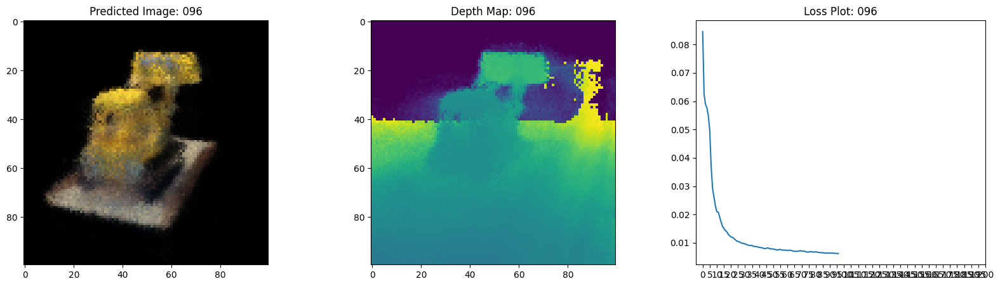

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0063 - psnr: 22.1574 - val_loss: 0.0071 - val_psnr: 21.5793
Epoch 98/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 733ms/step


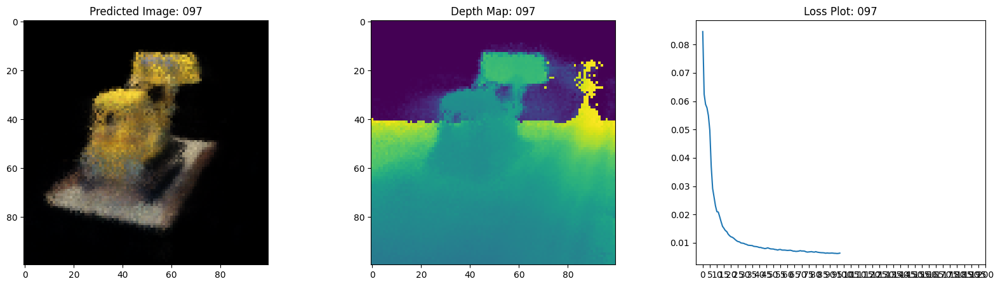

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0064 - psnr: 22.0858 - val_loss: 0.0074 - val_psnr: 21.3670
Epoch 99/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 722ms/step


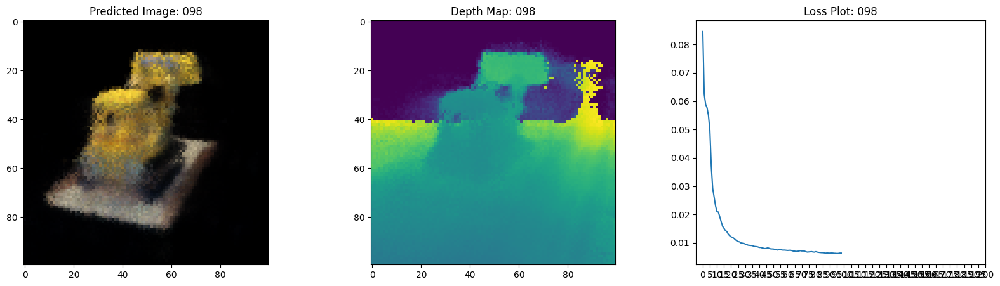

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0064 - psnr: 22.0650 - val_loss: 0.0069 - val_psnr: 21.7023
Epoch 100/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step


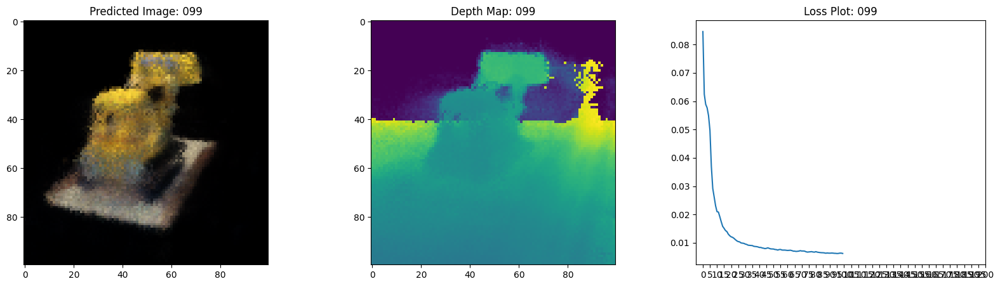

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0063 - psnr: 22.1413 - val_loss: 0.0069 - val_psnr: 21.7098
Epoch 101/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


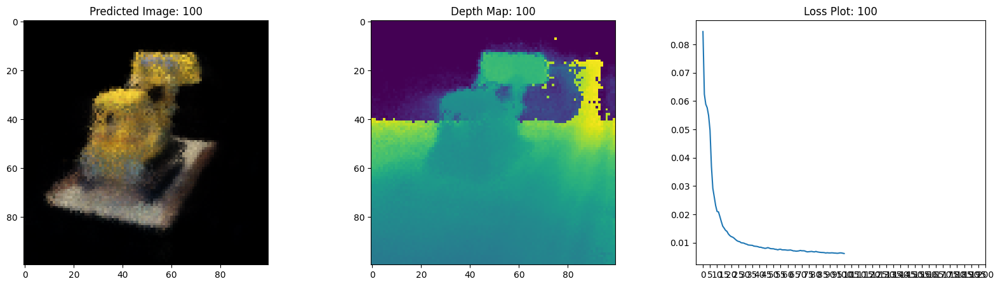

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0063 - psnr: 22.1466 - val_loss: 0.0070 - val_psnr: 21.6531
Epoch 102/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


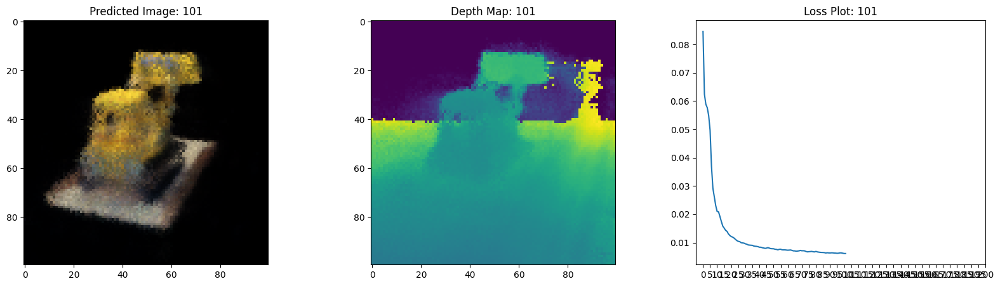

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0061 - psnr: 22.2487 - val_loss: 0.0070 - val_psnr: 21.7059
Epoch 103/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


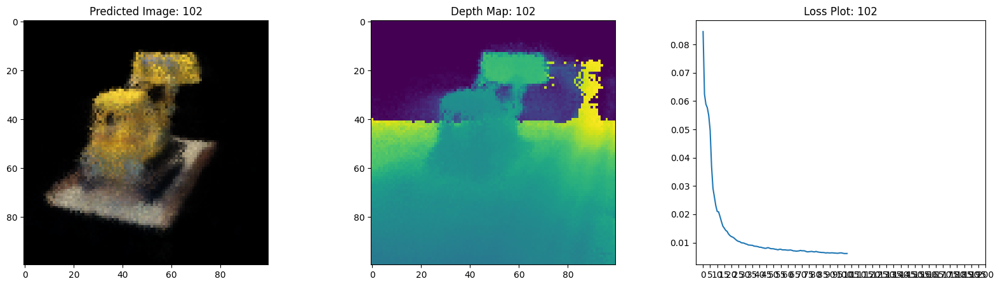

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0062 - psnr: 22.2450 - val_loss: 0.0071 - val_psnr: 21.5659
Epoch 104/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 803ms/step


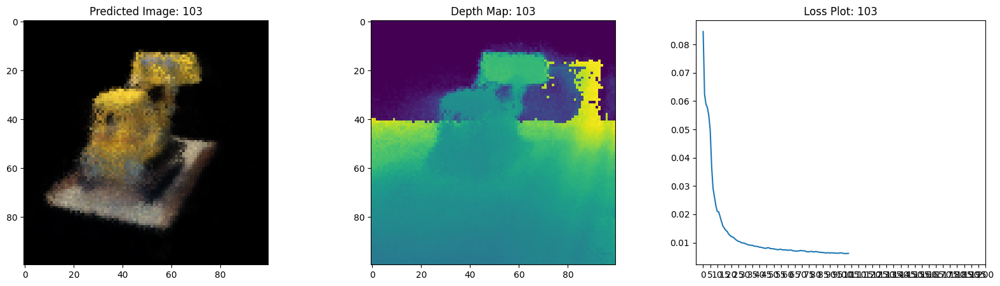

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0061 - psnr: 22.2719 - val_loss: 0.0067 - val_psnr: 21.9000
Epoch 105/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 779ms/step


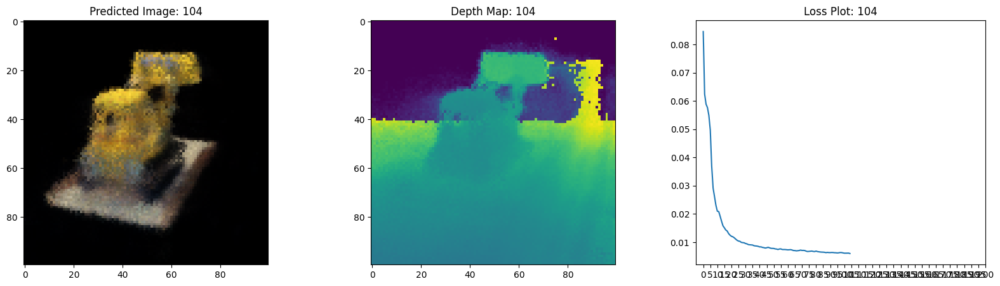

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0060 - psnr: 22.3625 - val_loss: 0.0068 - val_psnr: 21.8204
Epoch 106/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


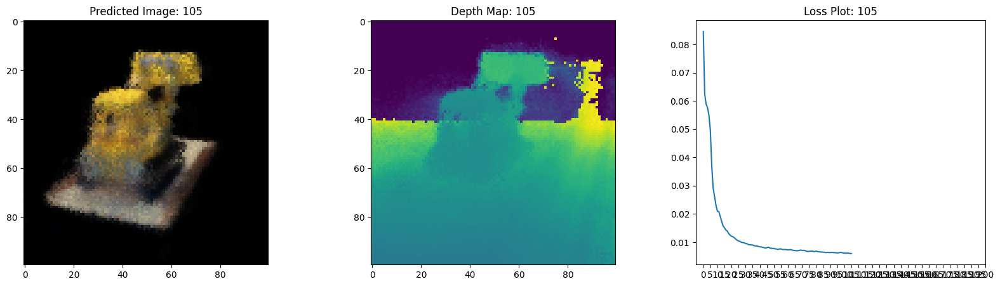

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0060 - psnr: 22.3764 - val_loss: 0.0071 - val_psnr: 21.5682
Epoch 107/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step


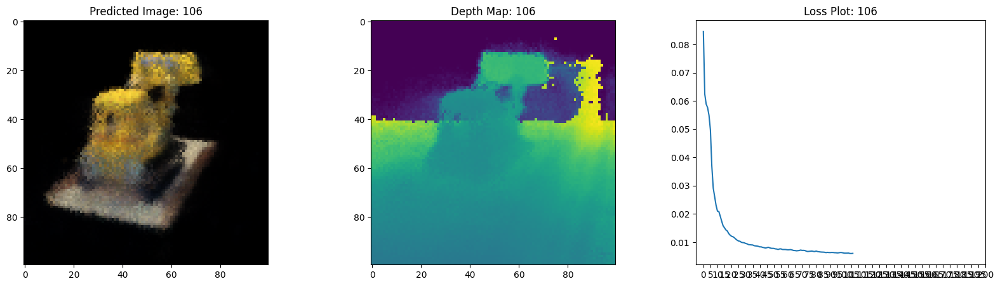

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0060 - psnr: 22.3391 - val_loss: 0.0070 - val_psnr: 21.6396
Epoch 108/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


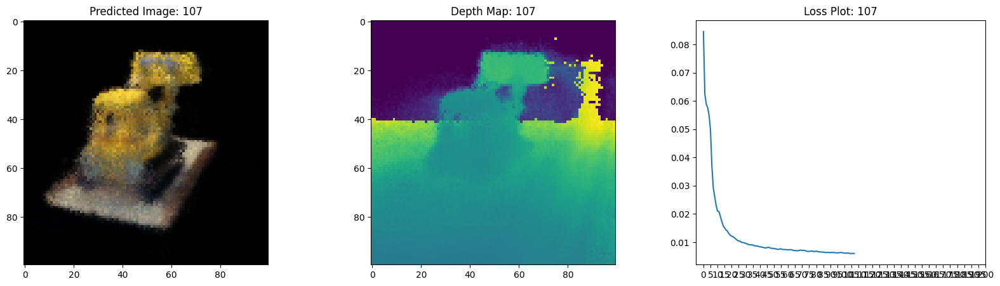

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0060 - psnr: 22.3115 - val_loss: 0.0068 - val_psnr: 21.7834
Epoch 109/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step


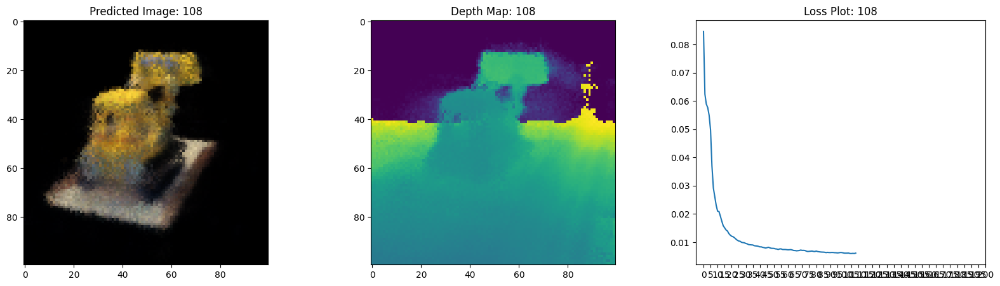

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0062 - psnr: 22.2037 - val_loss: 0.0071 - val_psnr: 21.5713
Epoch 110/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step


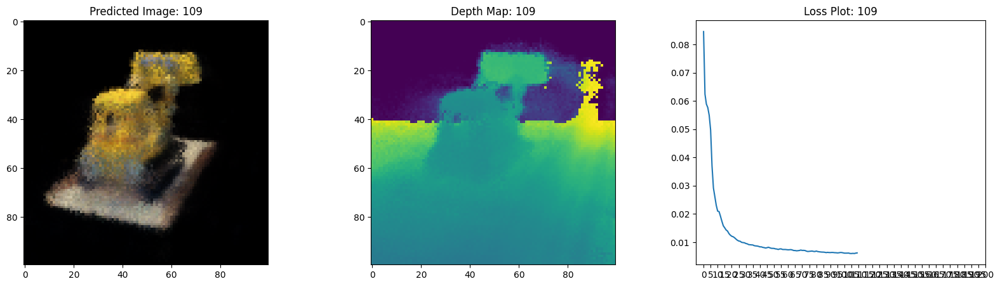

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0063 - psnr: 22.1637 - val_loss: 0.0069 - val_psnr: 21.7418
Epoch 111/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


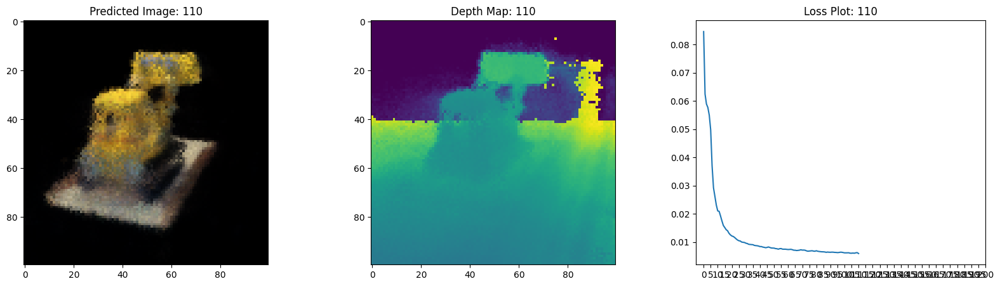

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0060 - psnr: 22.3217 - val_loss: 0.0068 - val_psnr: 21.8158
Epoch 112/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


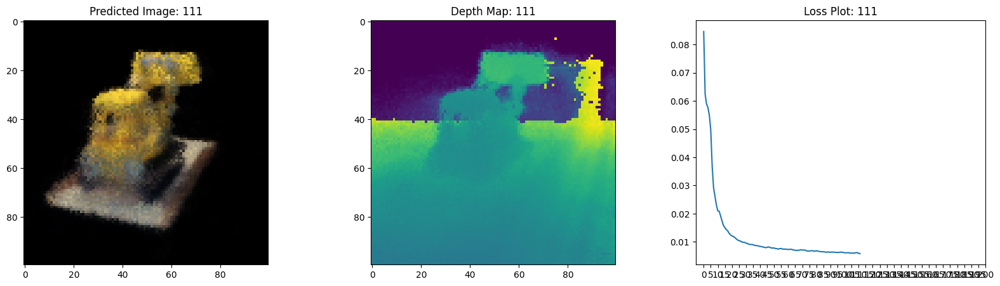

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0060 - psnr: 22.3856 - val_loss: 0.0068 - val_psnr: 21.8118
Epoch 113/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


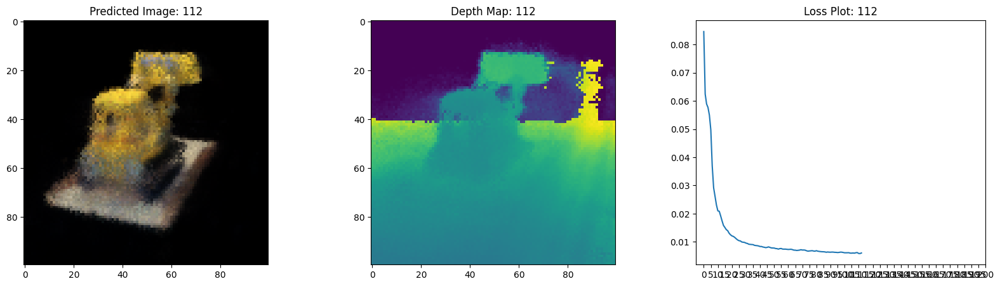

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0061 - psnr: 22.2735 - val_loss: 0.0070 - val_psnr: 21.6846
Epoch 114/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 756ms/step


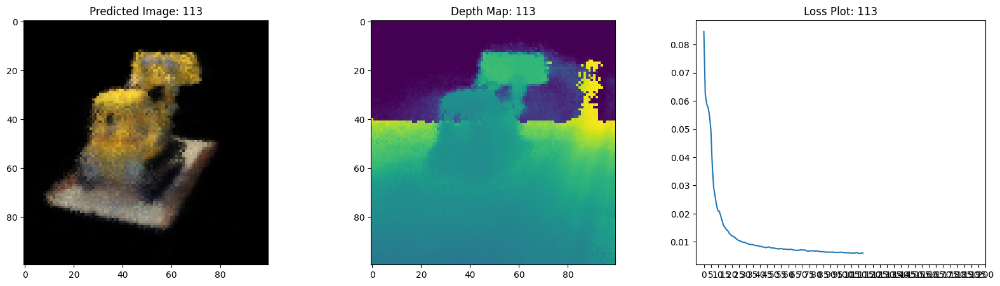

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0061 - psnr: 22.2593 - val_loss: 0.0069 - val_psnr: 21.7083
Epoch 115/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 806ms/step


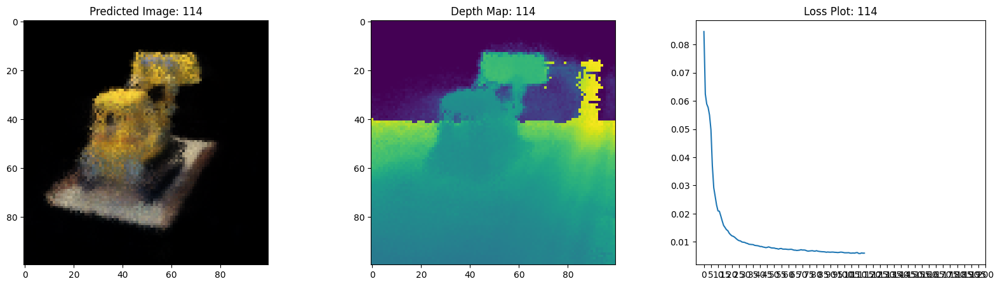

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0061 - psnr: 22.3223 - val_loss: 0.0069 - val_psnr: 21.7227
Epoch 116/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


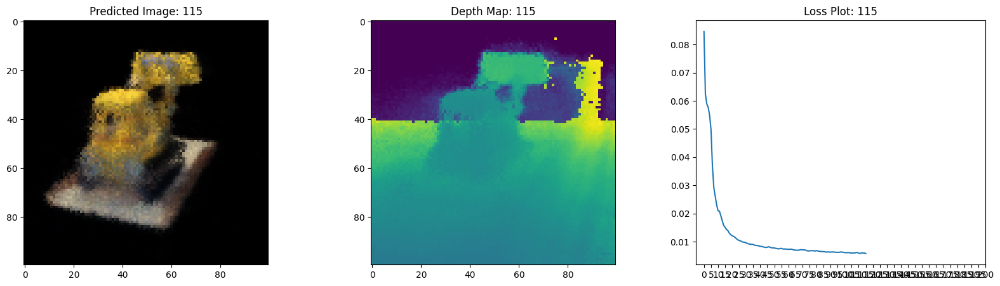

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0059 - psnr: 22.4107 - val_loss: 0.0067 - val_psnr: 21.9093
Epoch 117/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


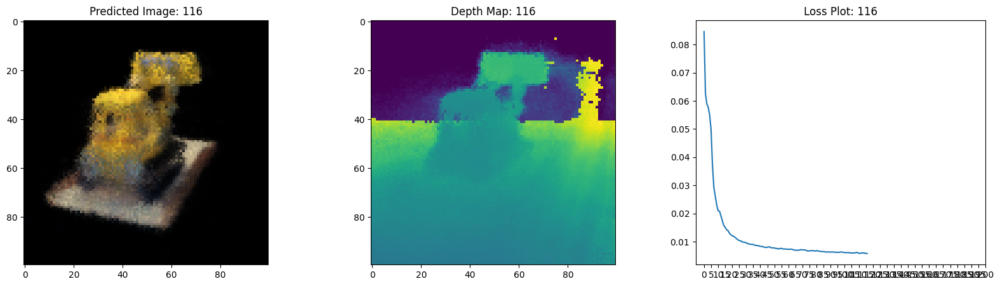

16/16 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - loss: 0.0058 - psnr: 22.5086 - val_loss: 0.0067 - val_psnr: 21.9109
Epoch 118/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step


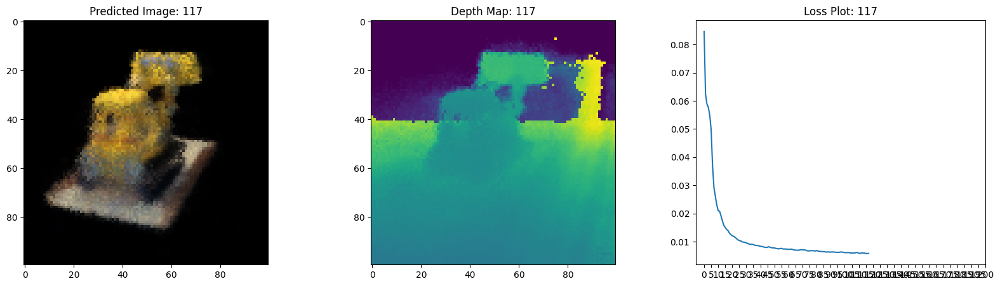

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0060 - psnr: 22.3757 - val_loss: 0.0067 - val_psnr: 21.8930
Epoch 119/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


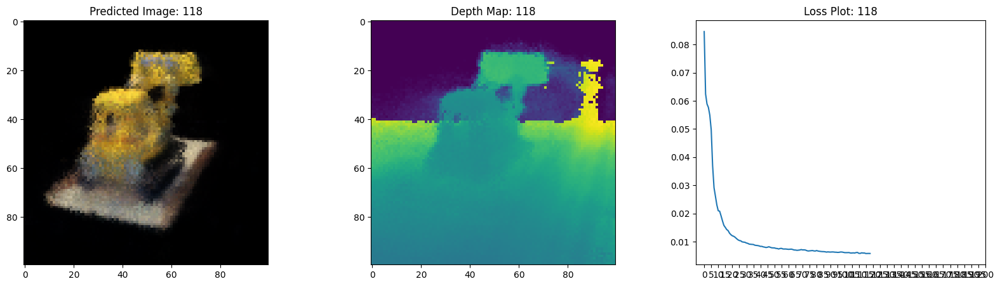

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0059 - psnr: 22.4381 - val_loss: 0.0068 - val_psnr: 21.7800
Epoch 120/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


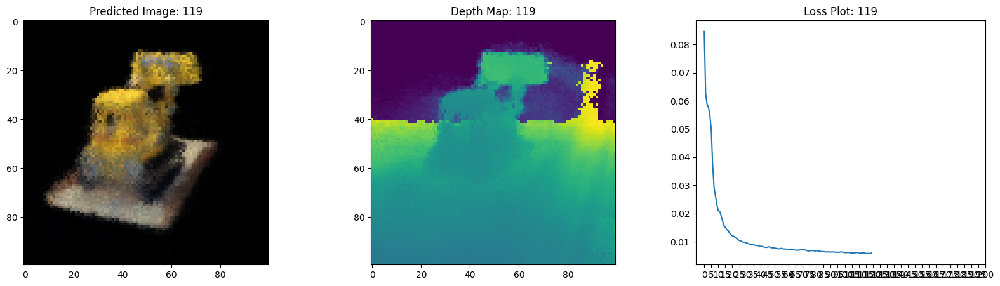

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0060 - psnr: 22.3289 - val_loss: 0.0069 - val_psnr: 21.6526
Epoch 121/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 753ms/step


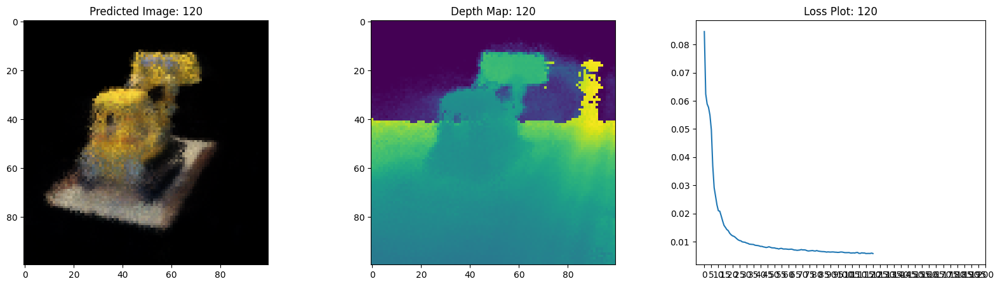

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0059 - psnr: 22.4102 - val_loss: 0.0067 - val_psnr: 21.7969
Epoch 122/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step


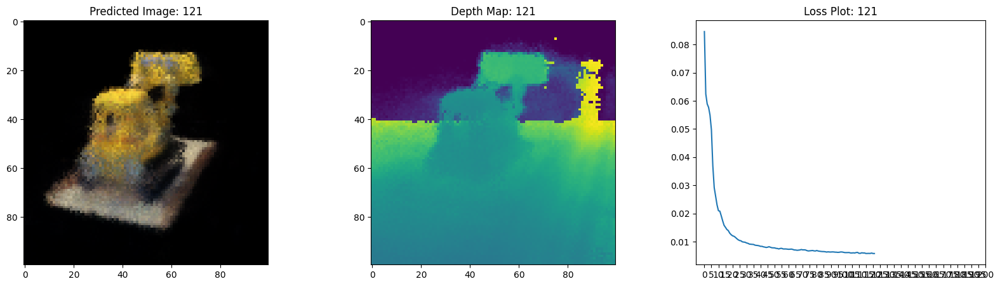

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0059 - psnr: 22.4456 - val_loss: 0.0069 - val_psnr: 21.6895
Epoch 123/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 720ms/step


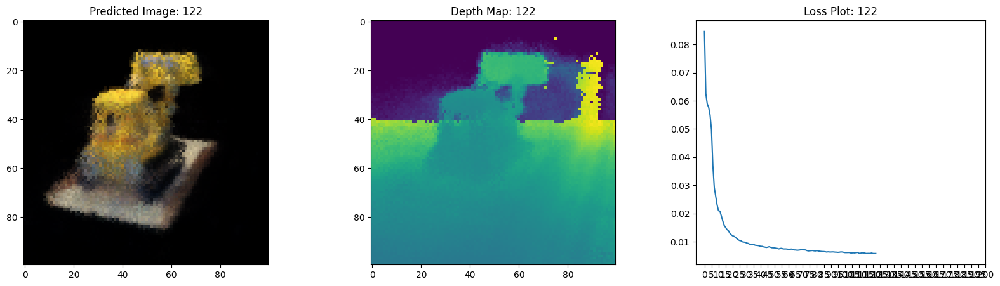

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0058 - psnr: 22.5037 - val_loss: 0.0068 - val_psnr: 21.7744
Epoch 124/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 753ms/step


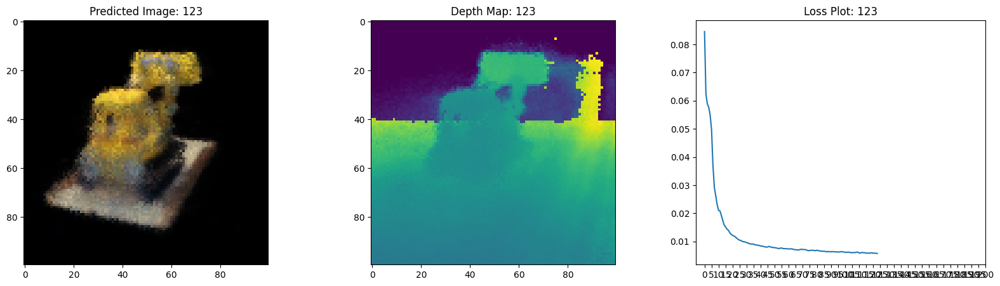

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0057 - psnr: 22.5387 - val_loss: 0.0067 - val_psnr: 21.8879
Epoch 125/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


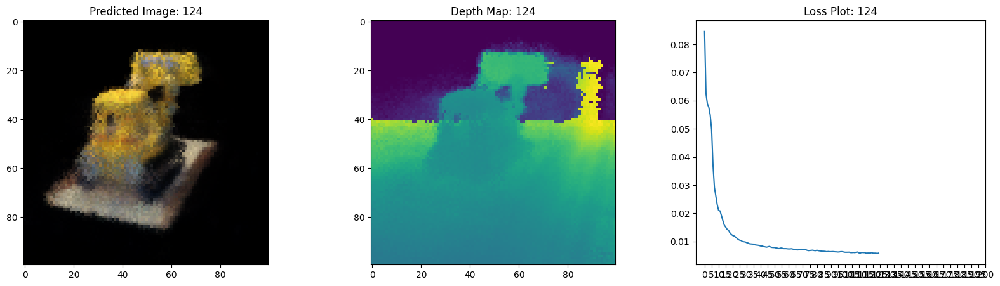

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0059 - psnr: 22.4423 - val_loss: 0.0069 - val_psnr: 21.7048
Epoch 126/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 720ms/step


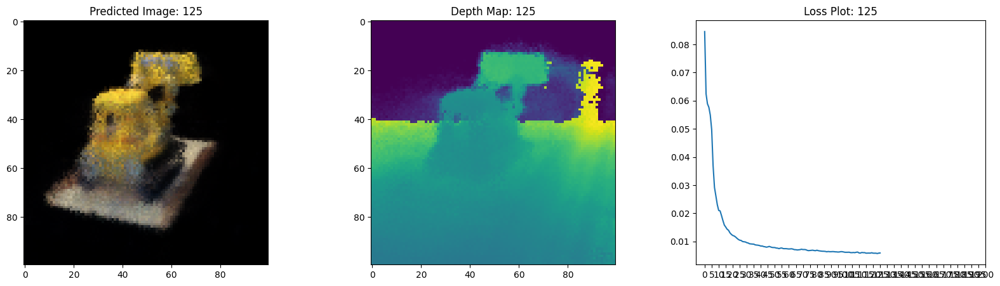

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0058 - psnr: 22.4640 - val_loss: 0.0066 - val_psnr: 21.9303
Epoch 127/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


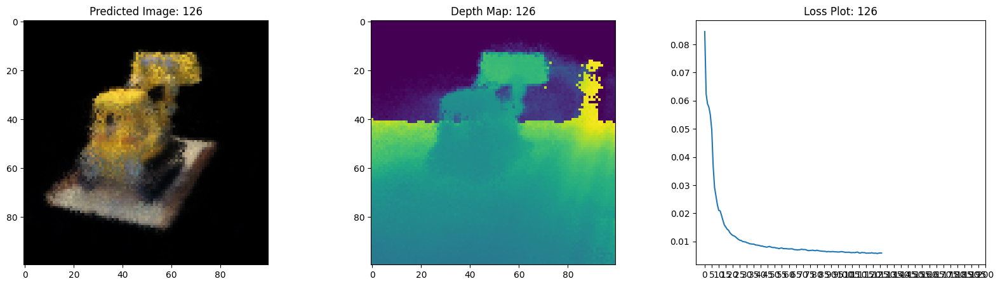

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0059 - psnr: 22.3841 - val_loss: 0.0066 - val_psnr: 21.8711
Epoch 128/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


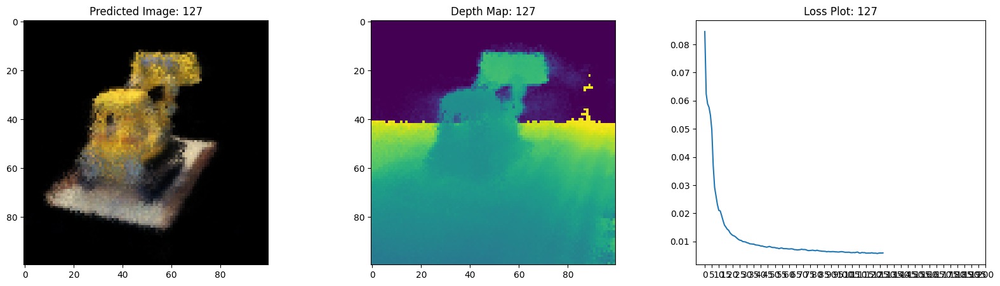

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0058 - psnr: 22.4712 - val_loss: 0.0074 - val_psnr: 21.3165
Epoch 129/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


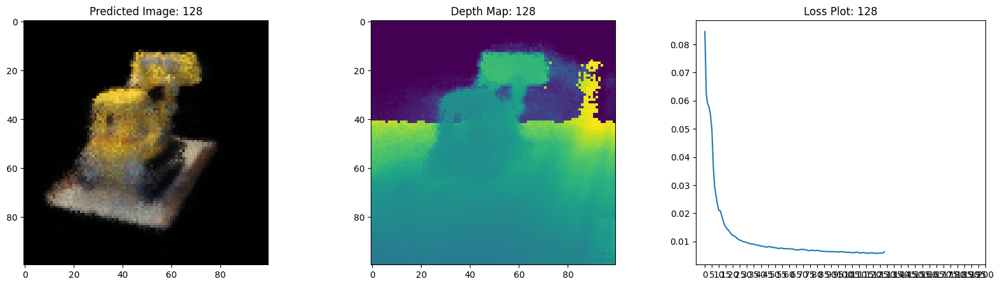

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0065 - psnr: 21.9597 - val_loss: 0.0067 - val_psnr: 21.8420
Epoch 130/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step


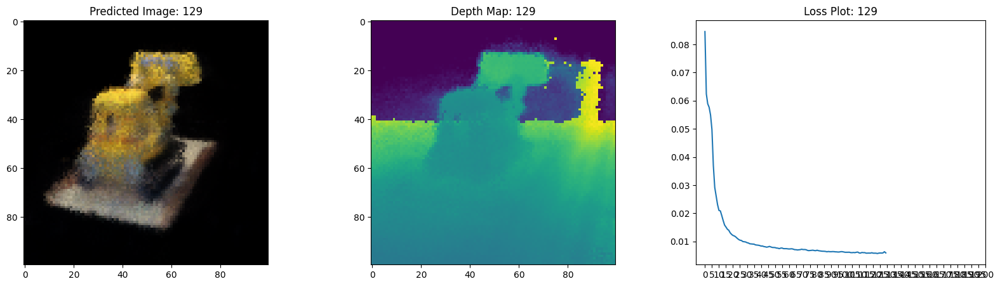

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0061 - psnr: 22.2918 - val_loss: 0.0070 - val_psnr: 21.5961
Epoch 131/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


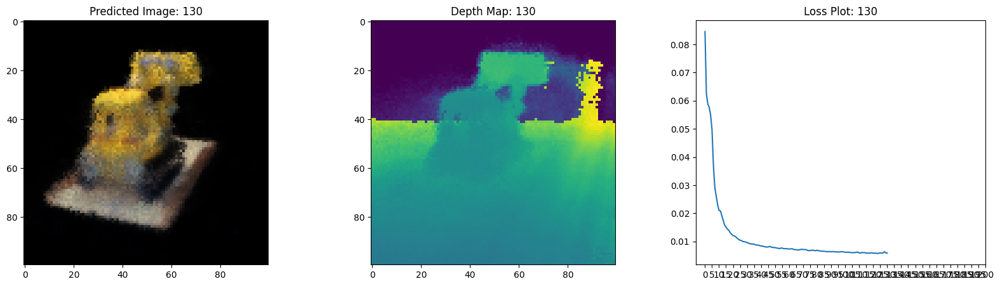

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0059 - psnr: 22.4432 - val_loss: 0.0069 - val_psnr: 21.6471
Epoch 132/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 769ms/step


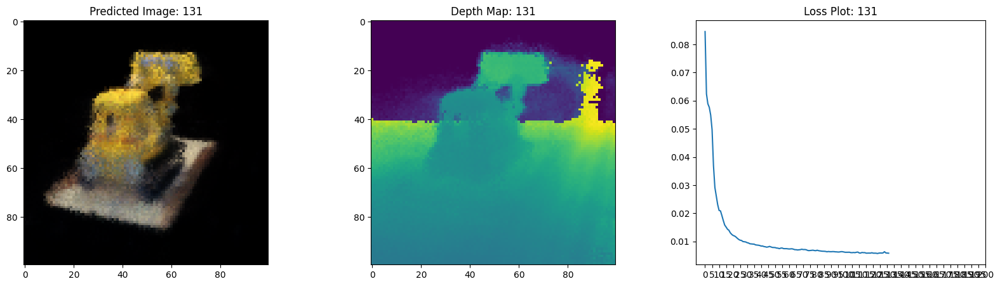

16/16 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - loss: 0.0059 - psnr: 22.4248 - val_loss: 0.0069 - val_psnr: 21.7190
Epoch 133/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step


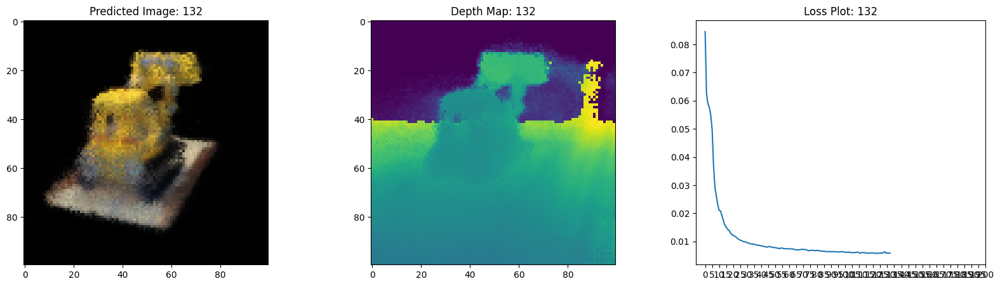

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0060 - psnr: 22.3725 - val_loss: 0.0068 - val_psnr: 21.7336
Epoch 134/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 817ms/step


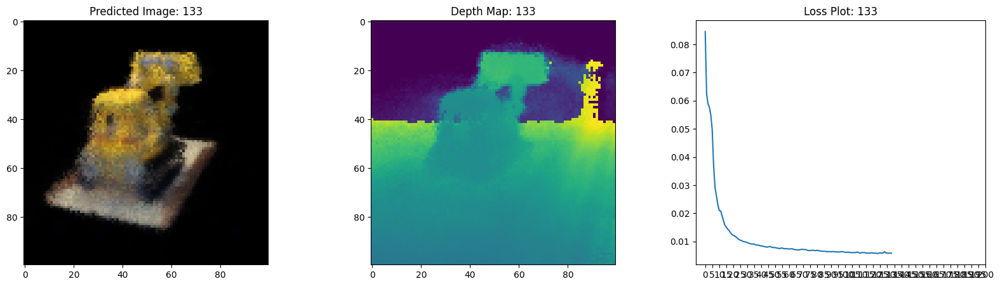

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0060 - psnr: 22.3718 - val_loss: 0.0067 - val_psnr: 21.8766
Epoch 135/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 808ms/step


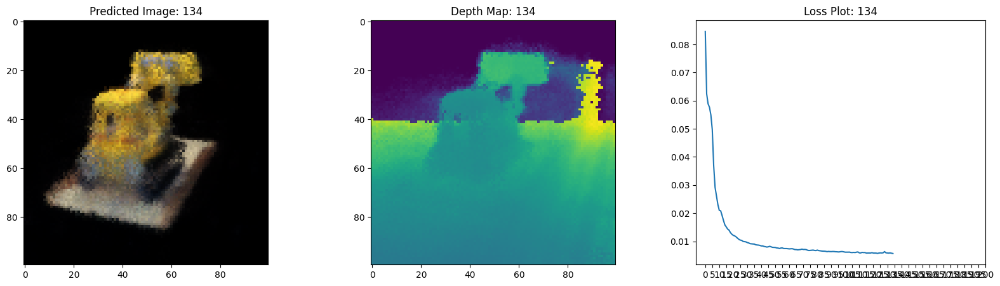

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0058 - psnr: 22.5117 - val_loss: 0.0068 - val_psnr: 21.7653
Epoch 136/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 817ms/step


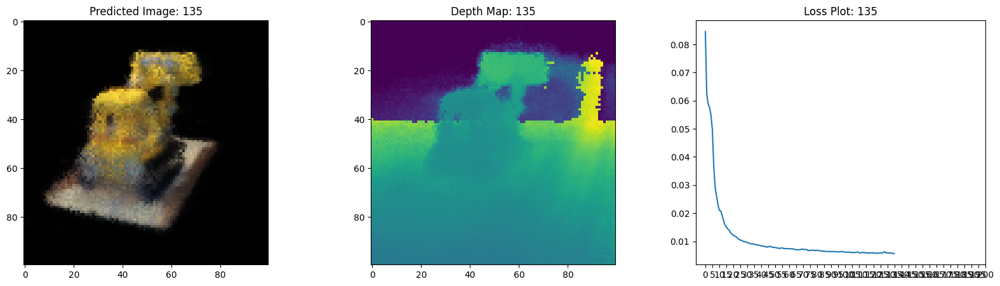

16/16 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - loss: 0.0057 - psnr: 22.5935 - val_loss: 0.0069 - val_psnr: 21.6919
Epoch 137/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step


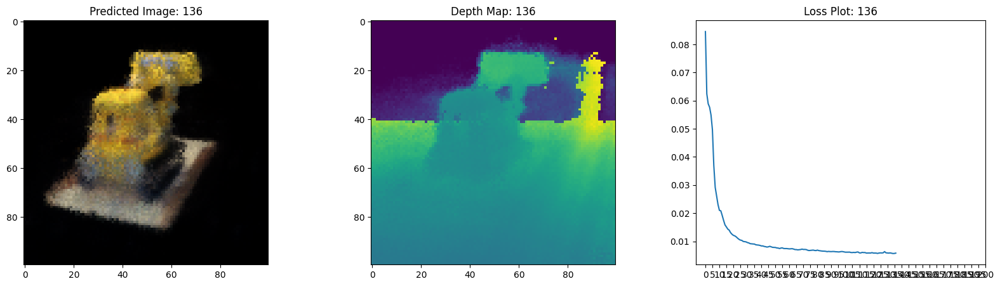

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0058 - psnr: 22.4558 - val_loss: 0.0070 - val_psnr: 21.6078
Epoch 138/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 722ms/step


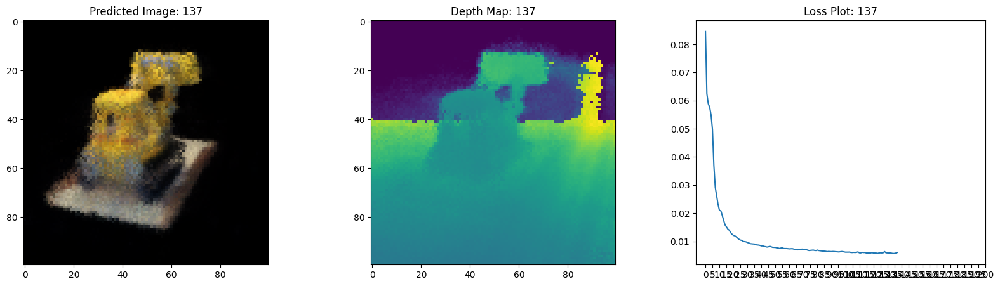

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0060 - psnr: 22.3688 - val_loss: 0.0066 - val_psnr: 21.9725
Epoch 139/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


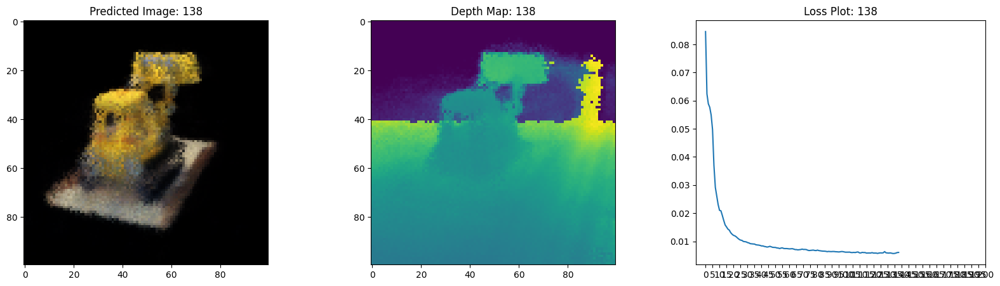

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0060 - psnr: 22.3585 - val_loss: 0.0067 - val_psnr: 21.9378
Epoch 140/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


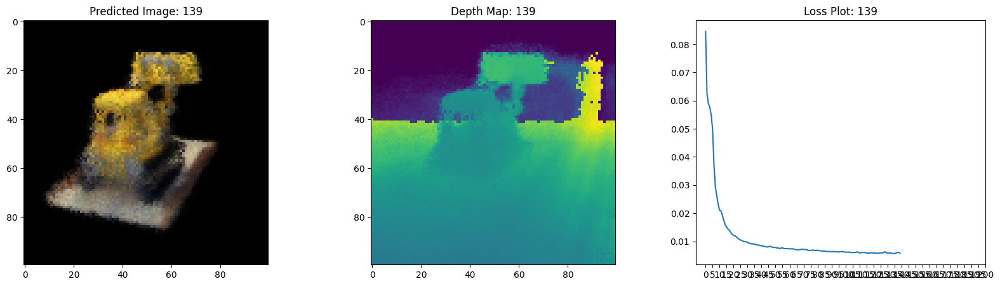

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0058 - psnr: 22.4810 - val_loss: 0.0064 - val_psnr: 22.1116
Epoch 141/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


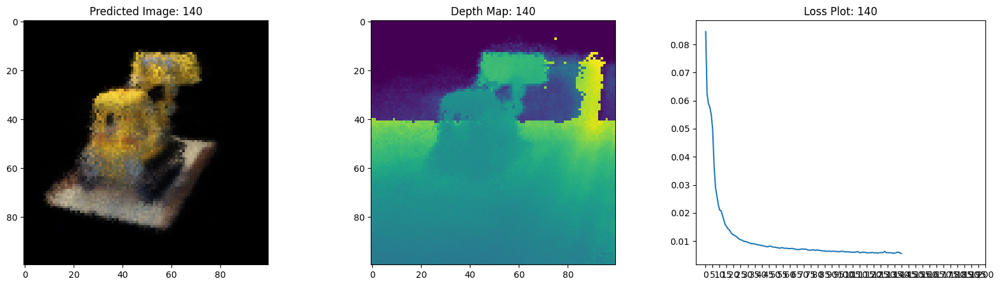

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0056 - psnr: 22.6314 - val_loss: 0.0064 - val_psnr: 22.0859
Epoch 142/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 801ms/step


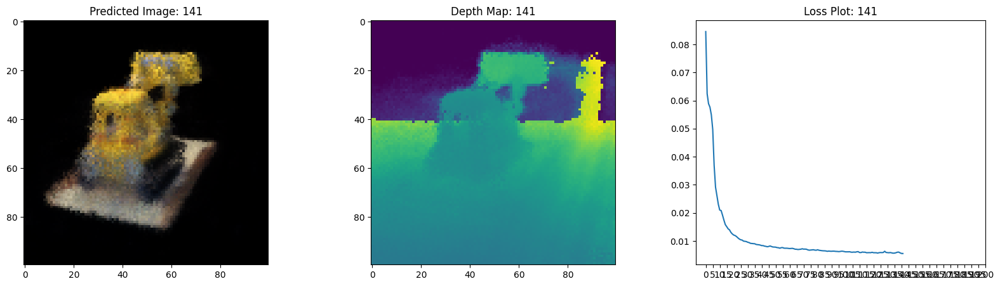

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0056 - psnr: 22.6689 - val_loss: 0.0062 - val_psnr: 22.1743
Epoch 143/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 810ms/step


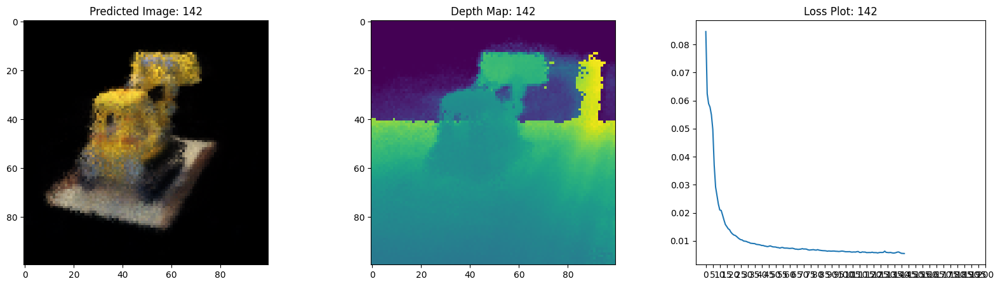

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0055 - psnr: 22.7334 - val_loss: 0.0064 - val_psnr: 22.0634
Epoch 144/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 852ms/step


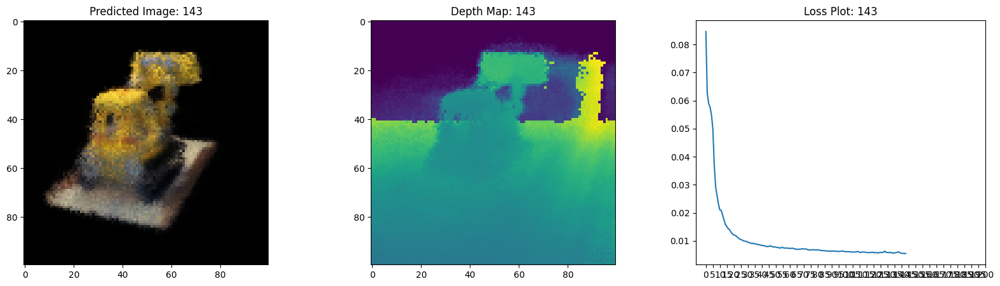

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0055 - psnr: 22.7115 - val_loss: 0.0066 - val_psnr: 21.9368
Epoch 145/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 741ms/step


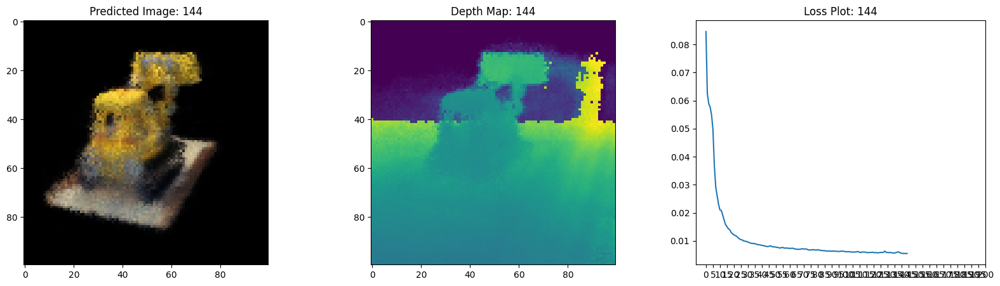

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0055 - psnr: 22.7184 - val_loss: 0.0064 - val_psnr: 22.1038
Epoch 146/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 726ms/step


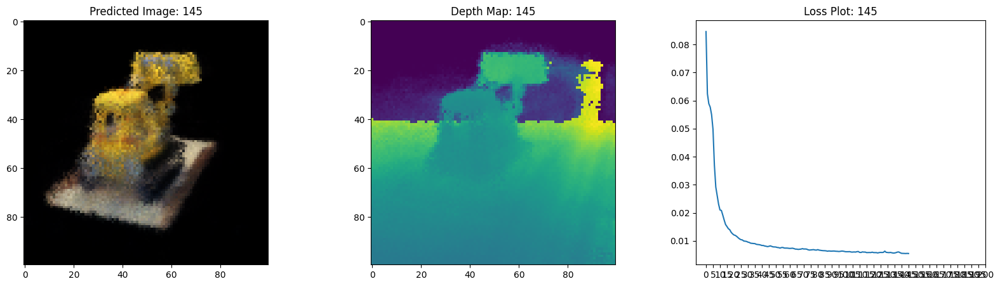

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0055 - psnr: 22.7335 - val_loss: 0.0065 - val_psnr: 22.0163
Epoch 147/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 720ms/step


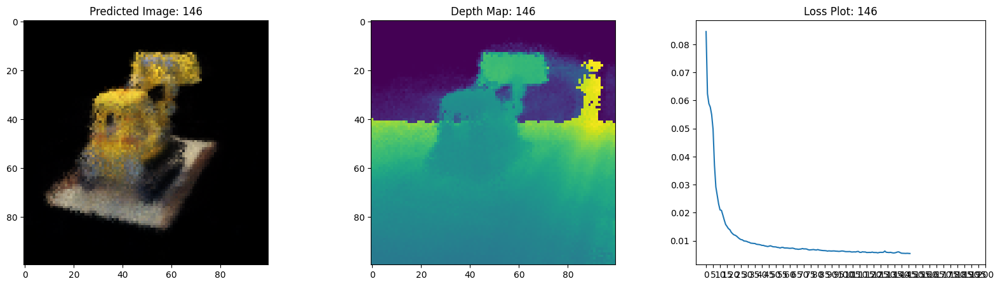

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0055 - psnr: 22.7190 - val_loss: 0.0065 - val_psnr: 22.0034
Epoch 148/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step


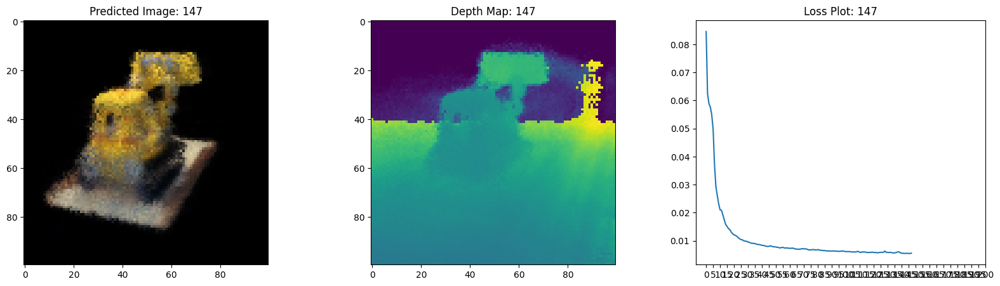

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0056 - psnr: 22.6476 - val_loss: 0.0064 - val_psnr: 22.0515
Epoch 149/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 727ms/step


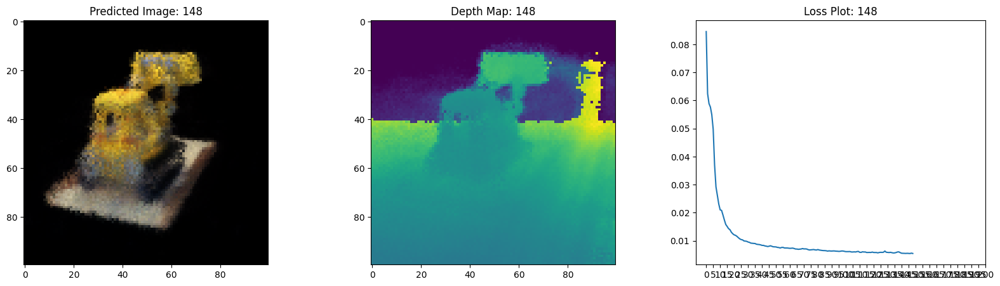

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0055 - psnr: 22.7262 - val_loss: 0.0065 - val_psnr: 21.9553
Epoch 150/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


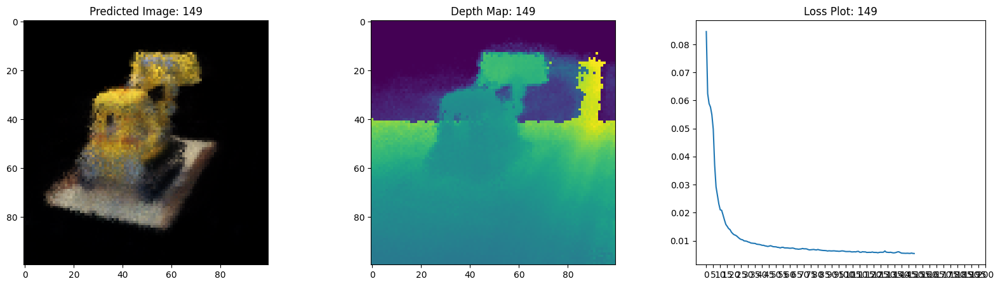

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0055 - psnr: 22.7264 - val_loss: 0.0066 - val_psnr: 21.8437
Epoch 151/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 725ms/step


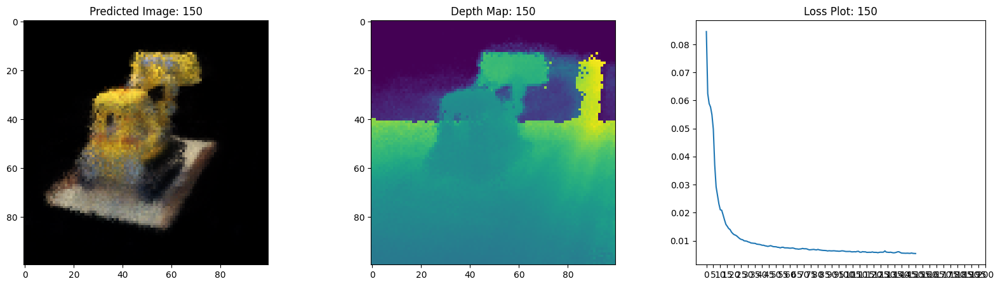

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0055 - psnr: 22.7350 - val_loss: 0.0064 - val_psnr: 21.9894
Epoch 152/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step


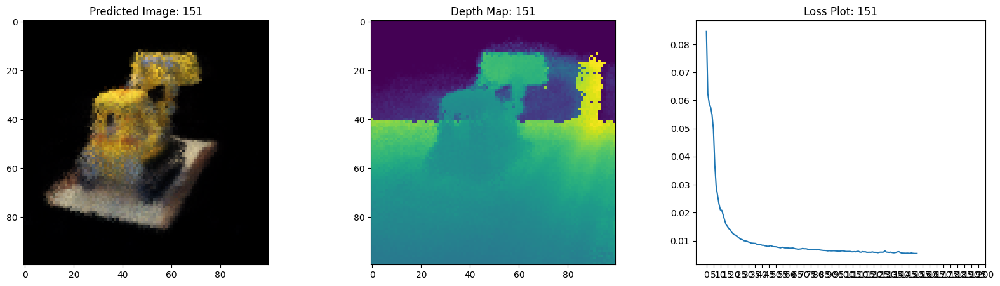

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0054 - psnr: 22.7971 - val_loss: 0.0063 - val_psnr: 22.1439
Epoch 153/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


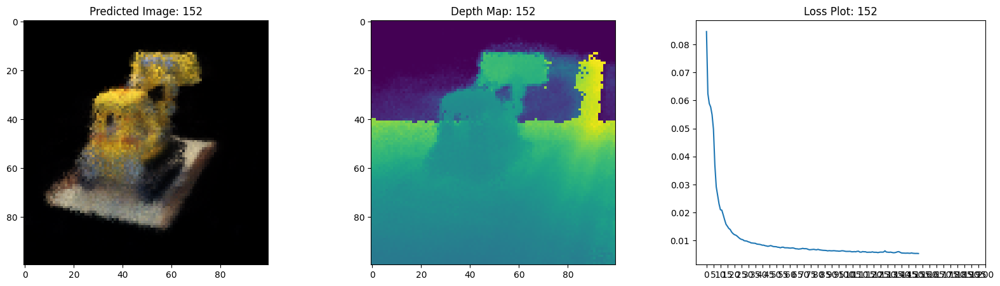

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0055 - psnr: 22.7611 - val_loss: 0.0063 - val_psnr: 22.1570
Epoch 154/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 833ms/step


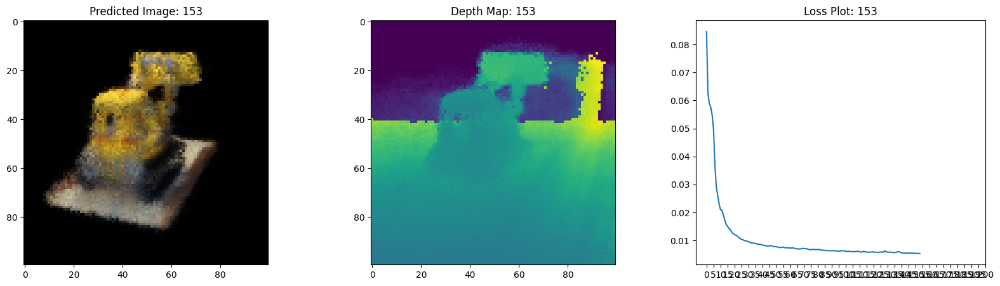

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0054 - psnr: 22.8370 - val_loss: 0.0063 - val_psnr: 22.1907
Epoch 155/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 734ms/step


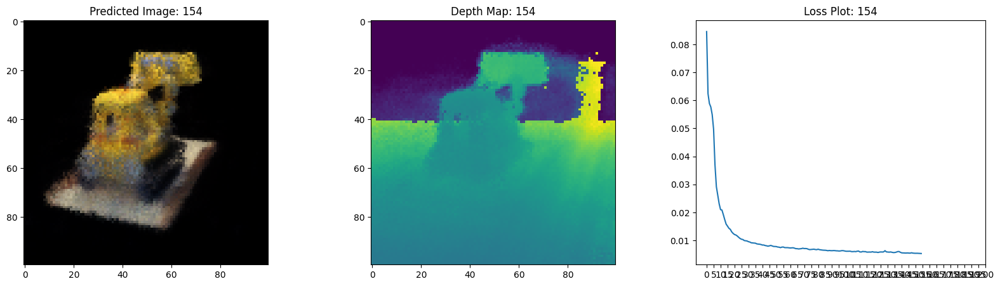

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0053 - psnr: 22.8458 - val_loss: 0.0065 - val_psnr: 22.0037
Epoch 156/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step


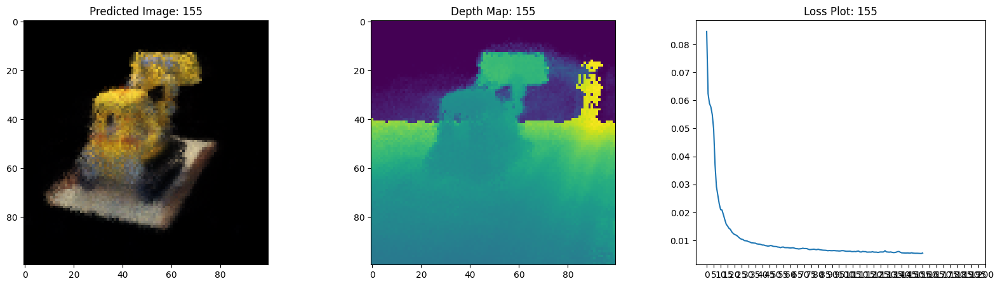

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0055 - psnr: 22.7179 - val_loss: 0.0063 - val_psnr: 22.1352
Epoch 157/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step


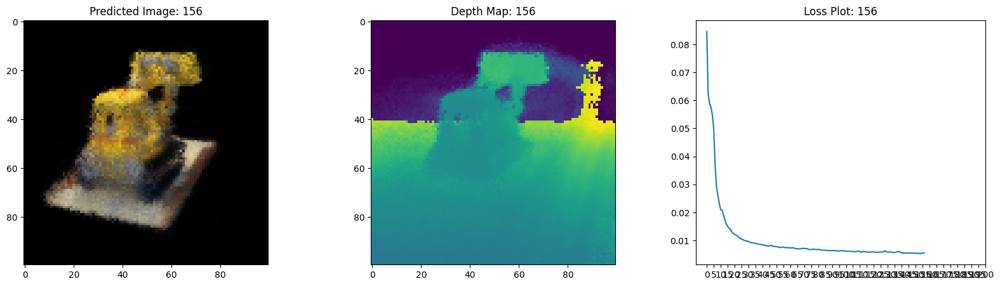

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0055 - psnr: 22.7250 - val_loss: 0.0066 - val_psnr: 21.9258
Epoch 158/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 827ms/step


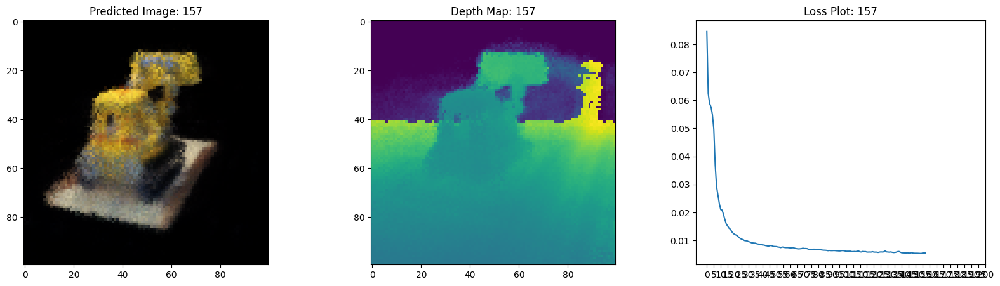

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0055 - psnr: 22.7056 - val_loss: 0.0067 - val_psnr: 21.8787
Epoch 159/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 718ms/step


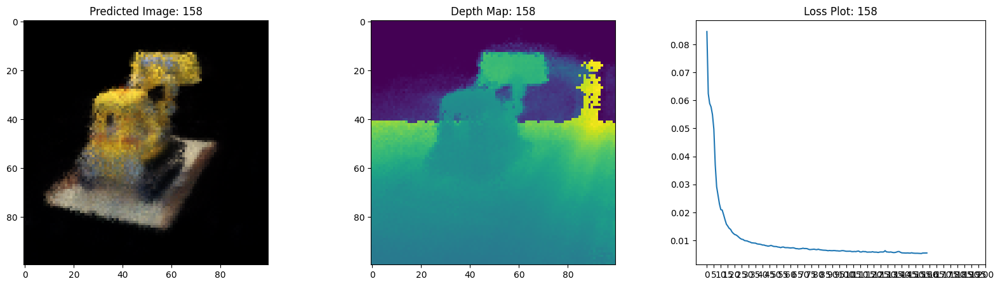

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0055 - psnr: 22.6845 - val_loss: 0.0066 - val_psnr: 21.9255
Epoch 160/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 702ms/step


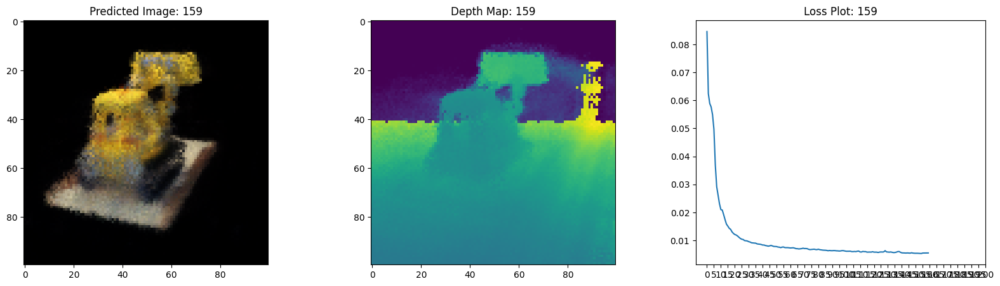

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0056 - psnr: 22.6685 - val_loss: 0.0065 - val_psnr: 21.9650
Epoch 161/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 842ms/step


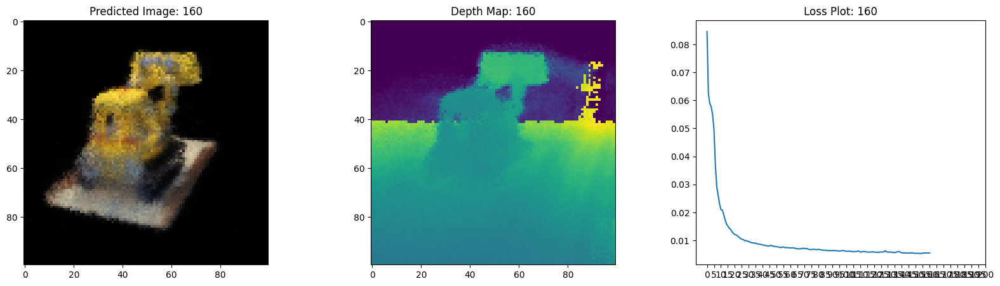

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0055 - psnr: 22.7104 - val_loss: 0.0069 - val_psnr: 21.6305
Epoch 162/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step


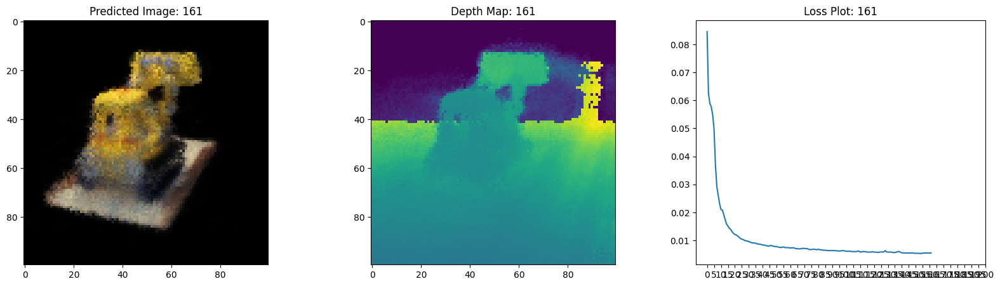

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0056 - psnr: 22.6220 - val_loss: 0.0065 - val_psnr: 21.9638
Epoch 163/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step


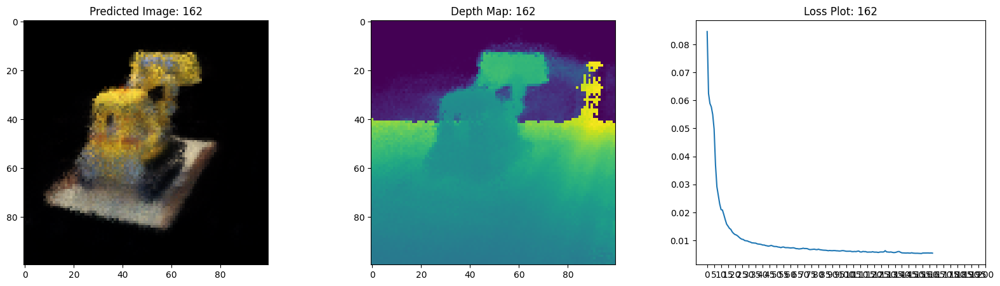

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0054 - psnr: 22.7732 - val_loss: 0.0068 - val_psnr: 21.7631
Epoch 164/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step


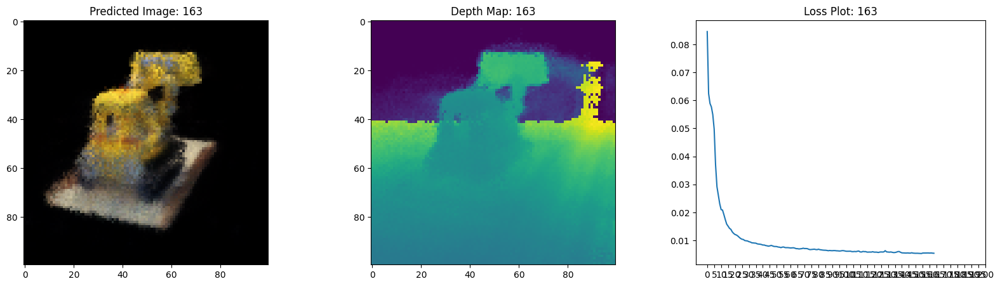

16/16 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - loss: 0.0055 - psnr: 22.6900 - val_loss: 0.0065 - val_psnr: 22.0022
Epoch 165/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step


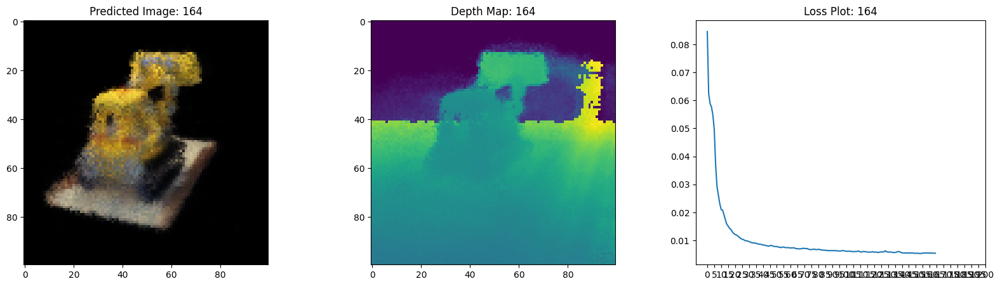

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0055 - psnr: 22.7168 - val_loss: 0.0065 - val_psnr: 21.9374
Epoch 166/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 718ms/step


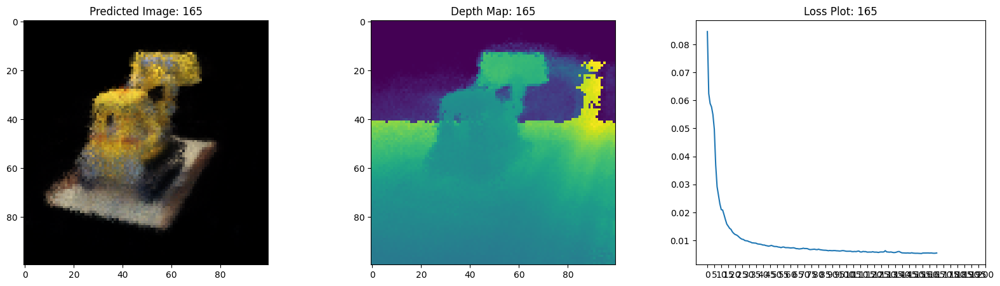

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0055 - psnr: 22.7425 - val_loss: 0.0065 - val_psnr: 21.9799
Epoch 167/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step


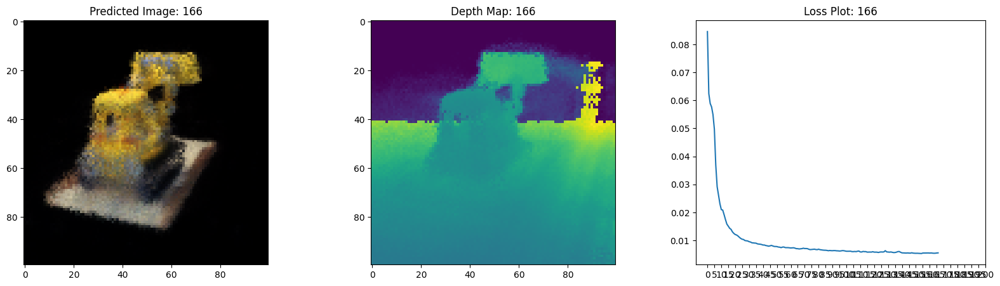

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0056 - psnr: 22.6526 - val_loss: 0.0066 - val_psnr: 21.9014
Epoch 168/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 740ms/step


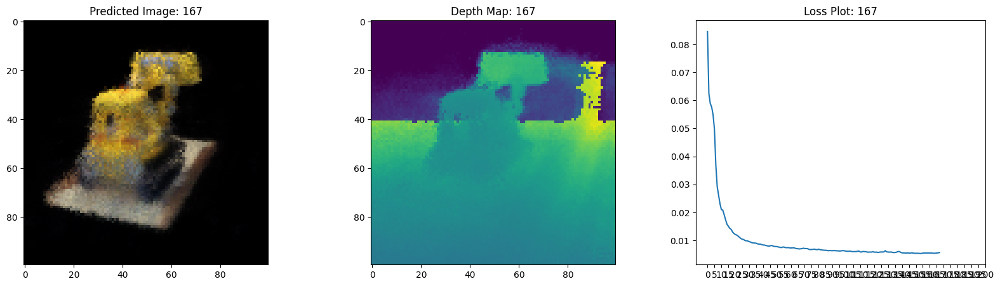

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0056 - psnr: 22.6326 - val_loss: 0.0067 - val_psnr: 21.8116
Epoch 169/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


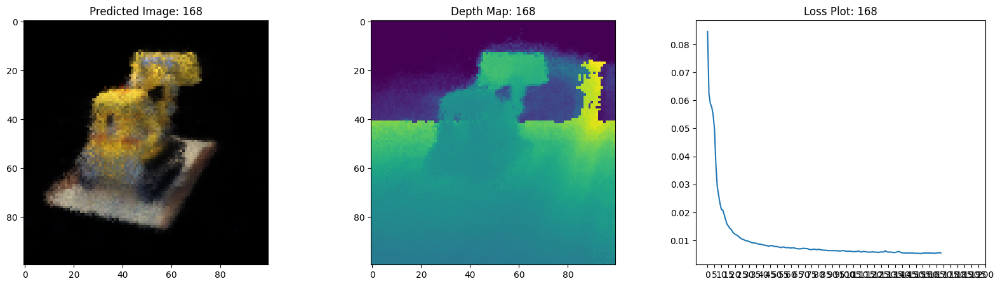

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0056 - psnr: 22.6250 - val_loss: 0.0064 - val_psnr: 22.0991
Epoch 170/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step


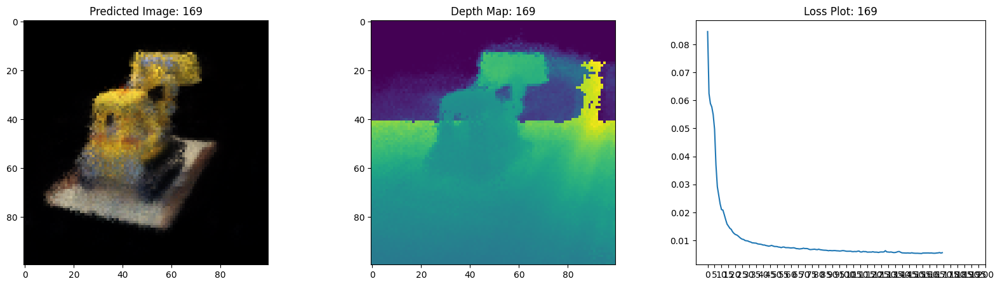

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0056 - psnr: 22.6452 - val_loss: 0.0063 - val_psnr: 22.1461
Epoch 171/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step


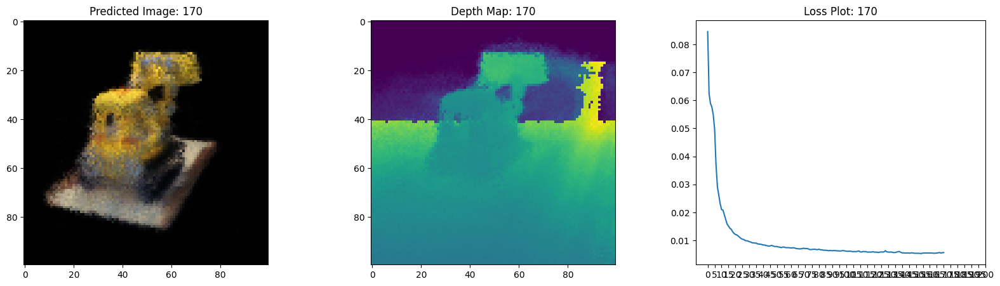

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0056 - psnr: 22.6746 - val_loss: 0.0064 - val_psnr: 22.0593
Epoch 172/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


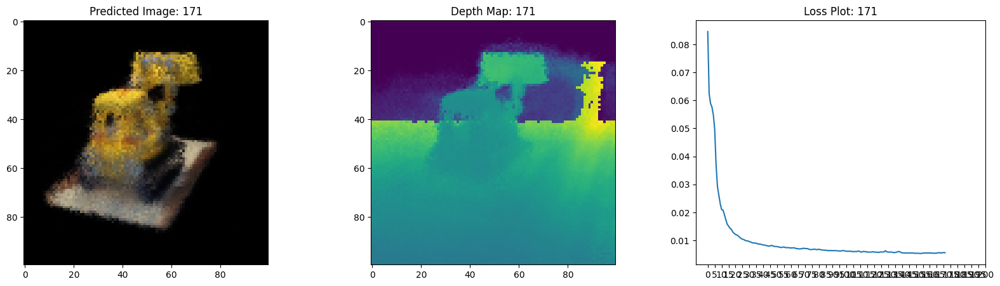

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0056 - psnr: 22.7005 - val_loss: 0.0065 - val_psnr: 21.9892
Epoch 173/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step


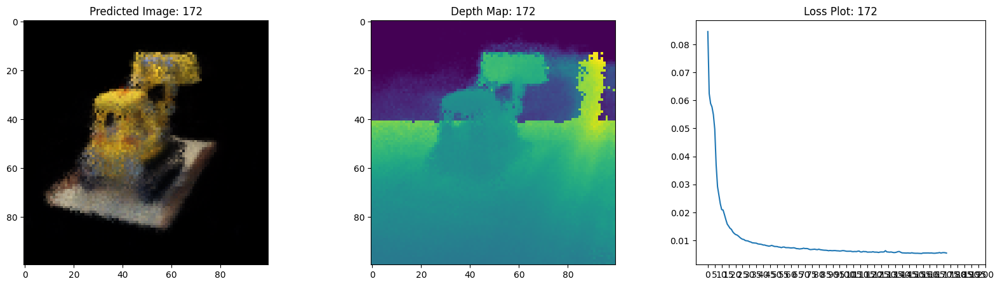

16/16 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - loss: 0.0055 - psnr: 22.7394 - val_loss: 0.0065 - val_psnr: 22.0571
Epoch 174/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 742ms/step


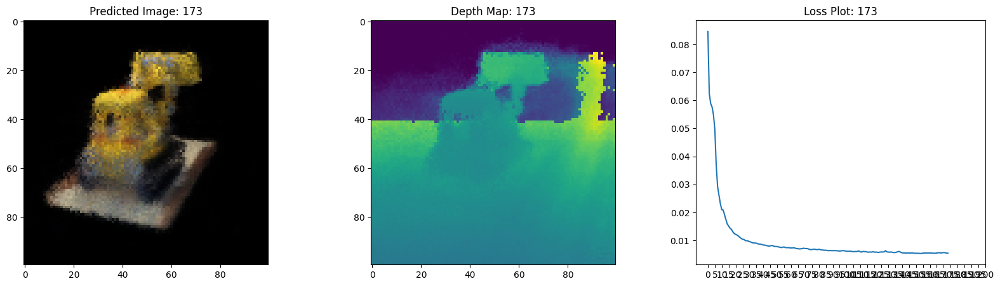

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0055 - psnr: 22.7219 - val_loss: 0.0065 - val_psnr: 21.9689
Epoch 175/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 718ms/step


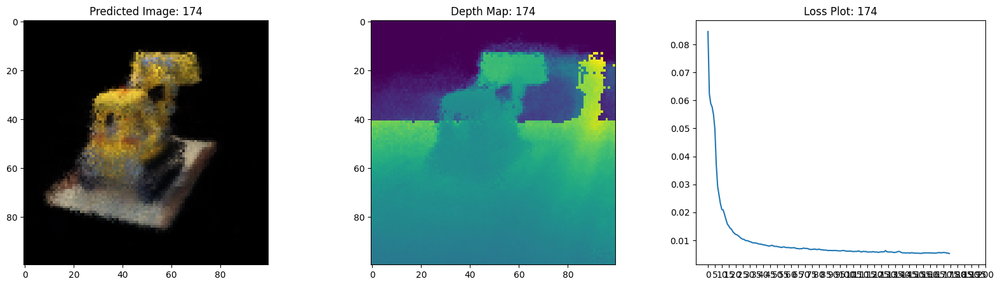

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0053 - psnr: 22.8182 - val_loss: 0.0063 - val_psnr: 22.1939
Epoch 176/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


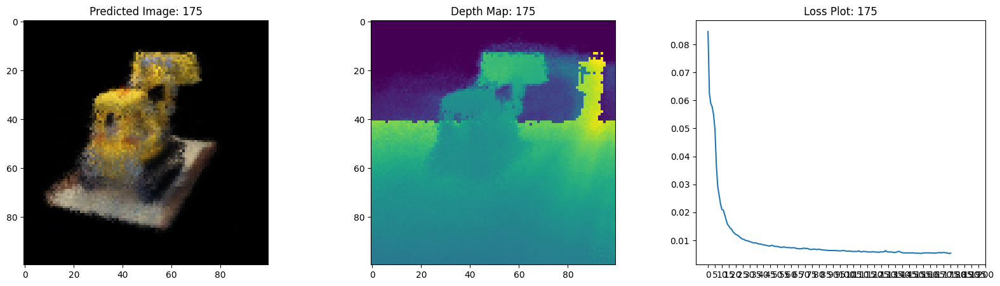

16/16 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - loss: 0.0054 - psnr: 22.7820 - val_loss: 0.0063 - val_psnr: 22.1421
Epoch 177/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


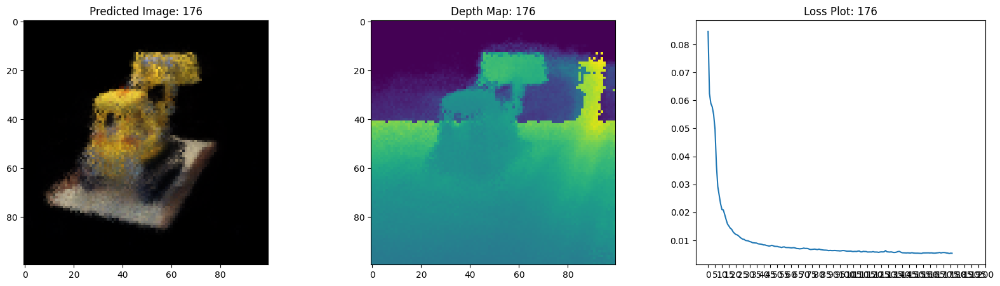

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0054 - psnr: 22.7957 - val_loss: 0.0066 - val_psnr: 21.9166
Epoch 178/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 793ms/step


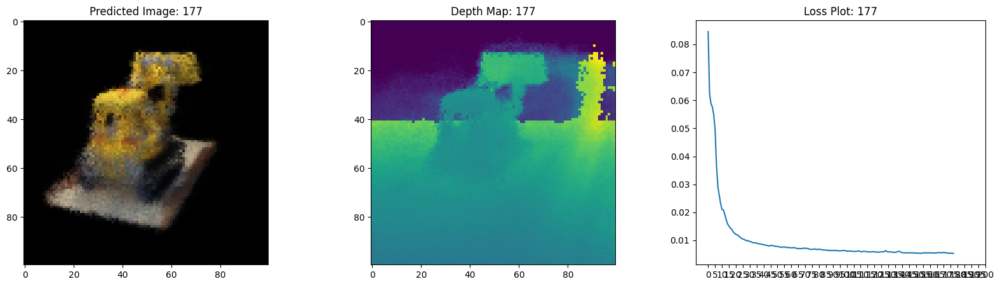

16/16 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - loss: 0.0053 - psnr: 22.9273 - val_loss: 0.0063 - val_psnr: 22.2056
Epoch 179/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


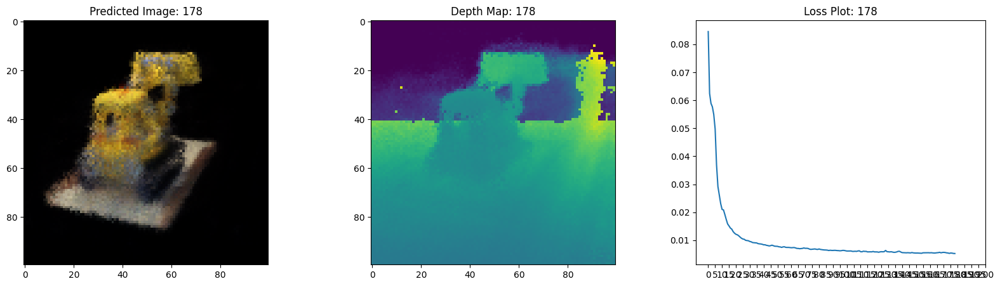

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - loss: 0.0053 - psnr: 22.8694 - val_loss: 0.0062 - val_psnr: 22.2097
Epoch 180/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step


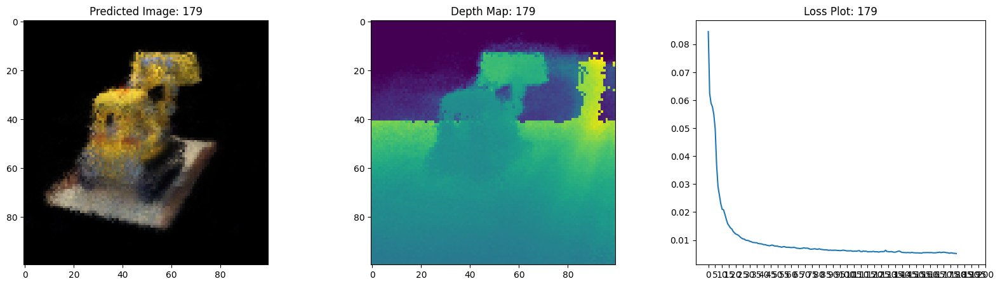

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0052 - psnr: 22.9661 - val_loss: 0.0062 - val_psnr: 22.2403
Epoch 181/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


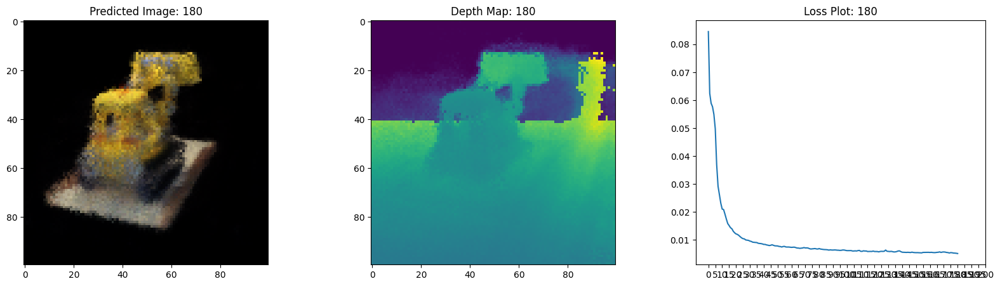

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0051 - psnr: 23.0235 - val_loss: 0.0062 - val_psnr: 22.2340
Epoch 182/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 815ms/step


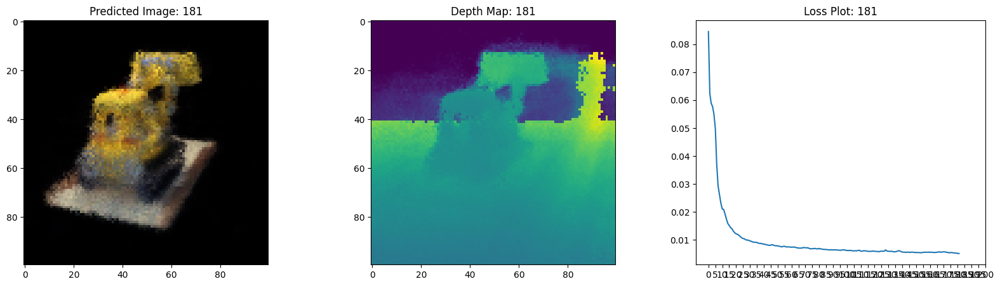

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0051 - psnr: 23.0312 - val_loss: 0.0063 - val_psnr: 22.1500
Epoch 183/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step


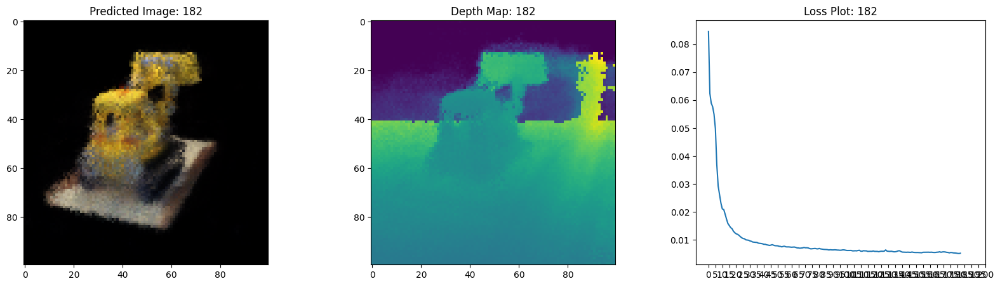

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0052 - psnr: 22.9875 - val_loss: 0.0064 - val_psnr: 22.0299
Epoch 184/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


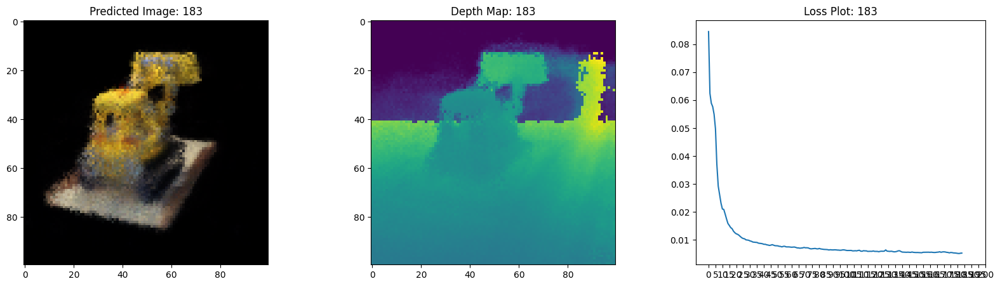

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0052 - psnr: 22.9978 - val_loss: 0.0065 - val_psnr: 22.0088
Epoch 185/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 726ms/step


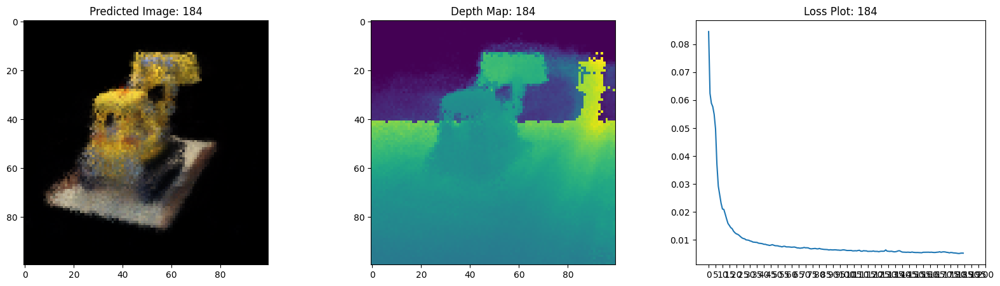

16/16 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - loss: 0.0053 - psnr: 22.9319 - val_loss: 0.0064 - val_psnr: 22.0412
Epoch 186/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


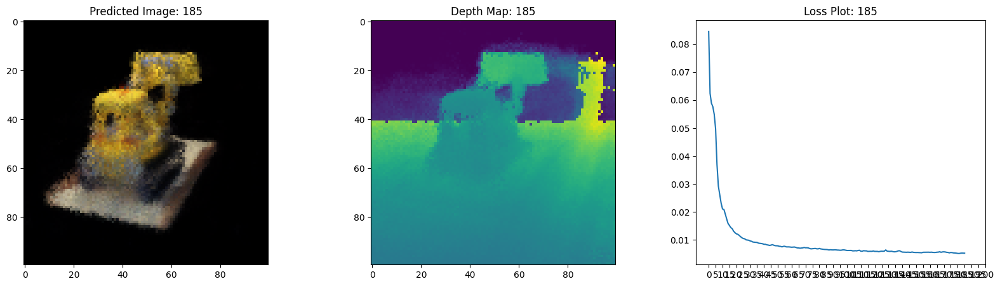

16/16 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - loss: 0.0052 - psnr: 22.9571 - val_loss: 0.0063 - val_psnr: 22.0800
Epoch 187/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


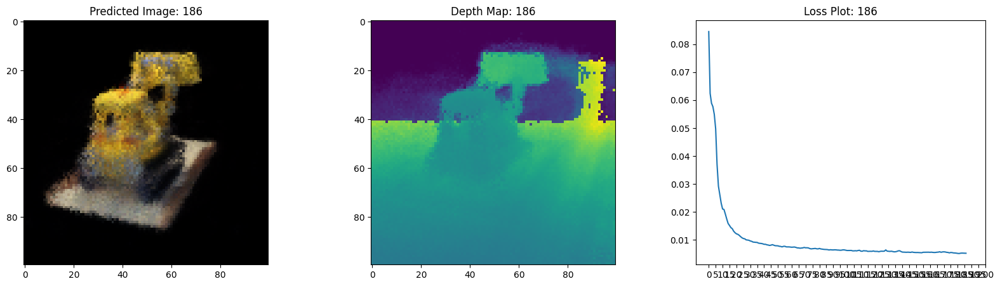

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0052 - psnr: 22.9868 - val_loss: 0.0062 - val_psnr: 22.2161
Epoch 188/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


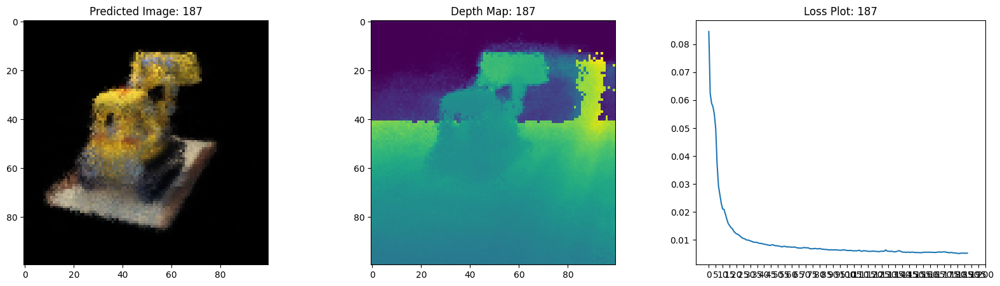

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0052 - psnr: 22.9648 - val_loss: 0.0061 - val_psnr: 22.2907
Epoch 189/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


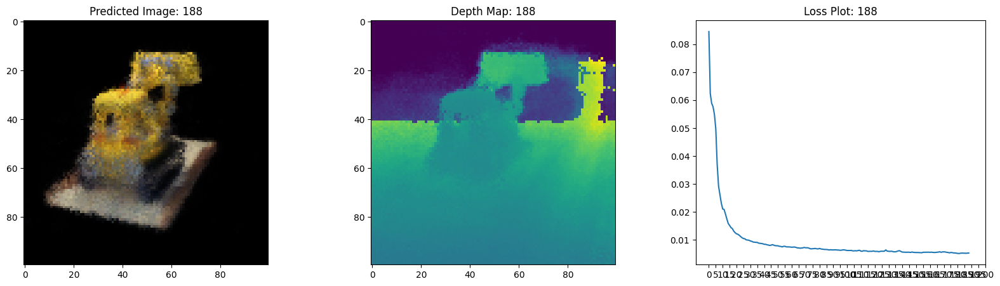

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0053 - psnr: 22.9142 - val_loss: 0.0063 - val_psnr: 22.1807
Epoch 190/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 753ms/step


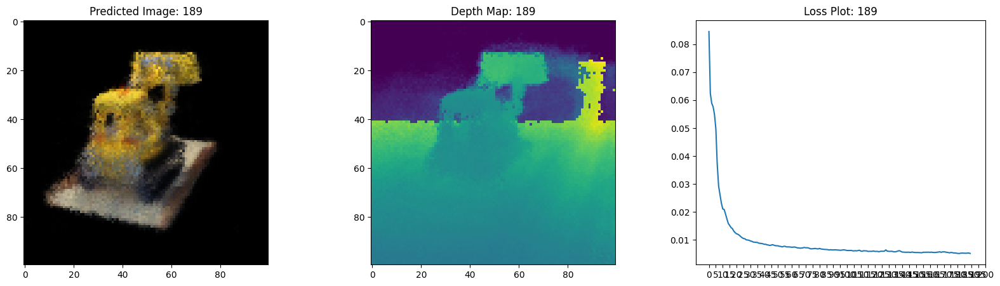

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0051 - psnr: 23.0462 - val_loss: 0.0062 - val_psnr: 22.2301
Epoch 191/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


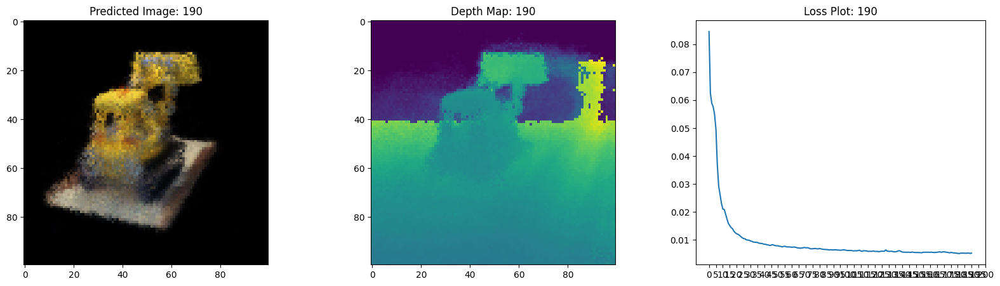

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0053 - psnr: 22.9319 - val_loss: 0.0064 - val_psnr: 22.1344
Epoch 192/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


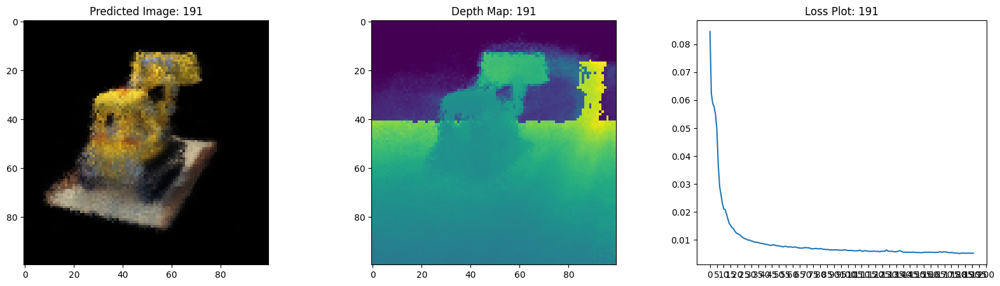

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0052 - psnr: 22.9735 - val_loss: 0.0063 - val_psnr: 22.1983
Epoch 193/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step


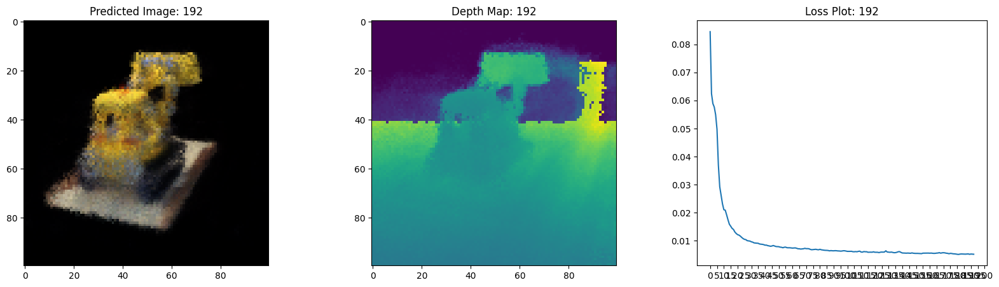

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0051 - psnr: 23.0801 - val_loss: 0.0063 - val_psnr: 22.1069
Epoch 194/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


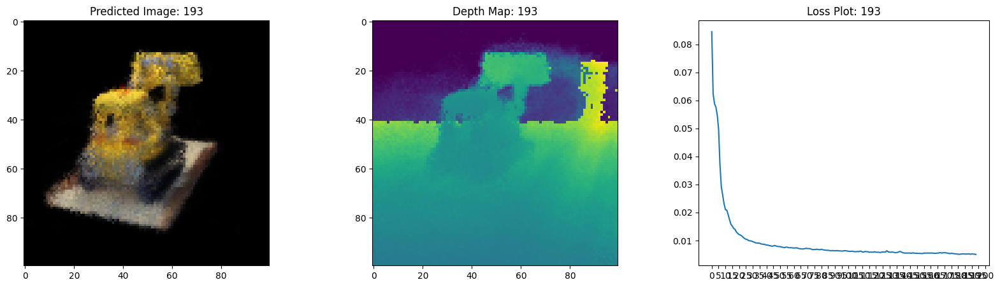

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0051 - psnr: 23.0473 - val_loss: 0.0063 - val_psnr: 22.1108
Epoch 195/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 729ms/step


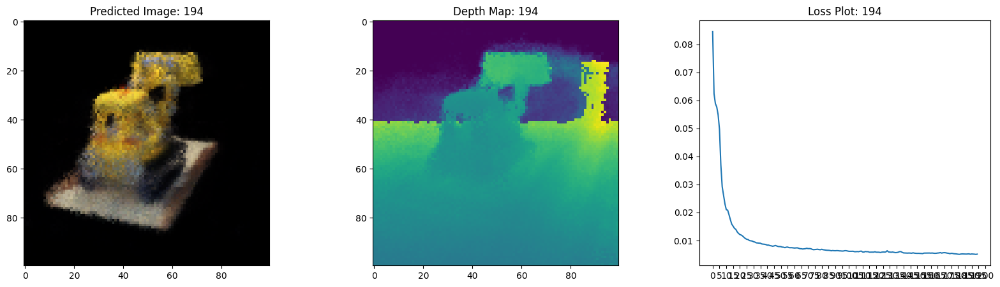

16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - loss: 0.0051 - psnr: 23.0684 - val_loss: 0.0062 - val_psnr: 22.2311
Epoch 196/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


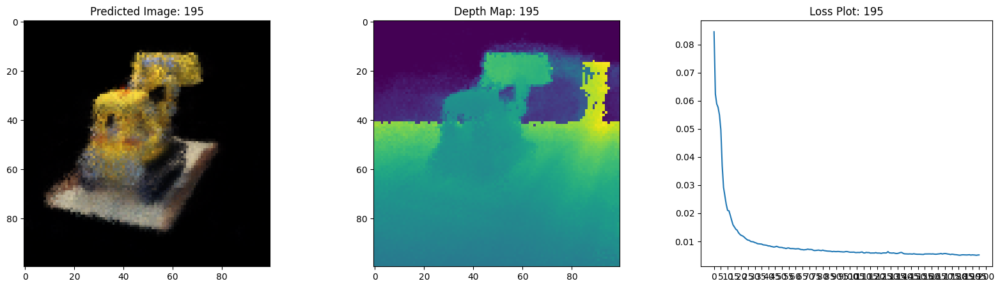

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - loss: 0.0051 - psnr: 23.0494 - val_loss: 0.0062 - val_psnr: 22.2119
Epoch 197/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


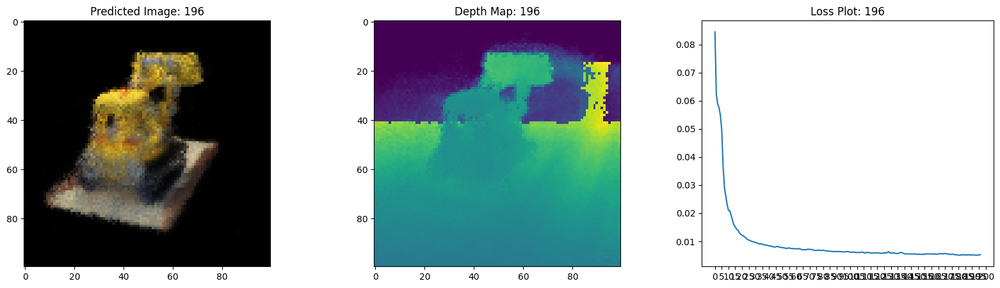

16/16 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - loss: 0.0052 - psnr: 22.9939 - val_loss: 0.0064 - val_psnr: 22.0494
Epoch 198/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


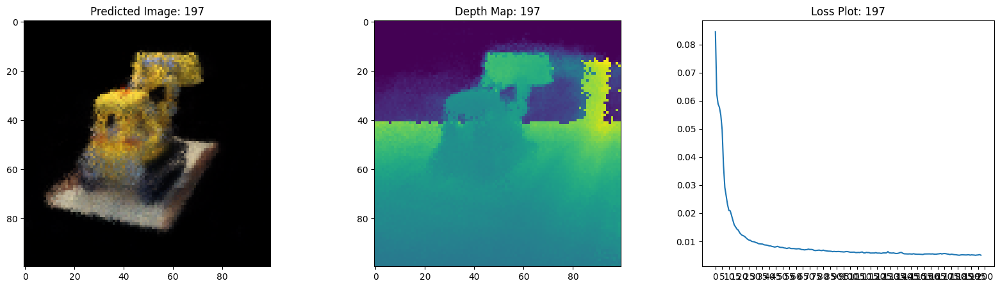

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0051 - psnr: 23.0035 - val_loss: 0.0062 - val_psnr: 22.2613
Epoch 199/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 702ms/step


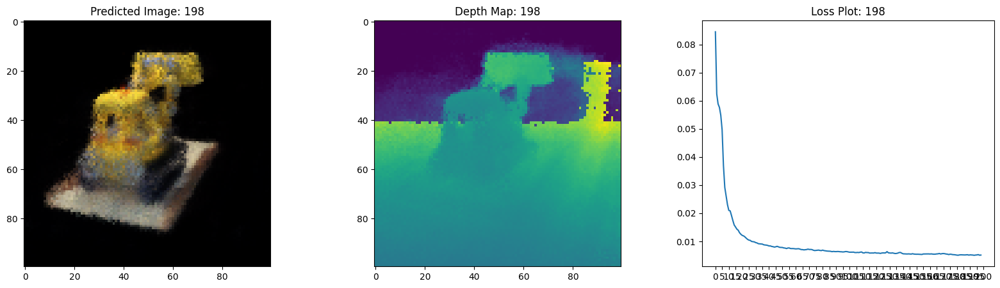

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - loss: 0.0051 - psnr: 23.0754 - val_loss: 0.0062 - val_psnr: 22.2489
Epoch 200/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 831ms/step


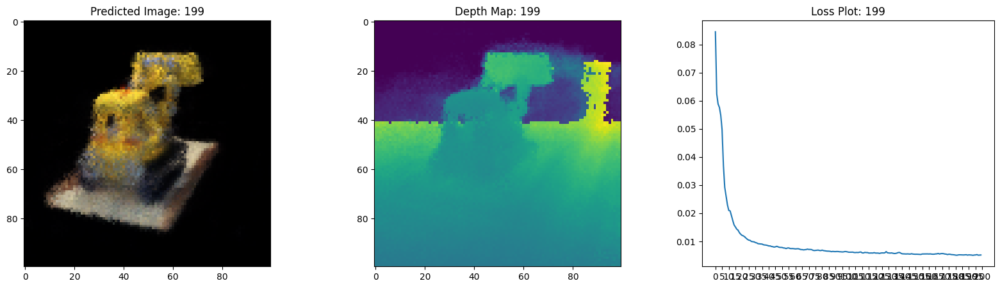

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - loss: 0.0051 - psnr: 23.0454 - val_loss: 0.0062 - val_psnr: 22.1811


100%|██████████| 200/200 [00:05<00:00, 37.64it/s]


In [13]:

class NeRF(keras.Model):
    def __init__(self, nerf_model):
        super().__init__()
        self.nerf_model = nerf_model

    def compile(self, optimizer, loss_fn):
        super().compile()
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.loss_tracker = keras.metrics.Mean(name="loss")
        self.psnr_metric = keras.metrics.Mean(name="psnr")

    def train_step(self, inputs):
        # Get the images and the rays.
        (images, rays) = inputs
        (rays_flat, t_vals) = rays

        with tf.GradientTape() as tape:
            # Get the predictions from the model.
            rgb, _ = render_rgb_depth(
                model=self.nerf_model, rays_flat=rays_flat, t_vals=t_vals, rand=True
            )
            loss = self.loss_fn(images, rgb)

        # Get the trainable variables.
        trainable_variables = self.nerf_model.trainable_variables

        # Get the gradeints of the trainiable variables with respect to the loss.
        gradients = tape.gradient(loss, trainable_variables)

        # Apply the grads and optimize the model.
        self.optimizer.apply_gradients(zip(gradients, trainable_variables))

        # Get the PSNR of the reconstructed images and the source images.
        psnr = tf.image.psnr(images, rgb, max_val=1.0)

        # Compute our own metrics
        self.loss_tracker.update_state(loss)
        self.psnr_metric.update_state(psnr)
        return {"loss": self.loss_tracker.result(), "psnr": self.psnr_metric.result()}

    def test_step(self, inputs):
        # Get the images and the rays.
        (images, rays) = inputs
        (rays_flat, t_vals) = rays

        # Get the predictions from the model.
        rgb, _ = render_rgb_depth(
            model=self.nerf_model, rays_flat=rays_flat, t_vals=t_vals, rand=True
        )
        loss = self.loss_fn(images, rgb)

        # Get the PSNR of the reconstructed images and the source images.
        psnr = tf.image.psnr(images, rgb, max_val=1.0)

        # Compute our own metrics
        self.loss_tracker.update_state(loss)
        self.psnr_metric.update_state(psnr)
        return {"loss": self.loss_tracker.result(), "psnr": self.psnr_metric.result()}

    @property
    def metrics(self):
        return [self.loss_tracker, self.psnr_metric]


test_imgs, test_rays = next(iter(train_ds))
test_rays_flat, test_t_vals = test_rays

loss_list = []


class TrainMonitor(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        loss = logs["loss"]
        loss_list.append(loss)
        test_recons_images, depth_maps = render_rgb_depth(
            model=self.model.nerf_model,
            rays_flat=test_rays_flat,
            t_vals=test_t_vals,
            rand=True,
            train=False,
        )

        # Plot the rgb, depth and the loss plot.
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
        ax[0].imshow(keras.utils.array_to_img(test_recons_images[0]))
        ax[0].set_title(f"Predicted Image: {epoch:03d}")

        ax[1].imshow(keras.utils.array_to_img(depth_maps[0, ..., None]))
        ax[1].set_title(f"Depth Map: {epoch:03d}")

        ax[2].plot(loss_list)
        ax[2].set_xticks(np.arange(0, EPOCHS + 1, 5.0))
        ax[2].set_title(f"Loss Plot: {epoch:03d}")

        fig.savefig(f"images/{epoch:03d}.png")
        plt.show()
        plt.close()


num_pos = H * W * NUM_SAMPLES
nerf_model = get_nerf_model(num_layers=8, num_pos=num_pos)

model = NeRF(nerf_model)
model.compile(
    optimizer=keras.optimizers.Adam(), loss_fn=keras.losses.MeanSquaredError()
)

# Create a directory to save the images during training.
if not os.path.exists("images"):
    os.makedirs("images")

model.fit(
    train_ds,
    validation_data=val_ds,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=[TrainMonitor()],
)


def create_gif(path_to_images, name_gif):
    filenames = glob.glob(path_to_images)
    filenames = sorted(filenames)
    images = []
    for filename in tqdm(filenames):
        images.append(imageio.imread(filename))
    kargs = {"duration": 0.25}
    imageio.mimsave(name_gif, images, "GIF", **kargs)


create_gif("images/*.png", "training.gif")

## Visualize the training step

Here we see the training step. With the decreasing loss, the rendered
image and the depth maps are getting better. In your local system, you
will see the `training.gif` file generated.

## Inference

In this section, we ask the model to build novel views of the scene.
The model was given `106` views of the scene in the training step. The
collections of training images cannot contain each and every angle of
the scene. A trained model can represent the entire 3-D scene with a
sparse set of training images.

Here we provide different poses to the model and ask for it to give us
the 2-D image corresponding to that camera view. If we infer the model
for all the 360-degree views, it should provide an overview of the
entire scenery from all around.

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 808ms/step


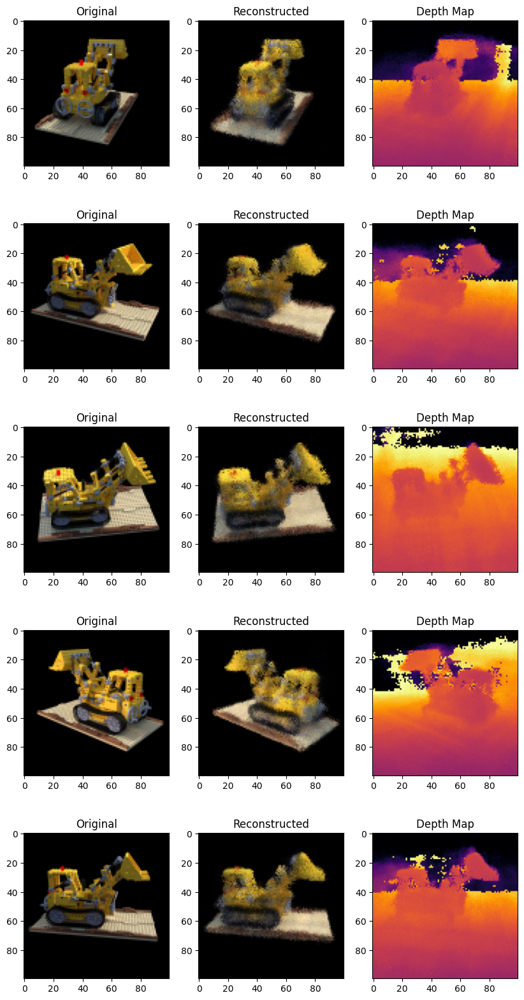

In [14]:
# Get the trained NeRF model and infer.
nerf_model = model.nerf_model
test_recons_images, depth_maps = render_rgb_depth(
    model=nerf_model,
    rays_flat=test_rays_flat,
    t_vals=test_t_vals,
    rand=True,
    train=False,
)

# Create subplots.
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(10, 20))

for ax, ori_img, recons_img, depth_map in zip(
    axes, test_imgs, test_recons_images, depth_maps
):
    ax[0].imshow(keras.utils.array_to_img(ori_img))
    ax[0].set_title("Original")

    ax[1].imshow(keras.utils.array_to_img(recons_img))
    ax[1].set_title("Reconstructed")

    ax[2].imshow(keras.utils.array_to_img(depth_map[..., None]), cmap="inferno")
    ax[2].set_title("Depth Map")

## Render 3D Scene

Here we will synthesize novel 3D views and stitch all of them together
to render a video encompassing the 360-degree view.

In [15]:

def get_translation_t(t):
    """Get the translation matrix for movement in t."""
    matrix = [
        [1, 0, 0, 0],
        [0, 1, 0, 0],
        [0, 0, 1, t],
        [0, 0, 0, 1],
    ]
    return tf.convert_to_tensor(matrix, dtype=tf.float32)


def get_rotation_phi(phi):
    """Get the rotation matrix for movement in phi."""
    matrix = [
        [1, 0, 0, 0],
        [0, tf.cos(phi), -tf.sin(phi), 0],
        [0, tf.sin(phi), tf.cos(phi), 0],
        [0, 0, 0, 1],
    ]
    return tf.convert_to_tensor(matrix, dtype=tf.float32)


def get_rotation_theta(theta):
    """Get the rotation matrix for movement in theta."""
    matrix = [
        [tf.cos(theta), 0, -tf.sin(theta), 0],
        [0, 1, 0, 0],
        [tf.sin(theta), 0, tf.cos(theta), 0],
        [0, 0, 0, 1],
    ]
    return tf.convert_to_tensor(matrix, dtype=tf.float32)


def pose_spherical(theta, phi, t):
    """
    Get the camera to world matrix for the corresponding theta, phi
    and t.
    """
    c2w = get_translation_t(t)
    c2w = get_rotation_phi(phi / 180.0 * np.pi) @ c2w
    c2w = get_rotation_theta(theta / 180.0 * np.pi) @ c2w
    c2w = np.array([[-1, 0, 0, 0], [0, 0, 1, 0], [0, 1, 0, 0], [0, 0, 0, 1]]) @ c2w
    return c2w


rgb_frames = []
batch_flat = []
batch_t = []

# Iterate over different theta value and generate scenes.
for index, theta in tqdm(enumerate(np.linspace(0.0, 360.0, 120, endpoint=False))):
    # Get the camera to world matrix.
    c2w = pose_spherical(theta, -30.0, 4.0)

    #
    ray_oris, ray_dirs = get_rays(H, W, focal, c2w)
    rays_flat, t_vals = render_flat_rays(
        ray_oris, ray_dirs, near=2.0, far=6.0, num_samples=NUM_SAMPLES, rand=False
    )

    if index % BATCH_SIZE == 0 and index > 0:
        batched_flat = tf.stack(batch_flat, axis=0)
        batch_flat = [rays_flat]

        batched_t = tf.stack(batch_t, axis=0)
        batch_t = [t_vals]

        rgb, _ = render_rgb_depth(
            nerf_model, batched_flat, batched_t, rand=False, train=False
        )

        temp_rgb = [np.clip(255 * img, 0.0, 255.0).astype(np.uint8) for img in rgb]

        rgb_frames = rgb_frames + temp_rgb
    else:
        batch_flat.append(rays_flat)
        batch_t.append(t_vals)

rgb_video = "rgb_video.mp4"
imageio.mimwrite(rgb_video, rgb_frames, fps=30, quality=7, macro_block_size=None)

5it [00:01,  5.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 736ms/step


8it [00:02,  3.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step


11it [00:03,  2.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step


20it [00:05,  4.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


22it [00:07,  2.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 797ms/step


29it [00:09,  3.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 702ms/step


31it [00:11,  2.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 690ms/step


40it [00:12,  3.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


42it [00:13,  3.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 690ms/step


46it [00:15,  3.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


51it [00:16,  3.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step


56it [00:18,  3.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 720ms/step


64it [00:20,  3.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


66it [00:21,  2.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


71it [00:23,  3.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


76it [00:25,  2.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


81it [00:26,  3.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step


86it [00:28,  2.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


91it [00:30,  2.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 754ms/step


99it [00:32,  3.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


101it [00:34,  2.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


106it [00:36,  2.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step


111it [00:37,  2.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


120it [00:39,  3.04it/s]
